In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import warnings

warnings.filterwarnings('ignore')

In [ ]:
!pip install ydata_profiling

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.6/390.6 kB 8.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 22.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 32.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 70.2 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=a76b9bf7e9f00199414e50a0f97975031964ca45e3dbb474ca5c3f44499a9dd6
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
!pip install pyod

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 165.8/165.8 kB 4.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyod: filename=pyod-2.0.2-py3-none-any.whl size=198469 sha256=f78a256a3ea906072502297b3b16d49e051f055d8e19defc520b7e3d1c1ecb7a
  Stored in directory: /root/.cache/pip/wheels/77/c2/20/34d1f15b41b701ba69f42a32304825810d680754d509f91391
Successfully built pyod


In [ ]:
import os
import pandas as pd
import numpy as np

import inspect

import ydata_profiling

import matplotlib.pyplot as plt
import seaborn as sns

import scipy.stats as stats
import scipy

from pyod.models.mad import MAD

from scipy.stats import zscore

from scipy.stats import shapiro


In [ ]:
%matplotlib inline

In [ ]:
sns.set(font_scale=2)


In [ ]:
# Univariate Analysis

In [ ]:
data = pd.read_csv('weatherAUS.csv')

#No need to separate, dataset is reading correctly

In [ ]:
data.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

In [ ]:
data.head().T

# Full displaying features

,0,1,2,3,4
Date,2008-12-01,2008-12-02,2008-12-03,2008-12-04,2008-12-05
Location,Albury,Albury,Albury,Albury,Albury
MinTemp,13.4,7.4,12.9,9.2,17.5
MaxTemp,22.9,25.1,25.7,28.0,32.3
Rainfall,0.6,0.0,0.0,0.0,1.0
Evaporation,NaN,NaN,NaN,NaN,NaN
Sunshine,NaN,NaN,NaN,NaN,NaN
WindGustDir,W,WNW,WSW,NE,W
WindGustSpeed,44.0,44.0,46.0,24.0,41.0
WindDir9am,W,NNW,W,SE,ENE


In [ ]:
default_columns_count = pd.options.display.max_columns

In [ ]:
default_columns_count

20

In [ ]:
data.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,143975.000000,144199.000000,142199.000000,82670.000000,75625.000000,135197.000000,143693.000000,142398.000000,142806.000000,140953.000000,130395.00000,130432.000000,89572.000000,86102.000000,143693.000000,141851.00000
mean,12.194034,23.221348,2.360918,5.468232,7.611178,40.035230,14.043426,18.662657,68.880831,51.539116,1017.64994,1015.255889,4.447461,4.509930,16.990631,21.68339
std,6.398495,7.119049,8.478060,4.193704,3.785483,13.607062,8.915375,8.809800,19.029164,20.795902,7.10653,7.037414,2.887159,2.720357,6.488753,6.93665
min,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.50000,977.100000,0.000000,0.000000,-7.200000,-5.40000
25%,7.600000,17.900000,0.000000,2.600000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.90000,1010.400000,1.000000,2.000000,12.300000,16.60000
50%,12.000000,22.600000,0.000000,4.800000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.60000,1015.200000,5.000000,5.000000,16.700000,21.10000
75%,16.900000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.40000,1020.000000,7.000000,7.000000,21.600000,26.40000
max,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.00000,1039.600000,9.000000,9.000000,40.200000,46.70000


In [ ]:
data['MinTemp'].describe()

,MinTemp
count,143975.000000
mean,12.194034
std,6.398495
min,-8.500000
25%,7.600000
50%,12.000000
75%,16.900000
max,33.900000


In [ ]:
profile = ydata_profiling.ProfileReport(data)
profile

# Profiling to get full dataset
# Most of features are continous

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:

def univariate_analysis(feature, target='RainTomorrow', data=None, bins=20):
    print(f"Analyzing Feature: {feature}\n")


    plt.figure(figsize=(25, 5))
    sns.distplot(data[feature], bins=bins, kde=False)
    plt.ylabel('count')
    plt.title(f"Histogram of {feature}")
    plt.show()

    plt.figure(figsize=(25, 5))
    plt.hist(
        [data[data[target] == 'No'][feature], data[data[target] == 'Yes'][feature]],
        label=['No', 'Yes'],
        density=True,
        bins=bins,
        alpha=0.7
    )
    plt.legend()
    plt.xlabel(feature)
    plt.ylabel('density')
    plt.title(f"Histogram of {feature} by {target}")
    plt.show()

    data[feature] = data[feature].fillna(data[feature].mean())

    ks_result = stats.ks_2samp(
        data[data[target] == 'No'][feature],
        data[data[target] == 'Yes'][feature]
    )
    print(f"Kolmogorov-Smirnov Test: {ks_result}")
    kruskal_result = stats.kruskal(
        data[data[target] == 'No'][feature],
        data[data[target] == 'Yes'][feature]
    )
    print(f"Kruskal-Wallis Test: {kruskal_result}")

    median_no = data[data[target] == 'No'][feature].median()
    median_yes = data[data[target] == 'Yes'][feature].median()
    print(f"Median (No): {median_no}, Median (Yes): {median_yes}\n")

    plt.figure(figsize=(25, 5))
    sns.barplot(x=target, y=feature, data=data)
    plt.title(f"Bar Plot of {feature} by {target}")
    plt.show()

    ranksum_result = stats.ranksums(
        data[data[target] == 'No'][feature],
        data[data[target] == 'Yes'][feature]
    )
    print(f"Rank-Sum Test: {ranksum_result}")

    mean_no = data[data[target] == 'No'][feature].mean()
    mean_yes = data[data[target] == 'Yes'][feature].mean()
    print(f"Mean (No): {mean_no}, Mean (Yes): {mean_yes}\n")

    plt.figure(figsize=(5, 5))
    sns.boxplot(x=target, y=feature, data=data)
    plt.title(f"Boxplot of {feature} by {target}")
    plt.show()

    sns.set(font_scale=1)
    plt.figure(figsize=(25, 5))
    sns.countplot(x=feature, hue=target, data=data)
    plt.title(f"Countplot of {feature} by {target}")
    plt.show()
    sns.set(font_scale=2)

    print("\n" + "="*50 + "\n")

    sns.set(font_scale=1)
    plt.figure(figsize=(25, 5))
    sns.countplot(x=feature, data=data[data.RainTomorrow == 'No'])
    plt.xlabel('age (RainTomorrow = "no")')
    plt.show()
    sns.set(font_scale=2)

    sns.set(font_scale=1)
    plt.figure(figsize=(25, 5))
    sns.countplot(x=feature, data=data[data.RainTomorrow == 'Yes'])
    plt.xlabel('age (RainTomorrow = "Yes")')
    plt.show()
    sns.set(font_scale=2)


In [ ]:
# TARGET ANALYSIS

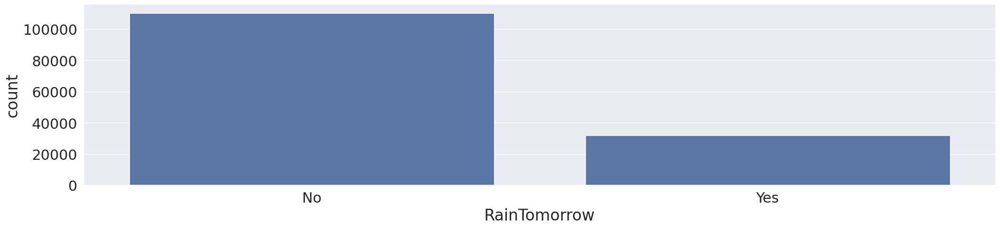

In [ ]:
plt.figure(figsize=(25, 5))
sns.countplot(x='RainTomorrow', data=data)
plt.show()

In [ ]:
#Classes are very unbalanced.

#Of course, this will NOT positively affect the quality of classification.

In [ ]:
#UNIVARIATE ANALYSIS

In [ ]:
continous_features = data.select_dtypes(include=['int64', 'float64']).columns
continous_features

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm'],
      dtype='object')

In [ ]:
def normal_dist_test(data, continous_features,index):

  data[continous_features[0]] = data[continous_features[0]].fillna(data[continous_features[0]].mean())

  stat, p_value = shapiro(data[continous_features[0]])

  print(f"Shapiro-Wilk Test Statistic: {stat}")
  print(f"Shapiro-Wilk Test p-value: {p_value}")

  alpha = 0.05
  if p_value > alpha:
    print("The distribution is likely normal (fail to reject H0).")
  else:
    print("The distribution is likely not normal (reject H0).")



Analyzing Feature: MinTemp



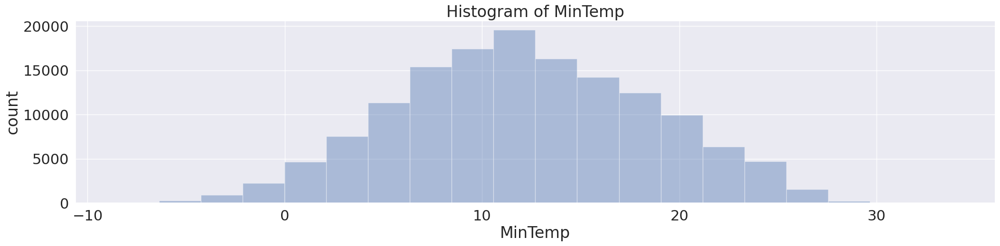

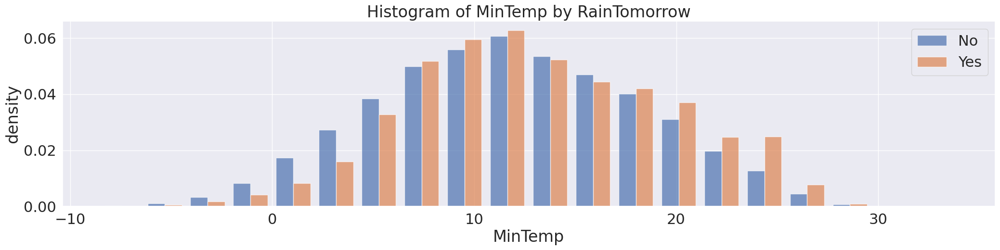

Kolmogorov-Smirnov Test: KstestResult(statistic=0.06968354710912728, pvalue=7.264208494477525e-105, statistic_location=6.9, statistic_sign=1)
Kruskal-Wallis Test: KruskalResult(statistic=824.4812330966689, pvalue=2.567435428310539e-181)
Median (No): 11.8, Median (Yes): 12.7



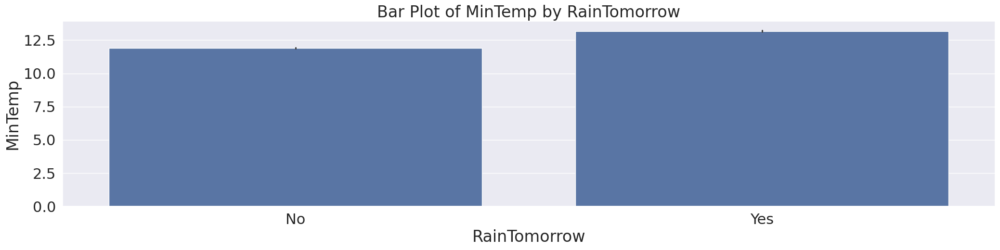

Rank-Sum Test: RanksumsResult(statistic=-28.713487057829678, pvalue=2.5892409721237087e-181)
Mean (No): 11.898916239566406, Mean (Yes): 13.181439784693337



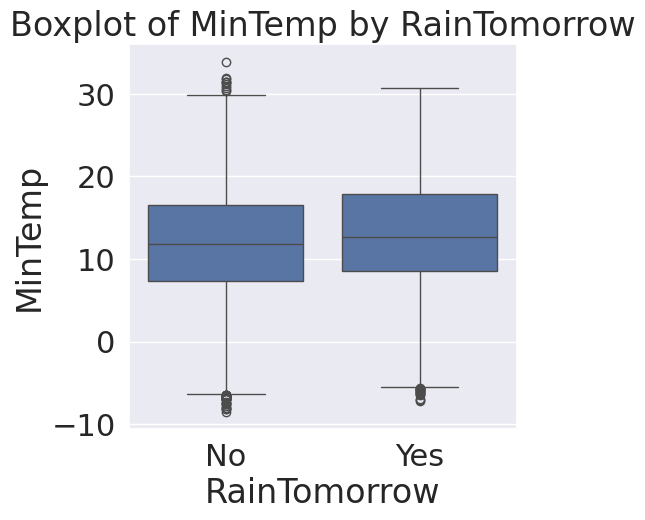

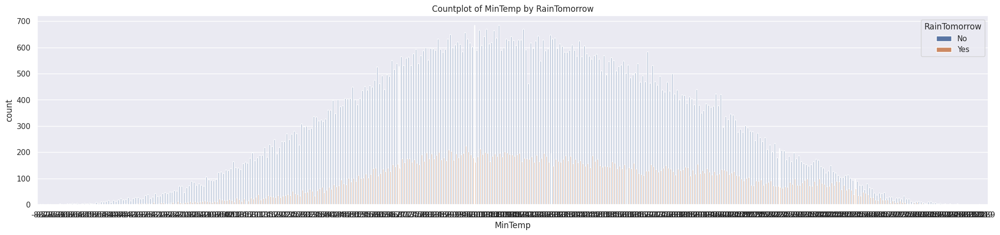

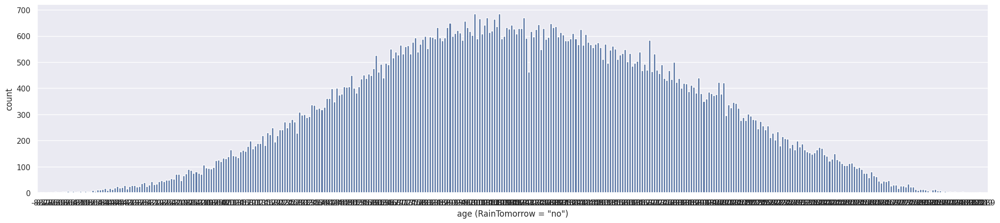

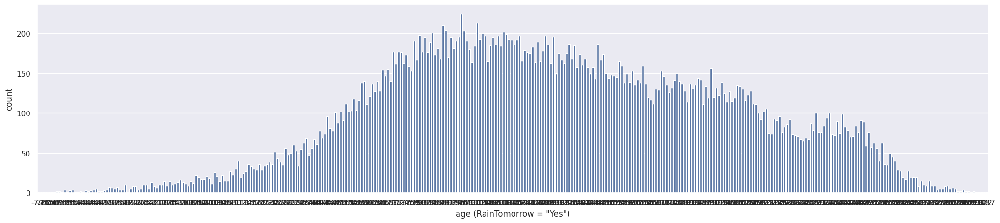

In [ ]:
univariate_analysis(continous_features[0], data=data)

In [ ]:
# For the historgram:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically
# significant differences in middle age in different groups is no longer available.

# For Kolmogorov-Smirmov test:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

# For kruskal test:

# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different

#For medians and Bar Plot:
#It is curious that here, according to the schedule, it seems like the average value of MinTemp is higher in the second group, and not in the first.
#Also, the scatter of MinTemp in the second group is higher.

#Fro ranksums and medians:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

#For Box-plot:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the second group has a flatter right tail (which, by the way, can explain why the average value in this group is higher).


In [ ]:
continous_features[1]

'MaxTemp'

In [ ]:
normal_dist_test(data,continous_features=continous_features,index=1)


Shapiro-Wilk Test Statistic: 0.9960108372665865
Shapiro-Wilk Test p-value: 3.0468355185849023e-46
The distribution is likely not normal (reject H0).


/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 145460.
  res = hypotest_fun_out(*samples, **kwds)


Analyzing Feature: MaxTemp



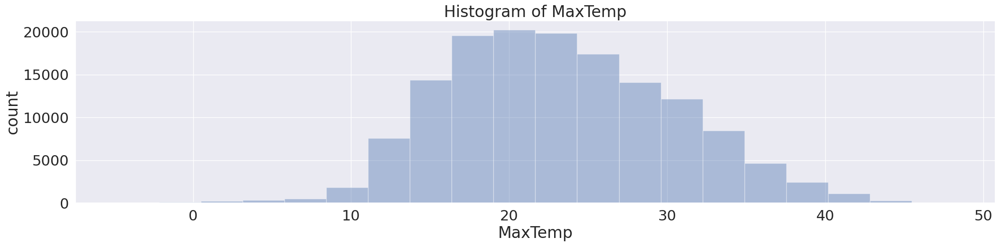

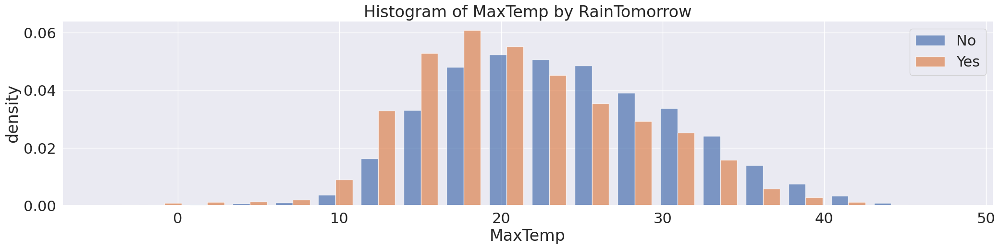

Kolmogorov-Smirnov Test: KstestResult(statistic=0.16230464111366966, pvalue=0.0, statistic_location=20.4, statistic_sign=-1)
Kruskal-Wallis Test: KruskalResult(statistic=3576.747348755455, pvalue=0.0)
Median (No): 23.3, Median (Yes): 20.2



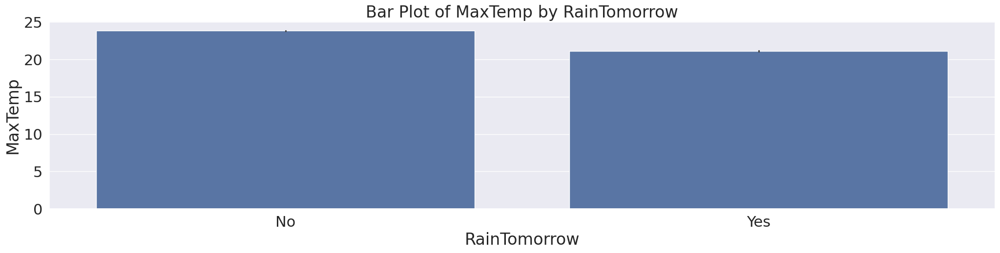

Rank-Sum Test: RanksumsResult(statistic=59.80538898218765, pvalue=0.0)
Mean (No): 23.834758330519573, Mean (Yes): 21.122727174927395



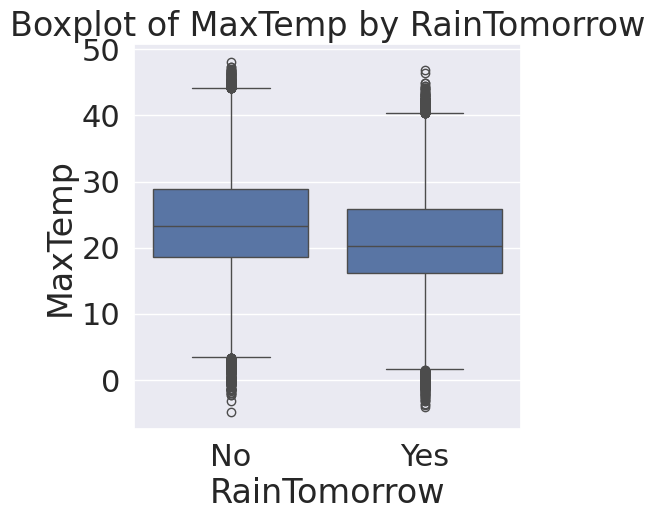

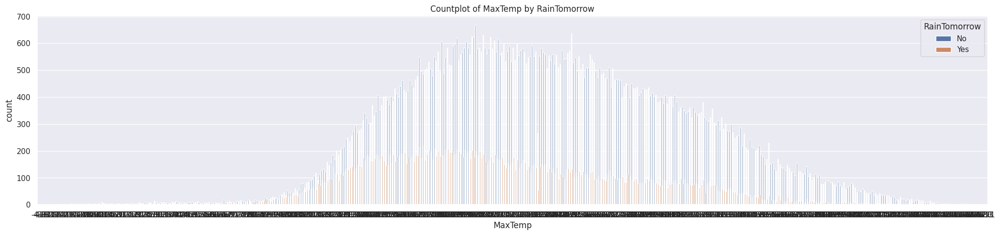

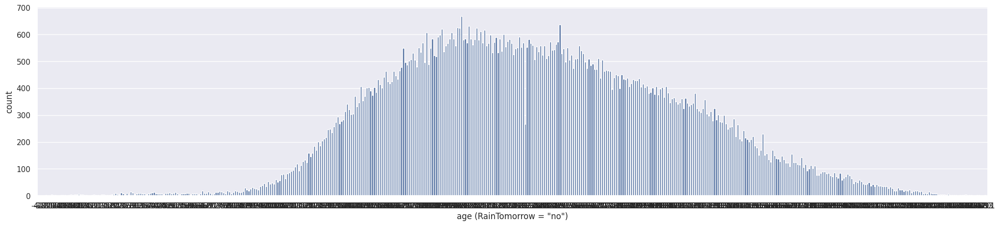

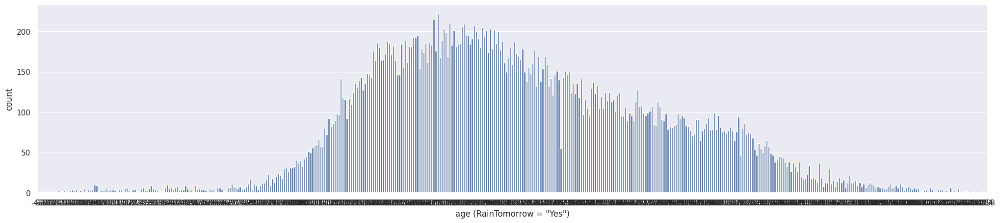

In [ ]:
univariate_analysis(continous_features[1], data=data)

In [ ]:
# For the historgram:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically
# significant differences in middle age in different groups is no longer available.

# For Kolmogorov-Smirmov test:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

# For kruskal test:

# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different

#For medians and Bar Plot:
#It is curious that here, according to the schedule, it seems like the average value of MaxTemp is higher in the first group, and not in the second.
#Also, the scatter of MaxTemp in the first group is higher.

#Fro ranksums and medians:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

#For Box-plot:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the first group has a flatter left tail (which, by the way, can explain why the average value in this group is higher).


In [ ]:
continous_features[2]

'Rainfall'

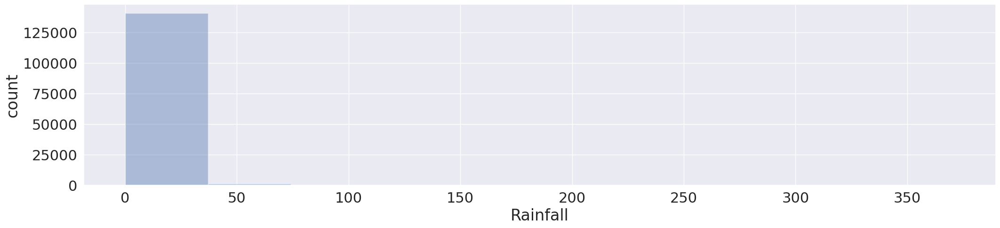

In [ ]:
plt.figure(figsize=(25, 5))
sns.distplot(data[continous_features[2]], bins=10, kde=False)
plt.ylabel('count')
plt.show()

In [ ]:
#There is no visual evidence of the normal distribution, so the option of using
#t- and z-tests to test statistically significant differences in middle age in different groups is no longer available.

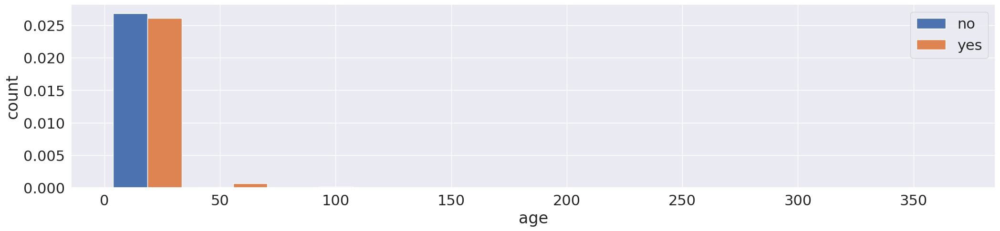

In [ ]:
plt.figure(figsize=(25, 5))
plt.hist(
    [
        data[data.RainTomorrow == 'No'][continous_features[2]],
        data[data.RainTomorrow == 'Yes'][continous_features[2]]
    ],
    label=['no', 'yes'],
    density=True
)
plt.legend()
plt.xlabel('age')
plt.ylabel('count')
plt.show()

In [ ]:
data[continous_features[2]] = data[continous_features[2]].fillna(data[continous_features[2]].mean())

scipy.stats.ks_2samp(
        data[data.RainTomorrow == 'No'][continous_features[2]],
        data[data.RainTomorrow == 'Yes'][continous_features[2]]
)

KstestResult(statistic=0.34850686170966605, pvalue=0.0, statistic_location=0.3, statistic_sign=1)

In [ ]:
# p-value is 0 so reject null hypotesis that these samples were taken from one distribution

In [ ]:
scipy.stats.kruskal(
    data[data.RainTomorrow == 'No'][continous_features[2]],
    data[data.RainTomorrow == 'Yes'][continous_features[2]]
)

KruskalResult(statistic=15936.253028508898, pvalue=0.0)

In [ ]:
# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different.

In [ ]:
data[data.RainTomorrow == 'No'][continous_features[2]].median()

0.0

In [ ]:
data[data.RainTomorrow == 'Yes'][continous_features[2]].median()

0.8

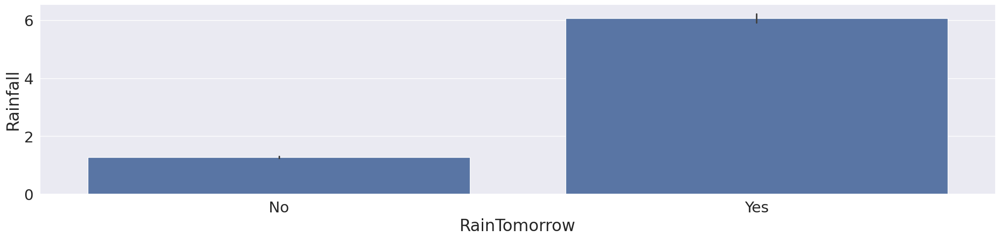

In [ ]:
plt.figure(figsize=(25, 5))
sns.barplot(x='RainTomorrow', y=continous_features[2], data=data)
plt.show()

In [ ]:
#Clearly average value is higher in the second group.

In [ ]:
data[data.RainTomorrow == 'No'][continous_features[2]].mean()

1.2775070728583269

In [ ]:
data[data.RainTomorrow == 'Yes'][continous_features[2]].mean()

6.061918645711443

In [ ]:
#Difference in mean is big

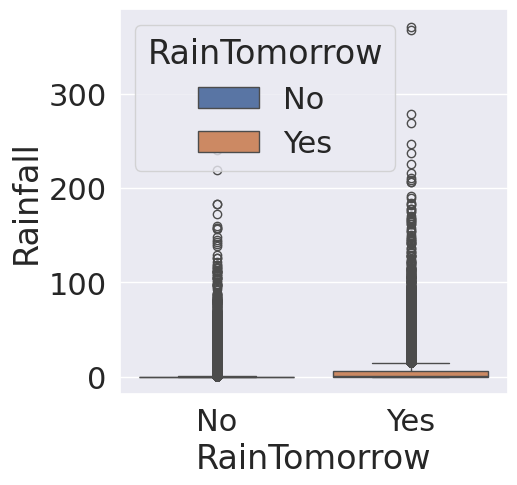

In [ ]:
plt.figure(figsize=(5, 5))
sns.boxplot(x='RainTomorrow', y=continous_features[2], hue='RainTomorrow', data=data)
plt.show()

In [ ]:
# It is clear that second group has flatter right tail(which, by the way, can explain why the average value in this group is higher).

In [ ]:
#Finally, let's look at the age in the groups as a discrete random variable:

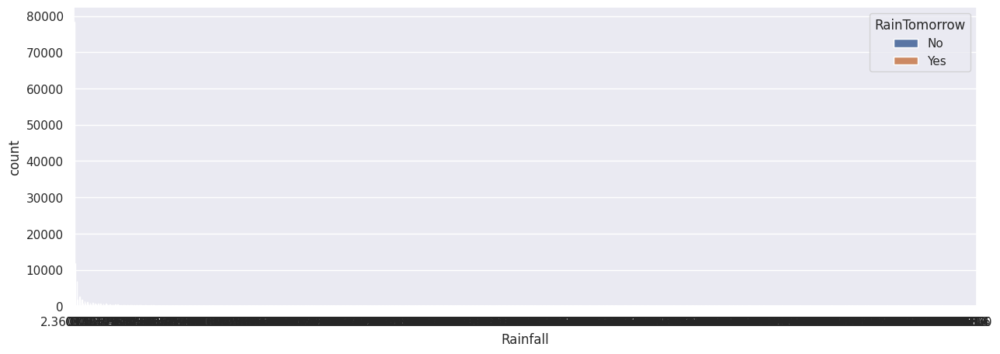

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(15, 5))
sns.countplot(x=continous_features[2], hue='RainTomorrow', data=data)
plt.show()
sns.set(font_scale=1)

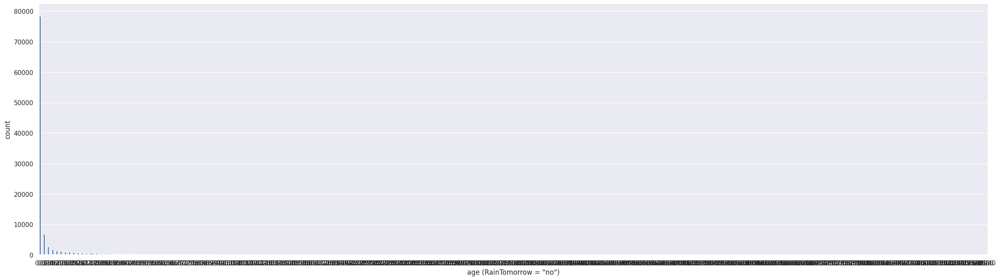

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(30, 8))
sns.countplot(x=continous_features[2], data=data[data.RainTomorrow == 'No'])
plt.xlabel('age (RainTomorrow = "no")')
plt.show()
sns.set(font_scale=2)

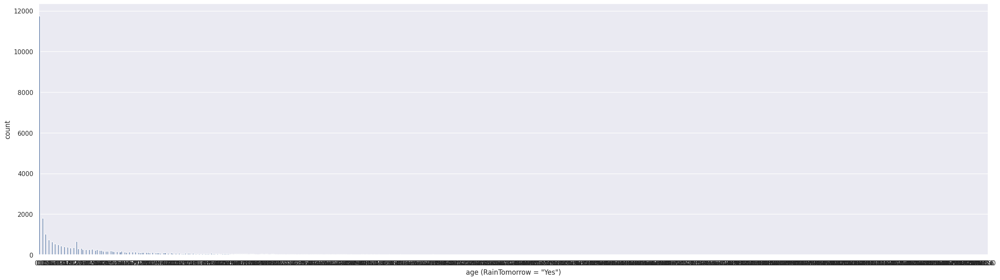

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(30, 8))
sns.countplot(x=continous_features[2], data=data[data.RainTomorrow == 'Yes'])
plt.xlabel('age (RainTomorrow = "Yes")')
plt.show()
sns.set(font_scale=2)

In [ ]:
continous_features[3]

'Evaporation'

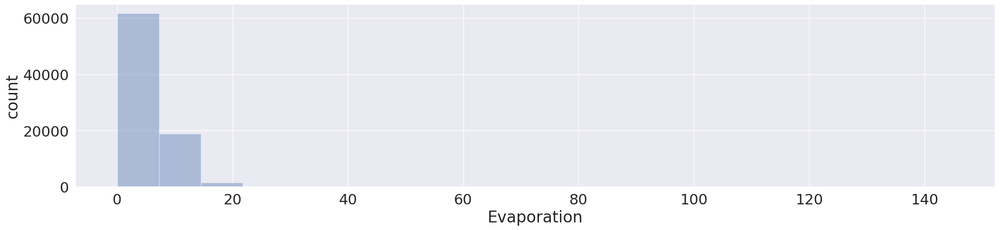

In [ ]:
plt.figure(figsize=(25, 5))
sns.distplot(data[continous_features[3]], bins=20, kde=False)
plt.ylabel('count')
plt.show()

In [ ]:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically significant differences in middle age in different groups is no longer available.

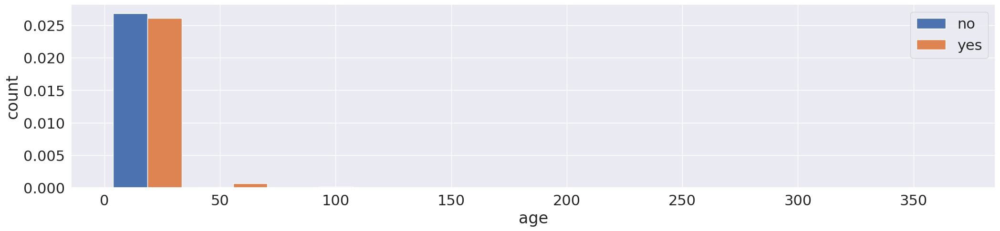

In [ ]:
plt.figure(figsize=(25, 5))
plt.hist(
    [
        data[data.RainTomorrow == 'No'][continous_features[2]],
        data[data.RainTomorrow == 'Yes'][continous_features[2]]
    ],
    label=['no', 'yes'],
    density=True
)
plt.legend()
plt.xlabel('age')
plt.ylabel('count')
plt.show()

In [ ]:
data[continous_features[3]] = data[continous_features[3]].fillna(data[continous_features[3]].mean())

scipy.stats.ks_2samp(
        data[data.RainTomorrow == 'No'][continous_features[3]],
        data[data.RainTomorrow == 'Yes'][continous_features[3]]
)

KstestResult(statistic=0.08458933754946474, pvalue=2.127158307027447e-154, statistic_location=5.5, statistic_sign=-1)

In [ ]:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

In [ ]:
scipy.stats.kruskal(
    data[data.RainTomorrow == 'No'][continous_features[3]],
    data[data.RainTomorrow == 'Yes'][continous_features[3]]
)

KruskalResult(statistic=1283.908108861228, pvalue=3.5500299115680094e-281)

In [ ]:
# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different.

In [ ]:
data[data.RainTomorrow == 'No'][continous_features[3]].median()

5.468231522922462

In [ ]:
data[data.RainTomorrow == 'Yes'][continous_features[3]].median()

5.468231522922462

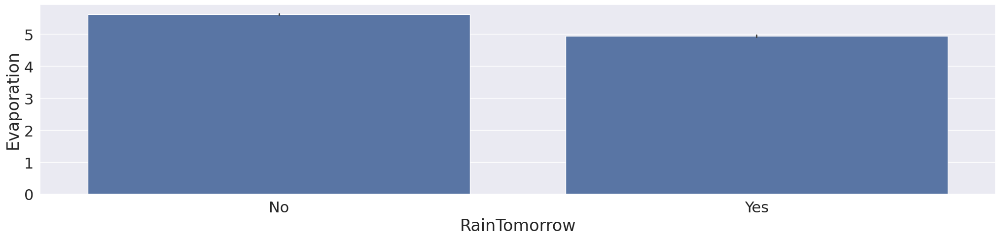

In [ ]:
plt.figure(figsize=(25, 5))
sns.barplot(x='RainTomorrow', y=continous_features[3], data=data)
plt.show()

In [ ]:
#It is curious that here, according to the schedule, it seems like the average value of age is higher in the first group, and not in the Second.

#Also, the scatter of Evaporation in the first group is higher.

In [ ]:
scipy.stats.ranksums(
    data[data.RainTomorrow == 'No'][continous_features[3]],
    data[data.RainTomorrow == 'Yes'][continous_features[3]]
)

RanksumsResult(statistic=34.398022540555026, pvalue=2.69912577583986e-259)

In [ ]:
#p-value was small enough to reject the null hypothesis.

In [ ]:
data[data.RainTomorrow == 'No'][continous_features[3]].mean()

5.621655435846517

In [ ]:
data[data.RainTomorrow == 'Yes'][continous_features[3]].mean()

4.941345468153436

In [ ]:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

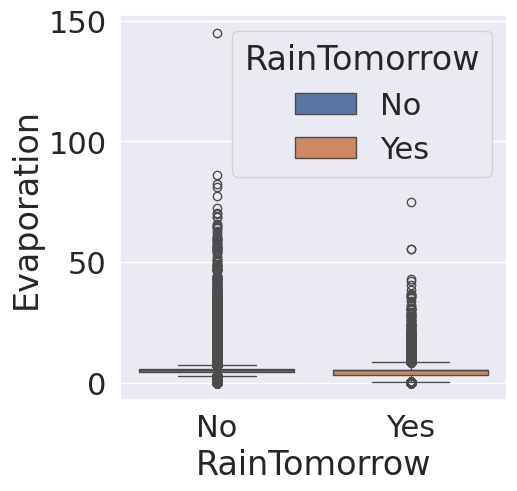

In [ ]:
plt.figure(figsize=(5, 5))
sns.boxplot(x='RainTomorrow', y=continous_features[3], hue='RainTomorrow', data=data)
plt.show()

In [ ]:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the first group has a flatter left tail (which, by the way, can explain why the average value in this group is higher).

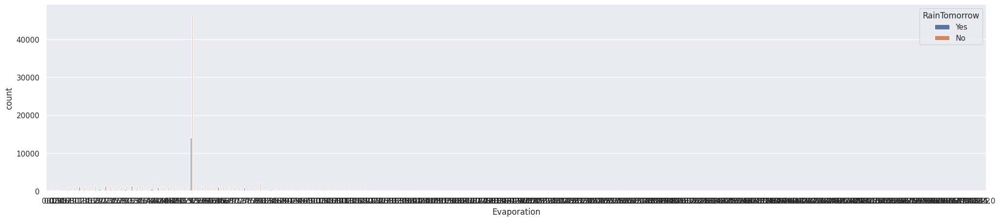

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(25, 5))
sns.countplot(x=continous_features[3], hue='RainTomorrow', data=data)
plt.show()
sns.set(font_scale=2)

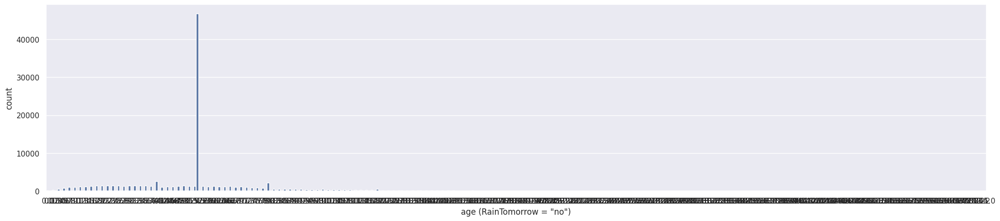

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(25, 5))
sns.countplot(x=continous_features[3], data=data[data.RainTomorrow == 'No'])
plt.xlabel('age (RainTomorrow = "no")')
plt.show()
sns.set(font_scale=2)

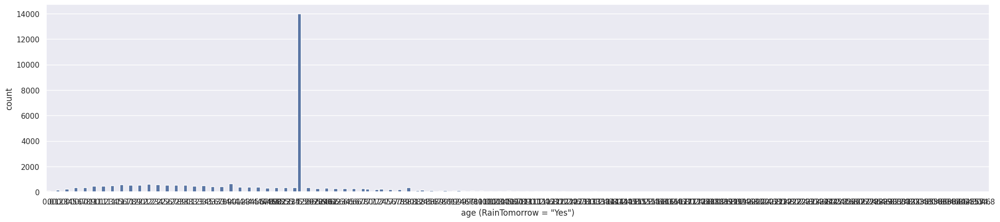

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(25, 5))
sns.countplot(x=continous_features[3], data=data[data.RainTomorrow == 'Yes'])
plt.xlabel('age (RainTomorrow = "Yes")')
plt.show()
sns.set(font_scale=2)

In [ ]:
continous_features[4]

'Sunshine'

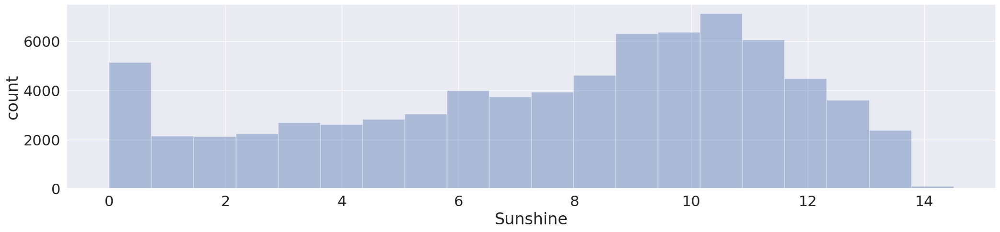

In [ ]:
plt.figure(figsize=(25, 5))
sns.distplot(data[continous_features[4]], bins=20, kde=False)
plt.ylabel('count')
plt.show()


In [ ]:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically significant differences in middle age in different groups is no longer available.

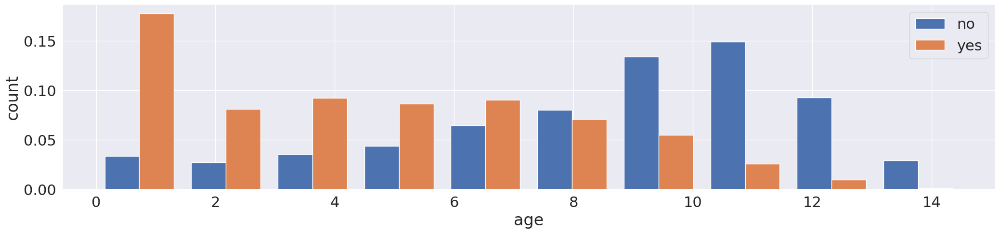

In [ ]:
plt.figure(figsize=(25, 5))
plt.hist(
    [
        data[data.RainTomorrow == 'No'][continous_features[4]],
        data[data.RainTomorrow == 'Yes'][continous_features[4]]
    ],
    label=['no', 'yes'],
    density=True
)
plt.legend()
plt.xlabel('age')
plt.ylabel('count')
plt.show()


In [ ]:
data[continous_features[4]] = data[continous_features[4]].fillna(data[continous_features[4]].mean())

scipy.stats.ks_2samp(
        data[data.RainTomorrow == 'No'][continous_features[4]],
        data[data.RainTomorrow == 'Yes'][continous_features[4]]
)


KstestResult(statistic=0.2507135103724927, pvalue=0.0, statistic_location=7.5, statistic_sign=-1)

In [ ]:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

In [ ]:
scipy.stats.kruskal(
    data[data.RainTomorrow == 'No'][continous_features[4]],
    data[data.RainTomorrow == 'Yes'][continous_features[4]]
)


KruskalResult(statistic=13473.973620528392, pvalue=0.0)

In [ ]:
# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different.

In [ ]:
data[data.RainTomorrow == 'No'][continous_features[4]].median()

7.6111775206611565

In [ ]:
data[data.RainTomorrow == 'Yes'][continous_features[4]].median()

7.6111775206611565

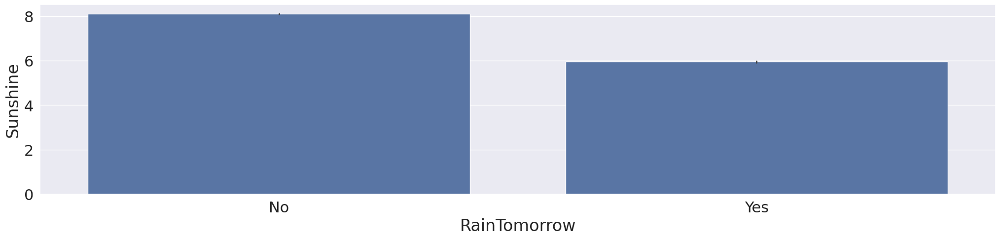

In [ ]:
plt.figure(figsize=(25, 5))
sns.barplot(x='RainTomorrow', y=continous_features[4], data=data)
plt.show()


In [ ]:
#It is curious that here, according to the schedule, it seems like the average value of age is higher in the first group, and not in the Second.

#Also, the scatter of Sunshine in the first group is higher.


In [ ]:
scipy.stats.ranksums(
    data[data.RainTomorrow == 'No'][continous_features[4]],
    data[data.RainTomorrow == 'Yes'][continous_features[4]]
)


RanksumsResult(statistic=109.59958593747113, pvalue=0.0)

In [ ]:
data[data.RainTomorrow == 'No'][continous_features[4]].mean()

8.09909646823745

In [ ]:
data[data.RainTomorrow == 'Yes'][continous_features[4]].mean()

5.954556223956909

In [ ]:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

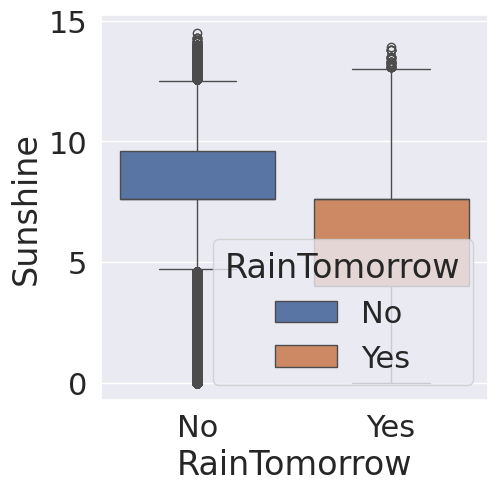

In [ ]:
plt.figure(figsize=(5, 5))
sns.boxplot(x='RainTomorrow', y=continous_features[4], hue='RainTomorrow', data=data)
plt.show()


In [ ]:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the first group has a flatter left tail (which, by the way, can explain why the average value in this group is higher).


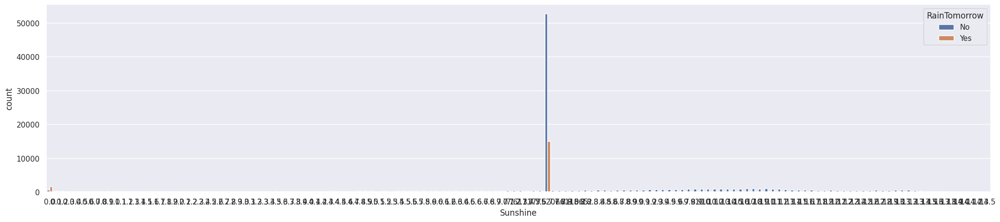

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(25, 5))
sns.countplot(x=continous_features[4], hue='RainTomorrow', data=data)
plt.show()
sns.set(font_scale=2)


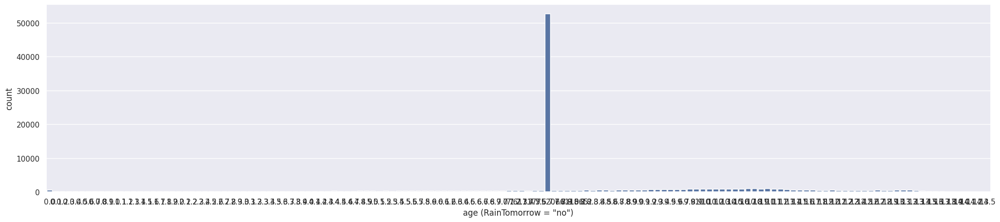

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(25, 5))
sns.countplot(x=continous_features[4], data=data[data.RainTomorrow == 'No'])
plt.xlabel('age (RainTomorrow = "no")')
plt.show()
sns.set(font_scale=2)


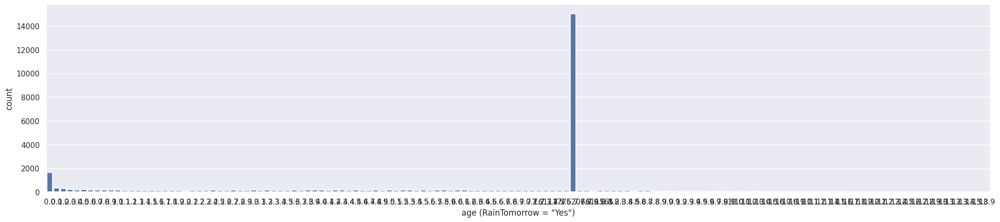

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(25, 5))
sns.countplot(x=continous_features[4], data=data[data.RainTomorrow == 'Yes'])
plt.xlabel('age (RainTomorrow = "Yes")')
plt.show()
sns.set(font_scale=2)


In [ ]:
continous_features[5]

'WindGustSpeed'

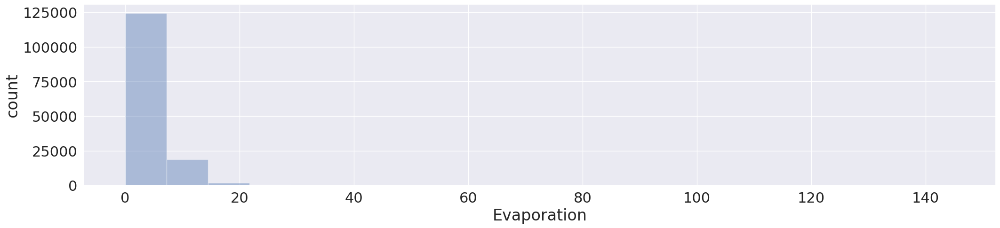

In [ ]:
plt.figure(figsize=(25, 5))
sns.distplot(data[continous_features[3]], bins=20, kde=False)
plt.ylabel('count')
plt.show()


In [ ]:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically significant differences in middle age in different groups is no longer available.

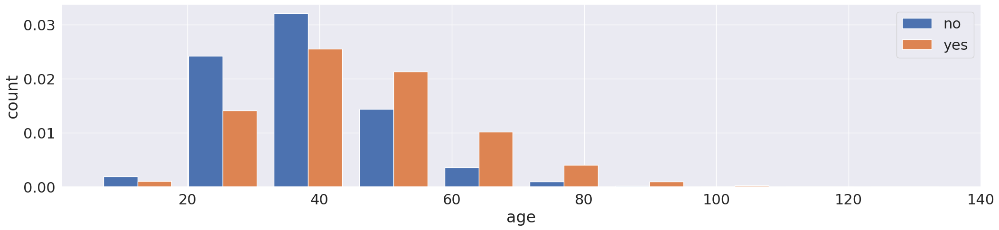

In [ ]:
plt.figure(figsize=(25, 5))
plt.hist(
    [
        data[data.RainTomorrow == 'No'][continous_features[5]],
        data[data.RainTomorrow == 'Yes'][continous_features[5]]
    ],
    label=['no', 'yes'],
    density=True
)
plt.legend()
plt.xlabel('age')
plt.ylabel('count')
plt.show()


In [ ]:
data[continous_features[5]] = data[continous_features[5]].fillna(data[continous_features[5]].mean())

scipy.stats.ks_2samp(
        data[data.RainTomorrow == 'No'][continous_features[5]],
        data[data.RainTomorrow == 'Yes'][continous_features[5]]
)


KstestResult(statistic=0.20574458120993133, pvalue=0.0, statistic_location=43.0, statistic_sign=1)

In [ ]:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

In [ ]:
scipy.stats.kruskal(
    data[data.RainTomorrow == 'No'][continous_features[5]],
    data[data.RainTomorrow == 'Yes'][continous_features[5]]
)


KruskalResult(statistic=5951.117246912783, pvalue=0.0)

In [ ]:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

In [ ]:
scipy.stats.kruskal(
    data[data.RainTomorrow == 'No'][continous_features[5]],
    data[data.RainTomorrow == 'Yes'][continous_features[5]]
)


KruskalResult(statistic=5951.117246912783, pvalue=0.0)

In [ ]:
# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different

In [ ]:
data[data.RainTomorrow == 'No'][continous_features[5]].median()

37.0

In [ ]:
data[data.RainTomorrow == 'Yes'][continous_features[5]].median()

43.0

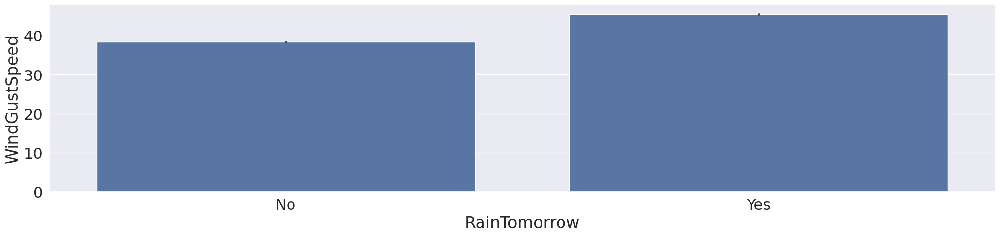

In [ ]:
plt.figure(figsize=(25, 5))
sns.barplot(x='RainTomorrow', y=continous_features[5], data=data)
plt.show()


In [ ]:
#It is curious that here, according to the schedule, it seems like the average value of age is higher in the second group, and not in the first.
#Also, the scatter of Evaporation in the second group is higher.

In [ ]:
scipy.stats.ranksums(
    data[data.RainTomorrow == 'No'][continous_features[5]],
    data[data.RainTomorrow == 'Yes'][continous_features[5]]
)


RanksumsResult(statistic=-77.06438081533301, pvalue=0.0)

In [ ]:
data[data.RainTomorrow == 'No'][continous_features[5]].mean()

38.3965113938992

In [ ]:
data[data.RainTomorrow == 'Yes'][continous_features[5]].mean()

45.49389942074305

In [ ]:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

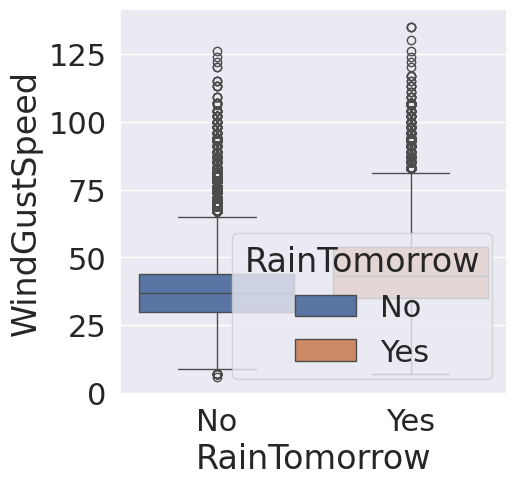

In [ ]:
plt.figure(figsize=(5, 5))
sns.boxplot(x='RainTomorrow', y=continous_features[5], hue='RainTomorrow', data=data)
plt.show()


In [ ]:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the second group has a flatter right tail (which, by the way, can explain why the average value in this group is higher).


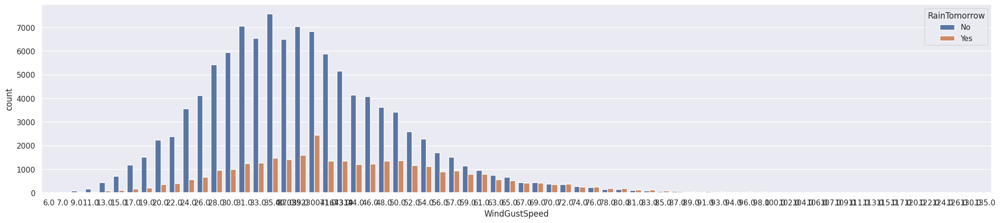

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(25, 5))
sns.countplot(x=continous_features[5], hue='RainTomorrow', data=data)
plt.show()
sns.set(font_scale=2)


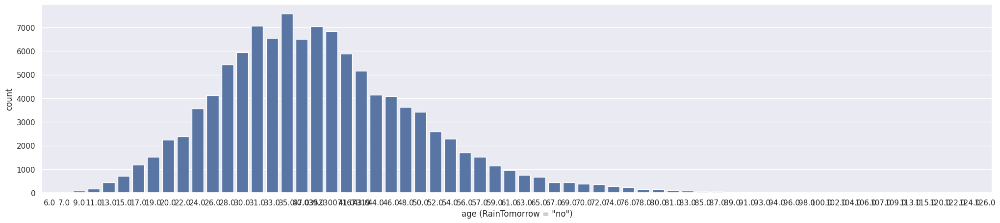

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(25, 5))
sns.countplot(x=continous_features[5], data=data[data.RainTomorrow == 'No'])
plt.xlabel('age (RainTomorrow = "no")')
plt.show()
sns.set(font_scale=2)


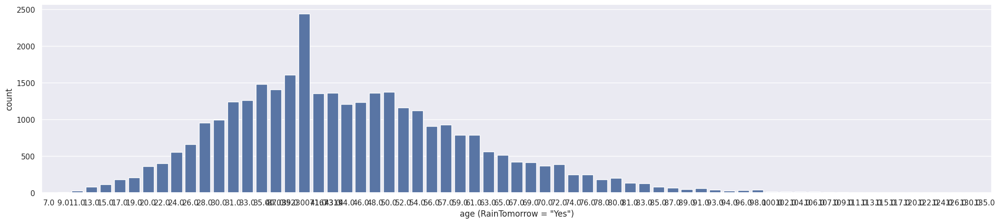

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(25, 5))
sns.countplot(x=continous_features[5], data=data[data.RainTomorrow == 'Yes'])
plt.xlabel('age (RainTomorrow = "Yes")')
plt.show()
sns.set(font_scale=2)


In [ ]:
continous_features[6]

'WindSpeed9am'

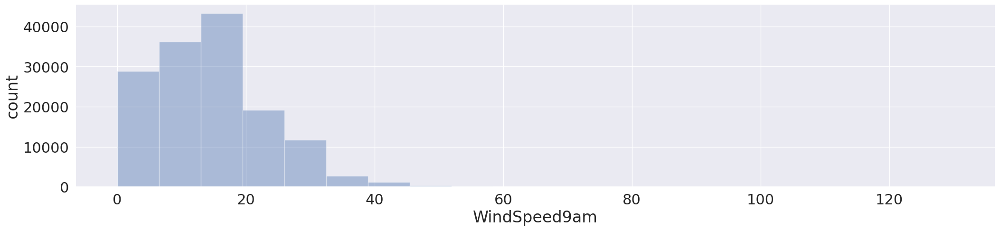

In [ ]:
plt.figure(figsize=(25, 5))
sns.distplot(data[continous_features[6]], bins=20, kde=False)
plt.ylabel('count')
plt.show()


In [ ]:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically significant differences in middle age in different
#groups is no longer available.

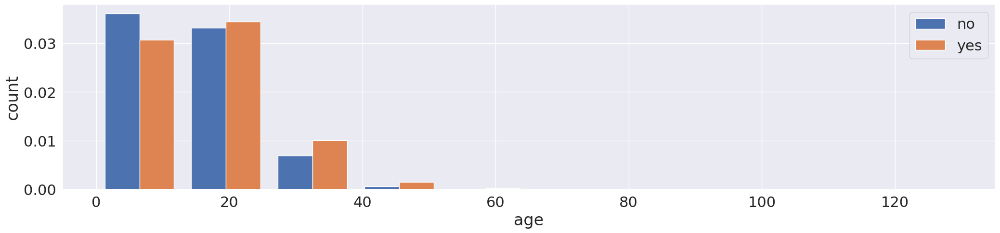

In [ ]:
plt.figure(figsize=(25, 5))
plt.hist(
    [
        data[data.RainTomorrow == 'No'][continous_features[6]],
        data[data.RainTomorrow == 'Yes'][continous_features[6]]
    ],
    label=['no', 'yes'],
    density=True
)
plt.legend()
plt.xlabel('age')
plt.ylabel('count')
plt.show()


In [ ]:
data[continous_features[6]] = data[continous_features[6]].fillna(data[continous_features[6]].mean())

scipy.stats.ks_2samp(
        data[data.RainTomorrow == 'No'][continous_features[6]],
        data[data.RainTomorrow == 'Yes'][continous_features[6]]
)


KstestResult(statistic=0.07648105622610069, pvalue=2.9226619155300406e-126, statistic_location=15.0, statistic_sign=1)

In [ ]:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

In [ ]:
scipy.stats.kruskal(
    data[data.RainTomorrow == 'No'][continous_features[6]],
    data[data.RainTomorrow == 'Yes'][continous_features[6]]
)


KruskalResult(statistic=932.2988796148368, pvalue=9.344766207803729e-205)

In [ ]:
# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different.

In [ ]:
data[data.RainTomorrow == 'No'][continous_features[6]].median()

13.0

In [ ]:
data[data.RainTomorrow == 'Yes'][continous_features[6]].median()

15.0

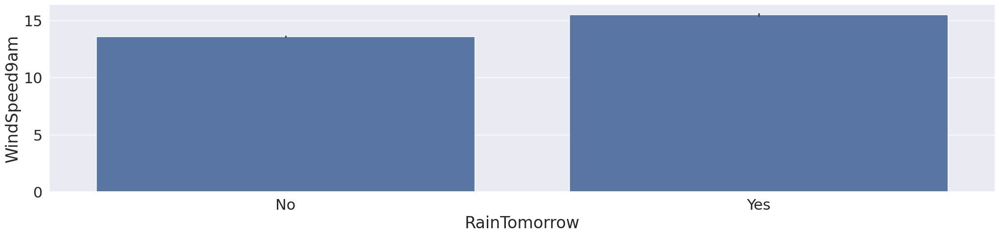

In [ ]:
plt.figure(figsize=(25, 5))
sns.barplot(x='RainTomorrow', y=continous_features[6], data=data)
plt.show()


In [ ]:
#It is curious that here, according to the schedule, it seems like the average value of age is higher in the second group, and not in the first.

#Also, the scatter of WindSpeed9am in the second group is higher.


In [ ]:
scipy.stats.ranksums(
    data[data.RainTomorrow == 'No'][continous_features[6]],
    data[data.RainTomorrow == 'Yes'][continous_features[6]]
)


RanksumsResult(statistic=-30.465390278674942, pvalue=7.492476404186619e-204)

In [ ]:
data[data.RainTomorrow == 'No'][continous_features[6]].mean()

13.57166479316048

In [ ]:
data[data.RainTomorrow == 'Yes'][continous_features[6]].mean()

15.492949926627045

In [ ]:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

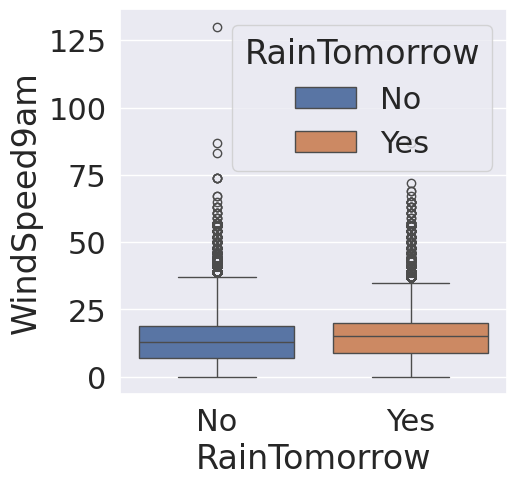

In [ ]:
plt.figure(figsize=(5, 5))
sns.boxplot(x='RainTomorrow', y=continous_features[6], hue='RainTomorrow', data=data)
plt.show()


In [ ]:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the second group has a flatter right tail (which, by the way, can explain why the average value in this group is higher).


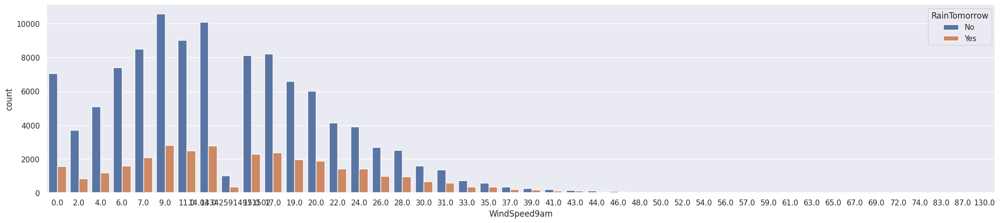

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(25, 5))
sns.countplot(x=continous_features[6], hue='RainTomorrow', data=data)
plt.show()
sns.set(font_scale=2)


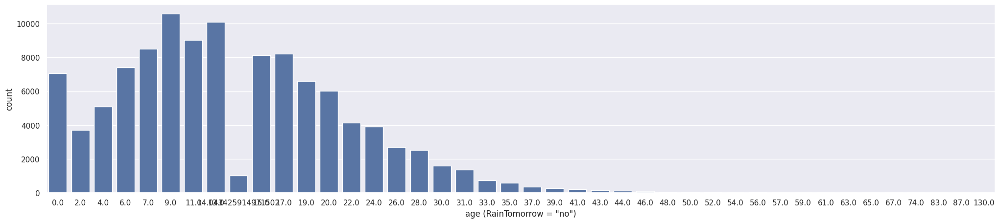

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(25, 5))
sns.countplot(x=continous_features[6], data=data[data.RainTomorrow == 'No'])
plt.xlabel('age (RainTomorrow = "no")')
plt.show()
sns.set(font_scale=2)


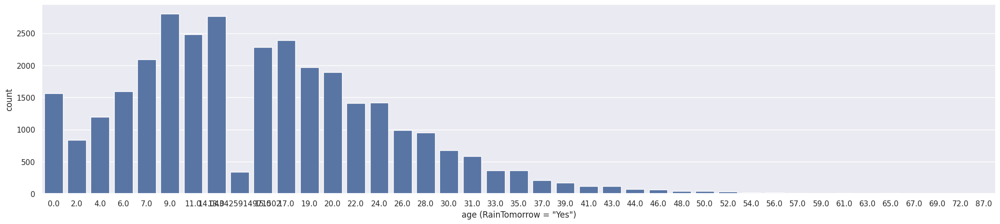

In [ ]:
sns.set(font_scale=1)
plt.figure(figsize=(25, 5))
sns.countplot(x=continous_features[6], data=data[data.RainTomorrow == 'Yes'])
plt.xlabel('age (RainTomorrow = "Yes")')
plt.show()
sns.set(font_scale=2)


In [ ]:
continous_features[7]

'WindSpeed3pm'

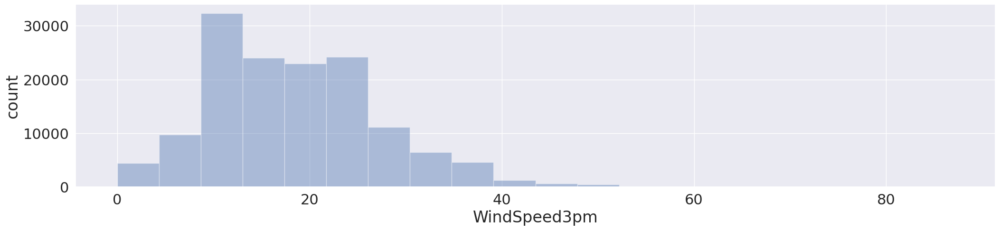

In [ ]:
plt.figure(figsize=(25, 5))
sns.distplot(data[continous_features[7]], bins=20, kde=False)
plt.ylabel('count')
plt.show()


Analyzing Feature: WindSpeed3pm



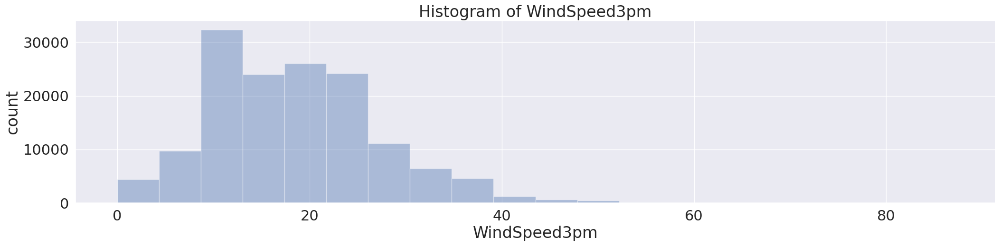

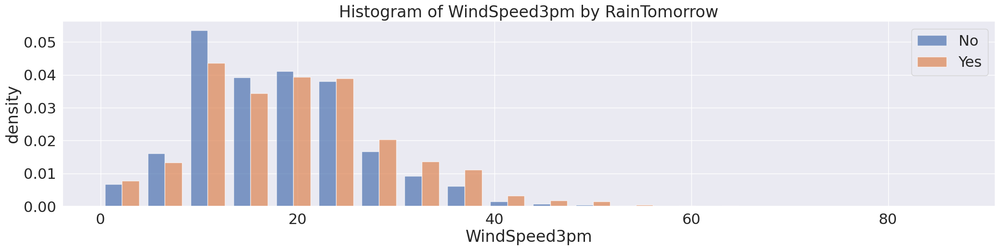

Kolmogorov-Smirnov Test: KstestResult(statistic=0.07993555729263269, pvalue=6.69947309319767e-138, statistic_location=24.0, statistic_sign=1)
Kruskal-Wallis Test: KruskalResult(statistic=806.0745276281574, pvalue=2.5784319304484927e-177)
Median (No): 17.0, Median (Yes): 19.0



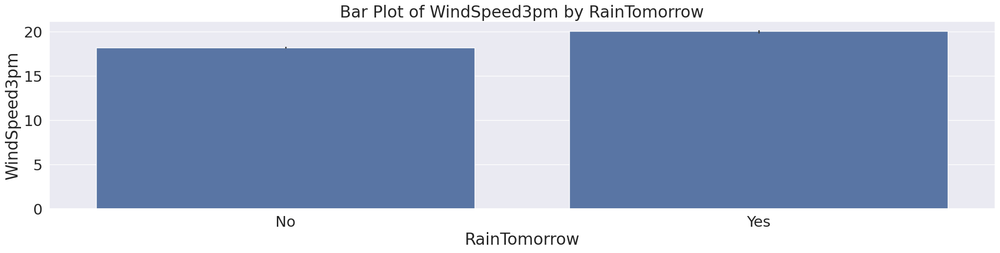

Rank-Sum Test: RanksumsResult(statistic=-28.331420236941806, pvalue=1.418053650056522e-176)
Mean (No): 18.230566669825716, Mean (Yes): 20.048172493646835



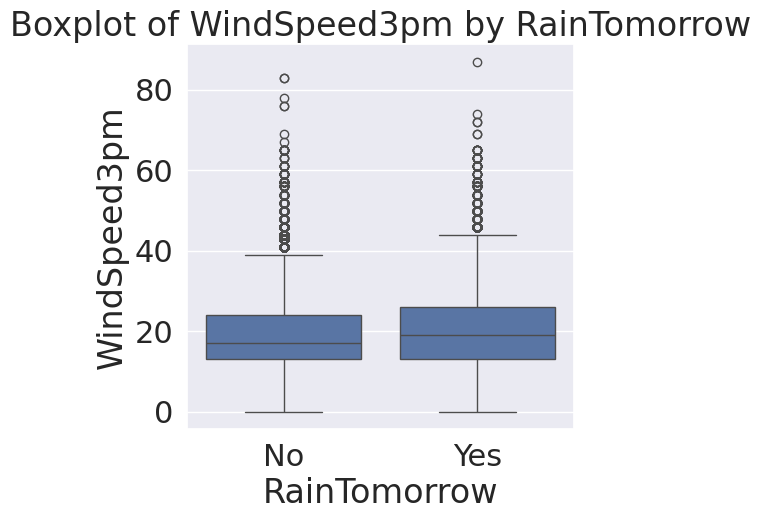

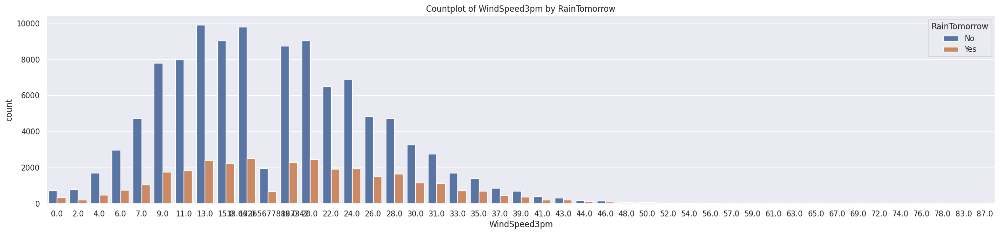

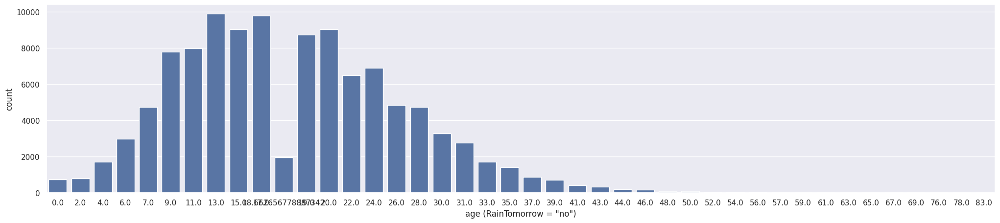

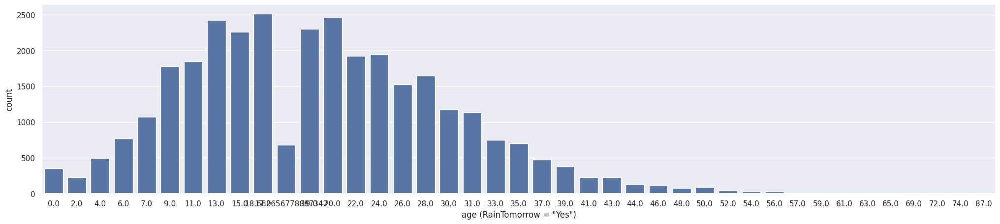

In [ ]:

univariate_analysis(continous_features[7], data=data)


In [ ]:
# For the historgram:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically
# significant differences in middle age in different groups is no longer available.

# For Kolmogorov-Smirmov test:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

# For kruskal test:

# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different

#For medians and Bar Plot:
#It is curious that here, according to the schedule, it seems like the average value of WindSpeed3pm is higher in the second group, and not in the first.
#Also, the scatter of WindSpeed3pm in the second group is higher.

#Fro ranksums and medians:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

#For Box-plot:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the second group has a flatter right tail (which, by the way, can explain why the average value in this group is higher).


Analyzing Feature: Humidity9am



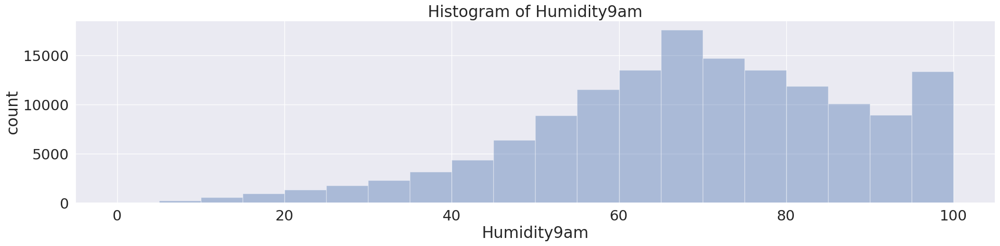

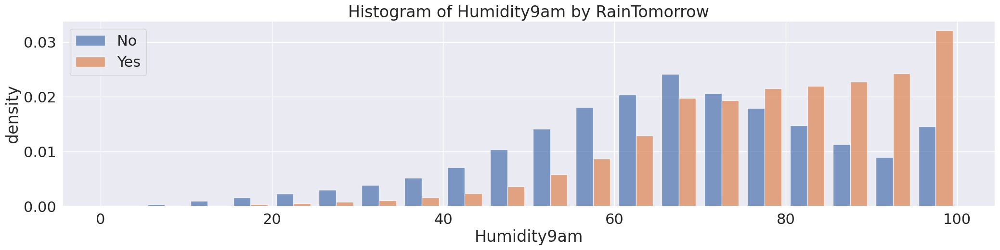

Kolmogorov-Smirnov Test: KstestResult(statistic=0.2779639044108844, pvalue=0.0, statistic_location=73.0, statistic_sign=1)
Kruskal-Wallis Test: KruskalResult(statistic=9967.825421267273, pvalue=0.0)
Median (No): 67.0, Median (Yes): 80.0



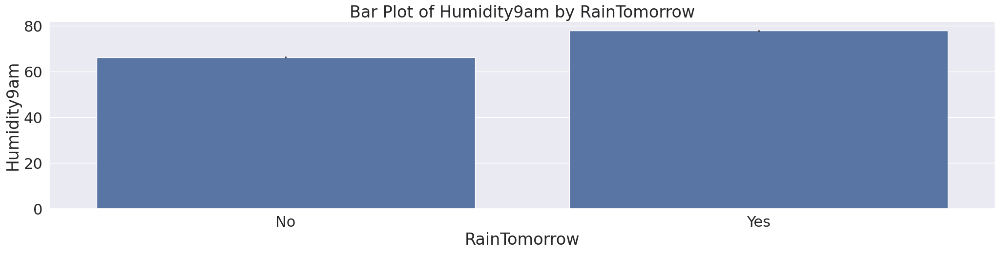

Rank-Sum Test: RanksumsResult(statistic=-99.82583419969998, pvalue=0.0)
Mean (No): 66.2475092539491, Mean (Yes): 77.83082987527962



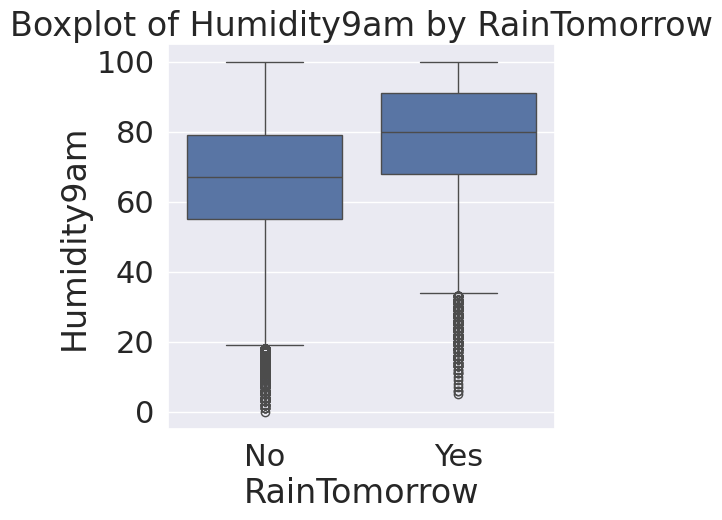

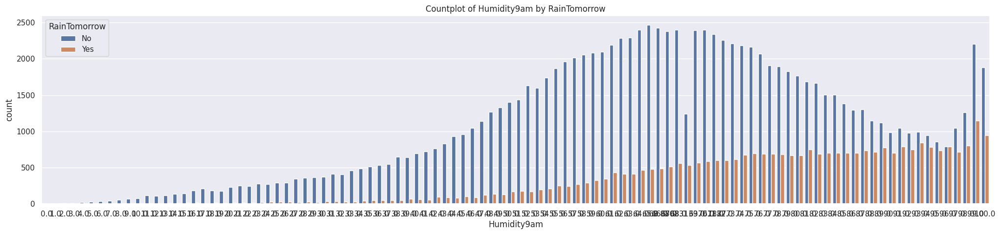

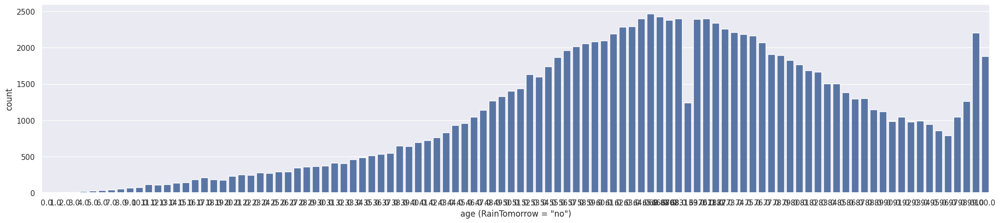

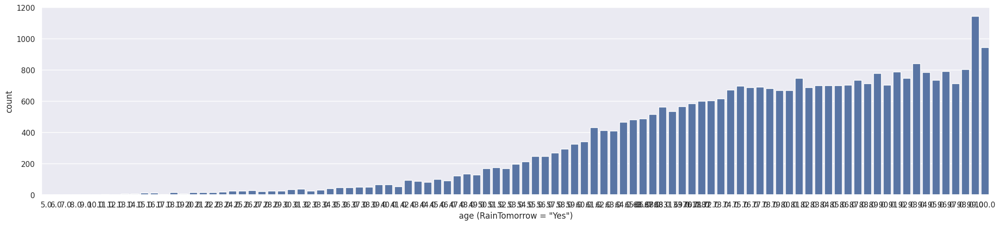

In [ ]:
univariate_analysis(continous_features[8], data=data)

In [ ]:
# For the historgram:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically
# significant differences in middle age in different groups is no longer available.

# For Kolmogorov-Smirmov test:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

# For kruskal test:
# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different

#For medians and Bar Plot:
#It is curious that here, according to the schedule, it seems like the average value of Humidity9am is higher in the second group, and not in the first.
#Also, the scatter of Humidity9am in the second group is higher.

#Fro ranksums and means:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

#For Box-plot:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the second group has a flatter right tail (which, by the way, can explain why the average value in this group is higher).


In [ ]:
continous_features[9]

'Humidity3pm'

Analyzing Feature: Humidity3pm



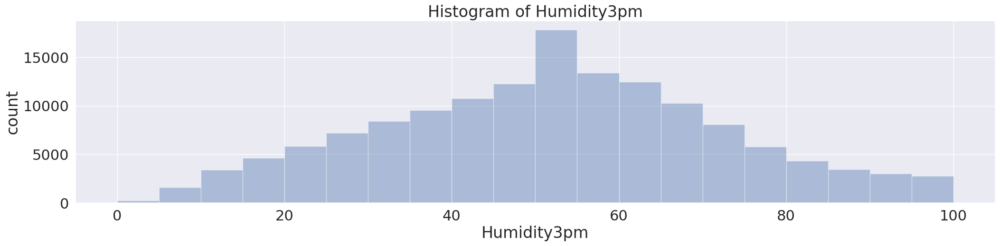

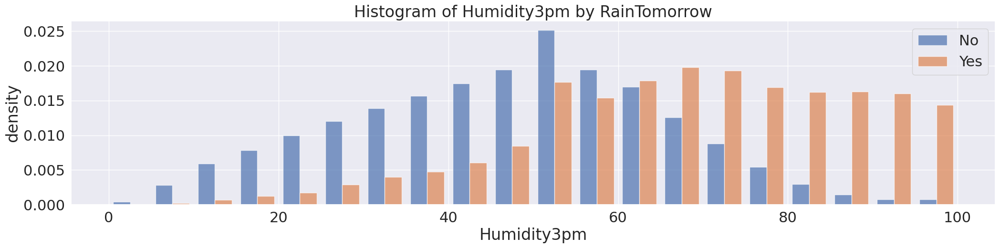

Kolmogorov-Smirnov Test: KstestResult(statistic=0.4370344418684639, pvalue=0.0, statistic_location=60.0, statistic_sign=1)
Kruskal-Wallis Test: KruskalResult(statistic=25466.325210460454, pvalue=0.0)
Median (No): 48.0, Median (Yes): 69.0



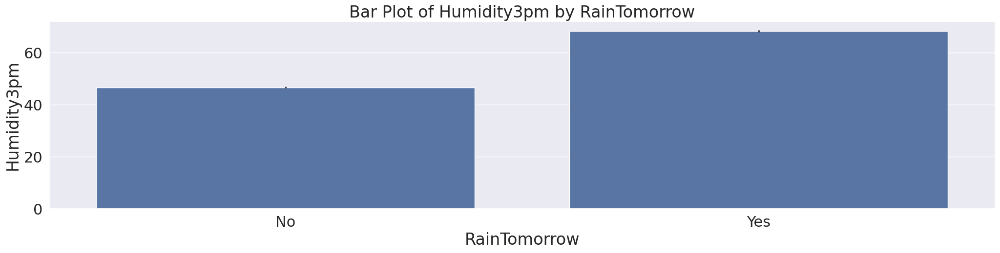

Rank-Sum Test: RanksumsResult(statistic=-159.56558893762164, pvalue=0.0)
Mean (No): 46.63123663481803, Mean (Yes): 68.27802828697766



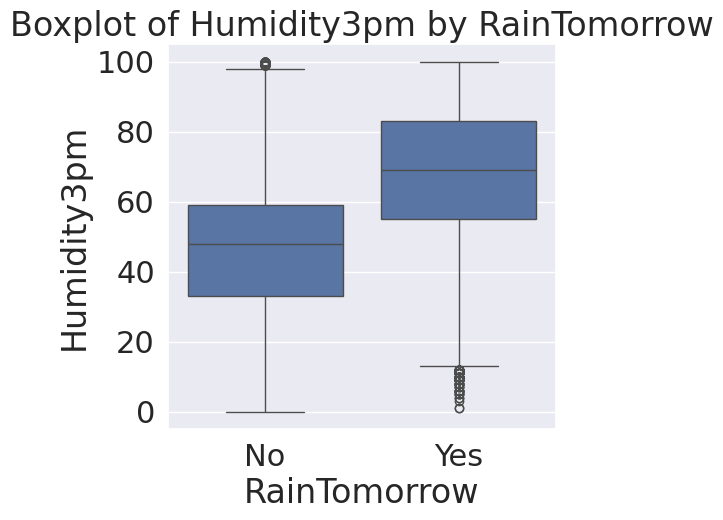

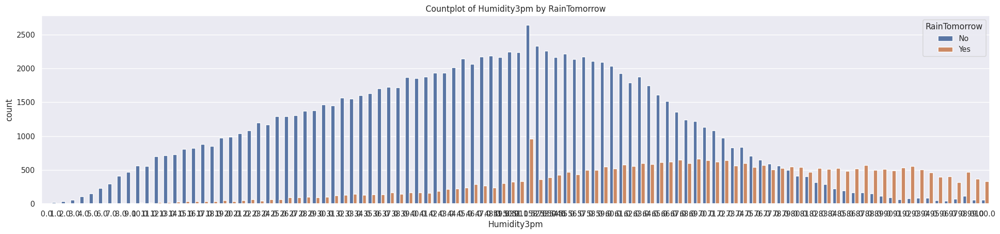

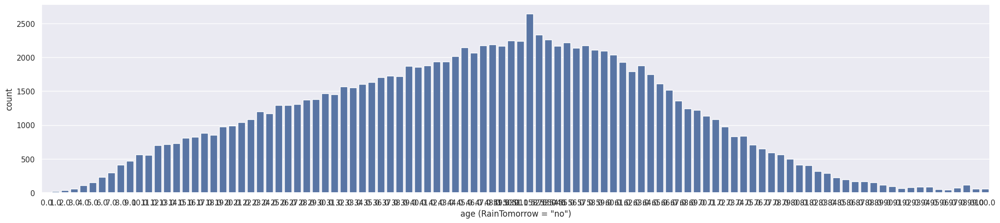

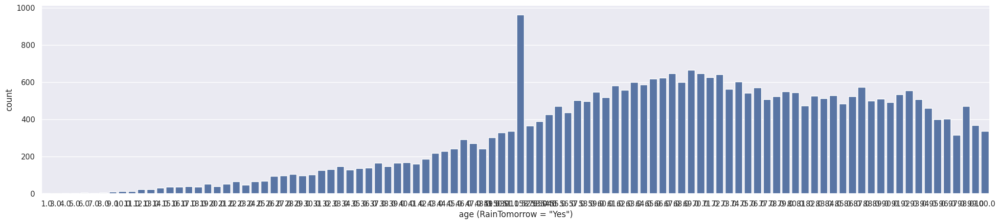

In [ ]:
univariate_analysis(continous_features[9], data=data)

In [ ]:
# For the historgram:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically
# significant differences in middle age in different groups is no longer available.

# For Kolmogorov-Smirmov test:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

# For kruskal test:
# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different

#For medians and Bar Plot:
#It is curious that here, according to the schedule, it seems like the average value of Humidity3pm is higher in the second group, and not in the first.
#Also, the scatter of Humidity3pm in the second group is higher.

#Fro ranksums and means:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

#For Box-plot:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the second group has a flatter right tail (which, by the way, can explain why the average value in this group is higher).


In [ ]:
continous_features[10]

'Pressure9am'

In [ ]:
normal_dist_test(data,continous_features=continous_features,index=10)

Shapiro-Wilk Test Statistic: 0.9960108372665865
Shapiro-Wilk Test p-value: 3.0468355185849023e-46
The distribution is likely not normal (reject H0).


Analyzing Feature: Pressure9am



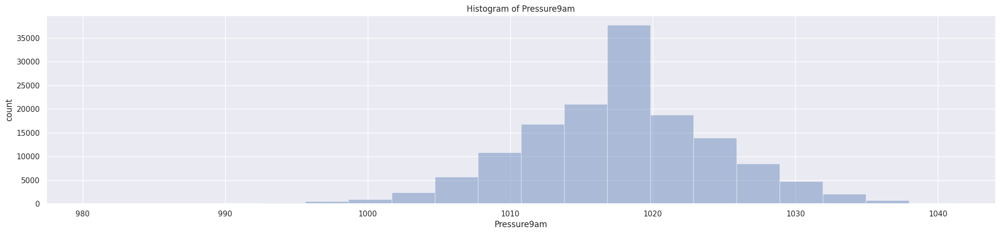

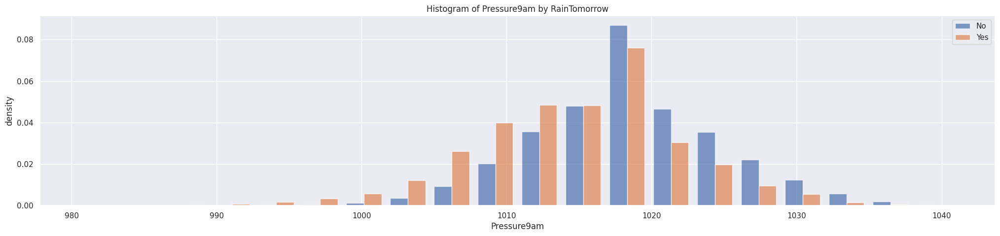

Kolmogorov-Smirnov Test: KstestResult(statistic=0.21639979475161458, pvalue=0.0, statistic_location=1015.3, statistic_sign=-1)
Kruskal-Wallis Test: KruskalResult(statistic=6921.163824308531, pvalue=0.0)
Median (No): 1017.6499397983052, Median (Yes): 1015.3



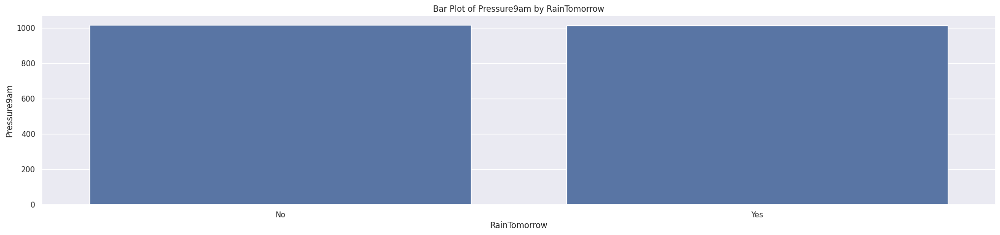

Rank-Sum Test: RanksumsResult(statistic=83.15312876349395, pvalue=0.0)
Mean (No): 1018.5020667277577, Mean (Yes): 1014.7163586031979



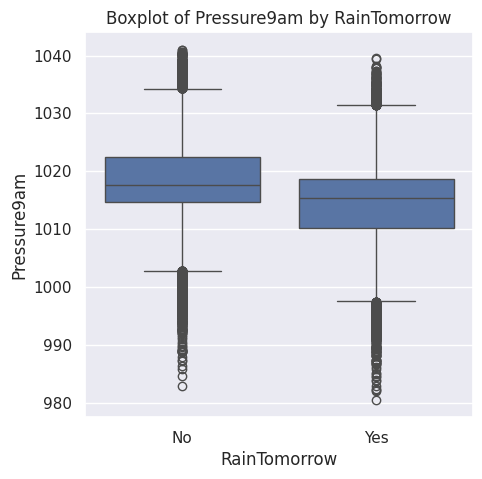

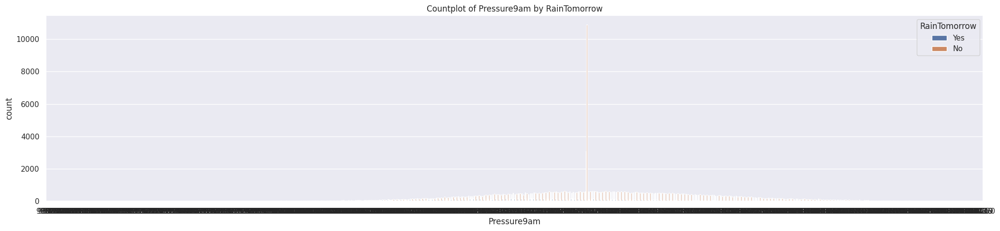

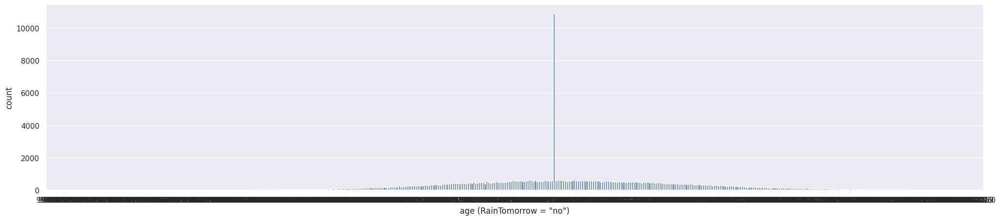

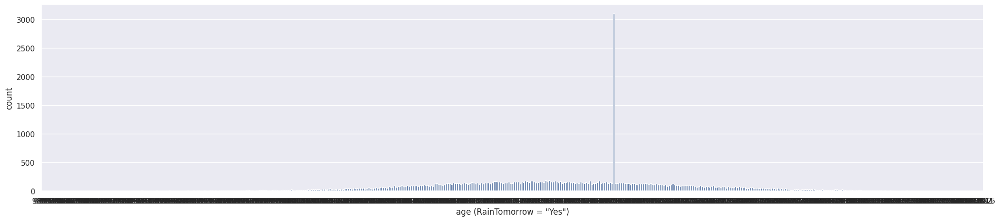

In [ ]:

univariate_analysis(continous_features[10], data=data)


In [ ]:
# For the historgram:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically
# significant differences in middle age in different groups is no longer available.

# For Kolmogorov-Smirmov test:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

# For kruskal test:
# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different

#For medians and Bar Plot:
#It is curious that here, according to the schedule, it seems like the average value of Preassure9am is higher in the second group, and not in the first.
#Also, the scatter of Preassure9am in the second group is higher.

#Fro ranksums and means:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

#For Box-plot:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the second group has a flatter right tail (which, by the way, can explain why the average value in this group is higher).


In [ ]:
normal_dist_test(data,continous_features=continous_features,index=11)


Shapiro-Wilk Test Statistic: 0.9960108372665865
Shapiro-Wilk Test p-value: 3.0468355185849023e-46
The distribution is likely not normal (reject H0).


Analyzing Feature: Pressure3pm



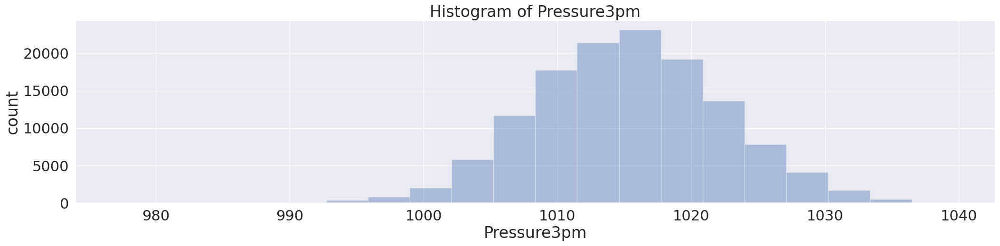

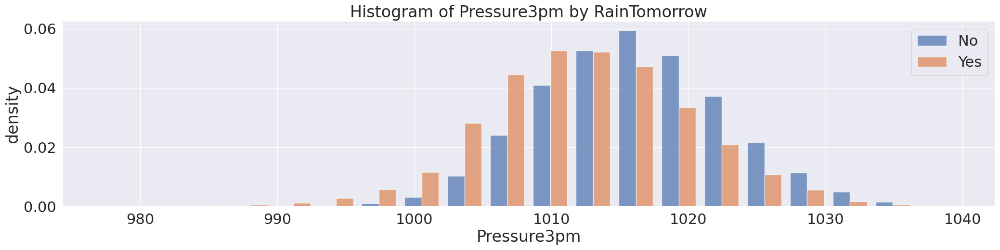

Kolmogorov-Smirnov Test: KstestResult(statistic=0.19491612907081496, pvalue=0.0, statistic_location=1012.4, statistic_sign=-1)
Kruskal-Wallis Test: KruskalResult(statistic=5776.385335718983, pvalue=0.0)
Median (No): 1015.2558888309618, Median (Yes): 1013.2



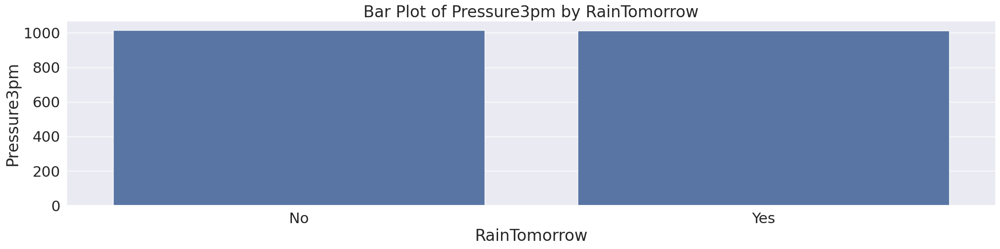

Rank-Sum Test: RanksumsResult(statistic=75.96588340081108, pvalue=0.0)
Mean (No): 1016.0290890878467, Mean (Yes): 1012.589402451008



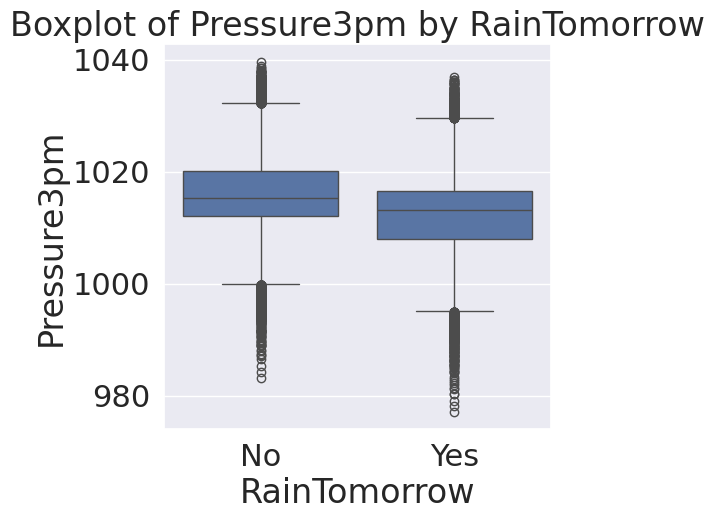

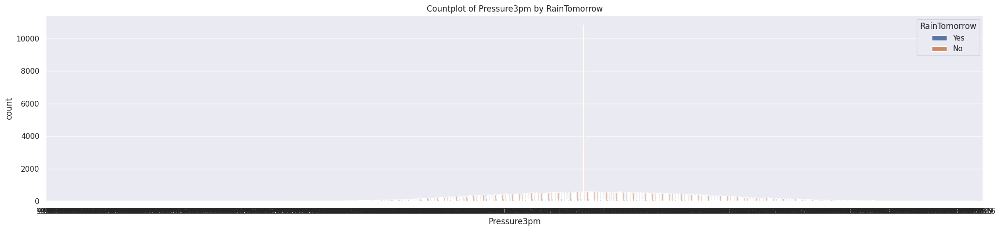

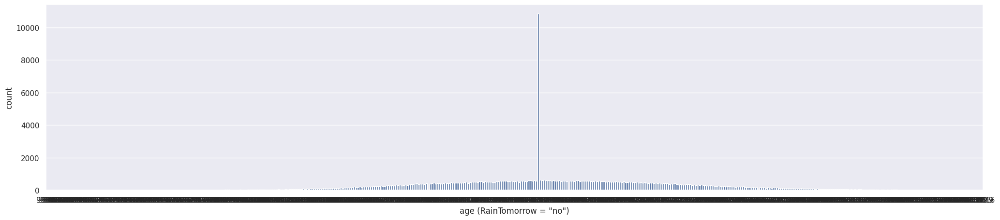

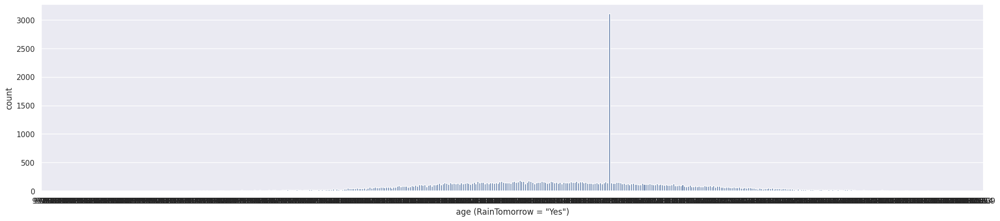

In [ ]:
univariate_analysis(continous_features[11], data=data)

In [ ]:
# For the historgram:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically
# significant differences in middle age in different groups is no longer available.

# For Kolmogorov-Smirmov test:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

# For kruskal test:
# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different

#For medians and Bar Plot:
#It is curious that here, according to the schedule, it seems like the average value of Pressure3pm is slightly higher in the first group, and not in the second.
#Also, the scatter of Pressure3pm in the first group is higher.

#Fro ranksums and means:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

#For Box-plot:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the second group has a flatter right tail (which, by the way, can explain why the average value in this group is higher).


In [ ]:
normal_dist_test(data,continous_features=continous_features,index=12)


Shapiro-Wilk Test Statistic: 0.9960108372665865
Shapiro-Wilk Test p-value: 3.0468355185849023e-46
The distribution is likely not normal (reject H0).


Analyzing Feature: Cloud9am



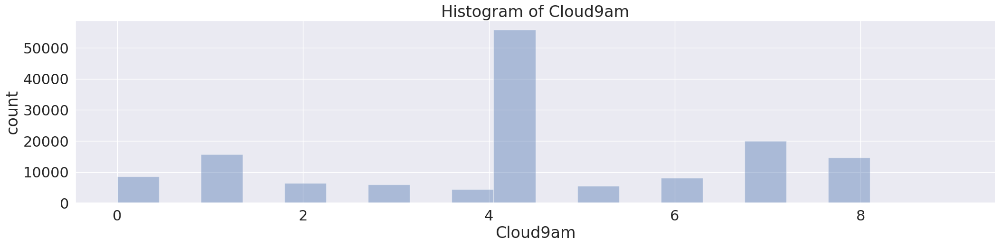

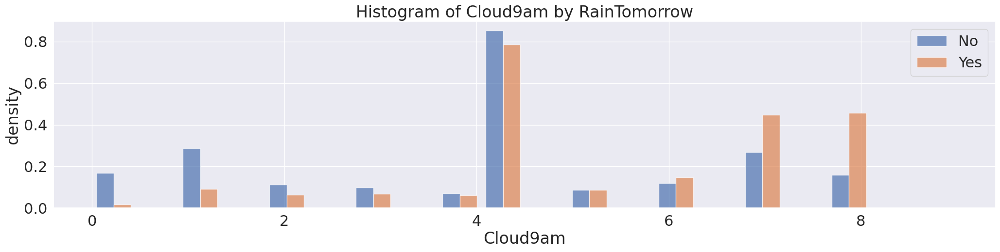

Kolmogorov-Smirnov Test: KstestResult(statistic=0.2276864488633834, pvalue=0.0, statistic_location=5.0, statistic_sign=1)
Kruskal-Wallis Test: KruskalResult(statistic=8897.451832822815, pvalue=0.0)
Median (No): 4.4474612602152455, Median (Yes): 5.0



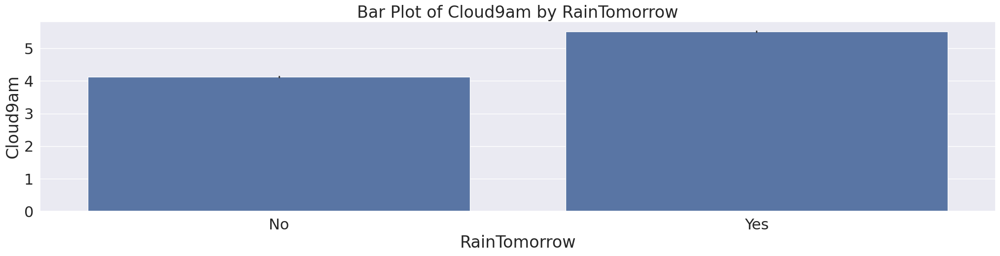

Rank-Sum Test: RanksumsResult(statistic=-91.48134901360726, pvalue=0.0)
Mean (No): 4.1303007030317165, Mean (Yes): 5.516522147119322



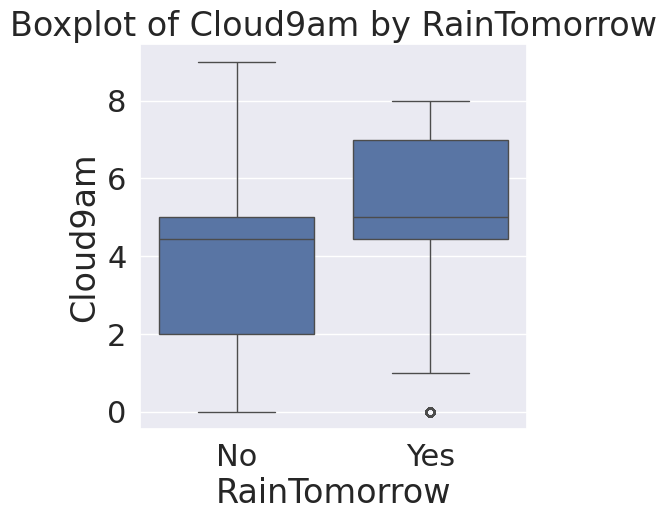

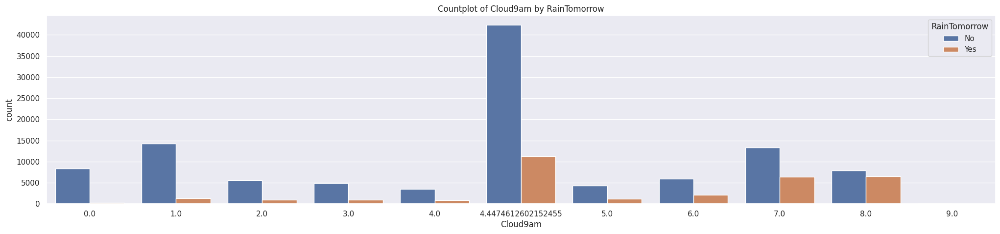

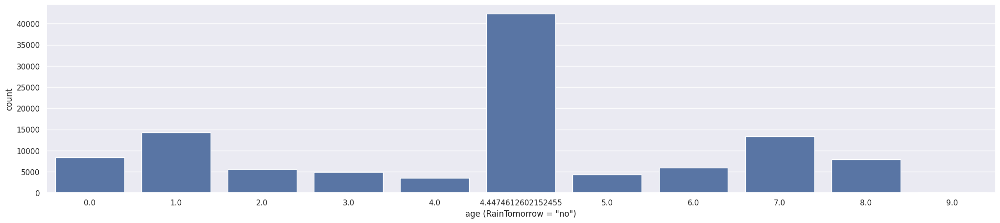

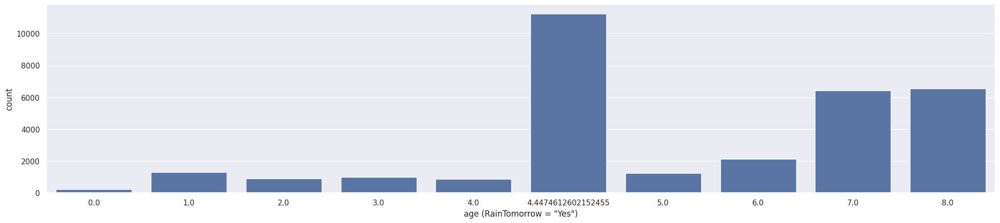

In [ ]:
univariate_analysis(continous_features[12], data=data)

In [ ]:
# For the historgram:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically
# significant differences in middle age in different groups is no longer available.

# For Kolmogorov-Smirmov test:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

# For kruskal test:
# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different

#For medians and Bar Plot:
#It is curious that here, according to the schedule, it seems like the average value of Cloud9am is higher in the second group, and not in the first.
#Also, the scatter of Cloud9am in the second group is higher.

#Fro ranksums and means:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

#For Box-plot:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the second group has a flatter right tail (which, by the way, can explain why the average value in this group is higher).


Analyzing Feature: Cloud3pm



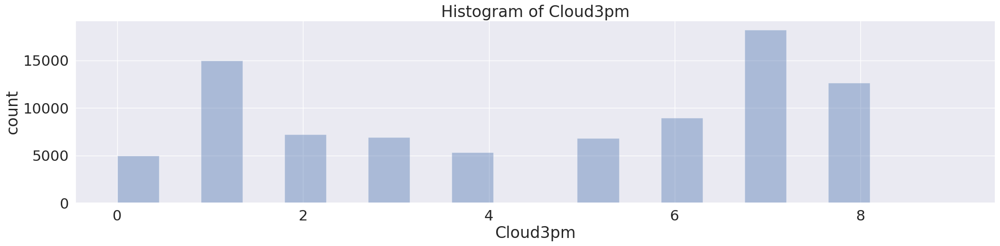

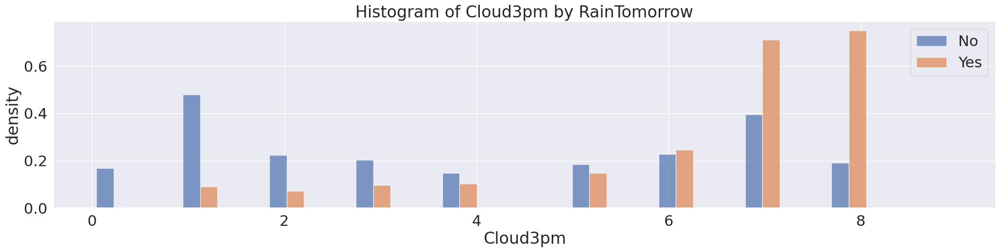

Kolmogorov-Smirnov Test: KstestResult(statistic=0.2737955756147399, pvalue=0.0, statistic_location=5.0, statistic_sign=1)
Kruskal-Wallis Test: KruskalResult(statistic=12438.84766419971, pvalue=0.0)
Median (No): 4.509930082924903, Median (Yes): 5.0



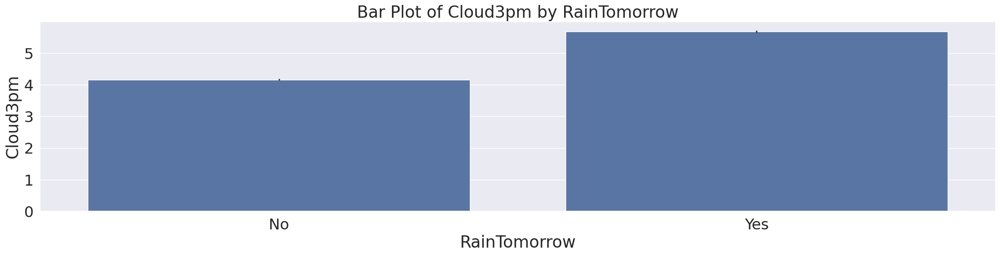

Rank-Sum Test: RanksumsResult(statistic=-107.5980502706451, pvalue=0.0)
Mean (No): 4.164458178537091, Mean (Yes): 5.687441720708245



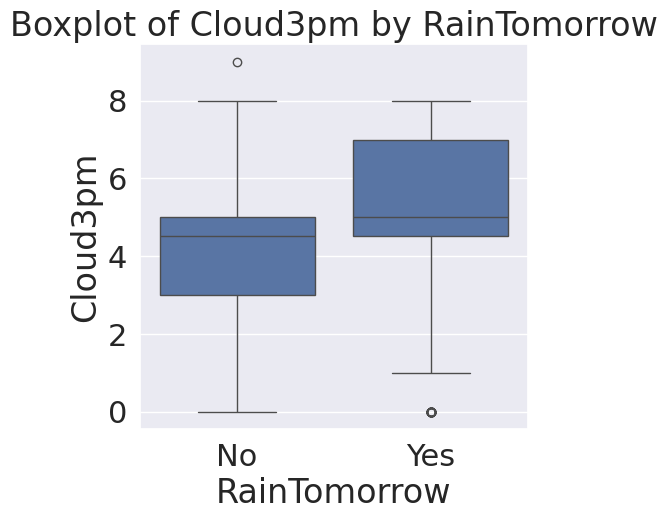

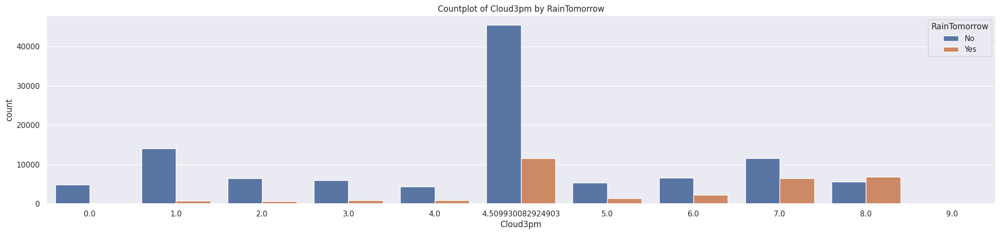

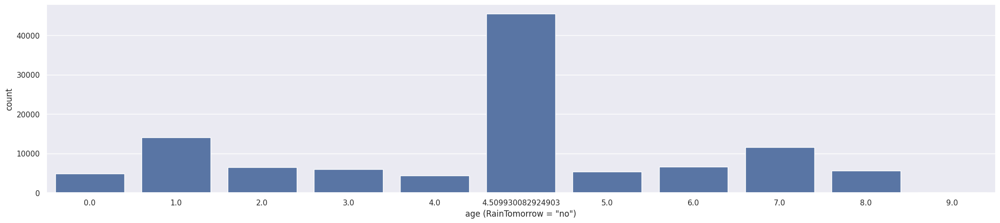

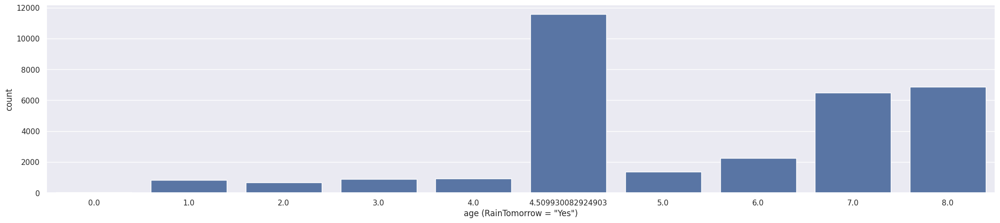

In [ ]:
univariate_analysis(continous_features[13], data=data)

In [ ]:
# For the historgram:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically
# significant differences in middle age in different groups is no longer available.

# For Kolmogorov-Smirmov test:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

# For kruskal test:
# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different

#For medians and Bar Plot:
#It is curious that here, according to the schedule, it seems like the average value of Cloud3pm is higher in the second group, and not in the first.
#Also, the scatter of Cloud3pm in the second group is higher.

#Fro ranksums and means:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

#For Box-plot:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the second group has a flatter right tail (which, by the way, can explain why the average value in this group is higher).


In [ ]:
normal_dist_test(data,continous_features=continous_features,index=14)


Shapiro-Wilk Test Statistic: 0.9960108372665865
Shapiro-Wilk Test p-value: 3.0468355185849023e-46
The distribution is likely not normal (reject H0).


Analyzing Feature: Temp9am



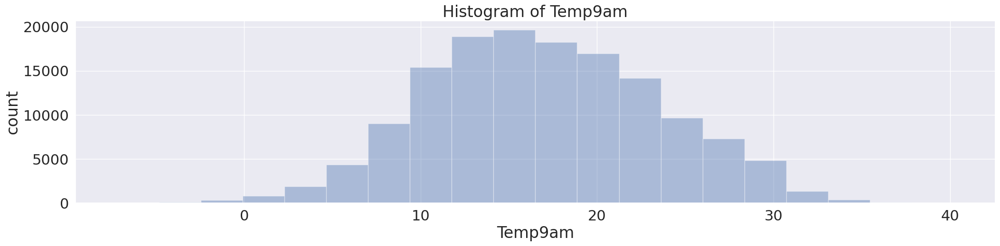

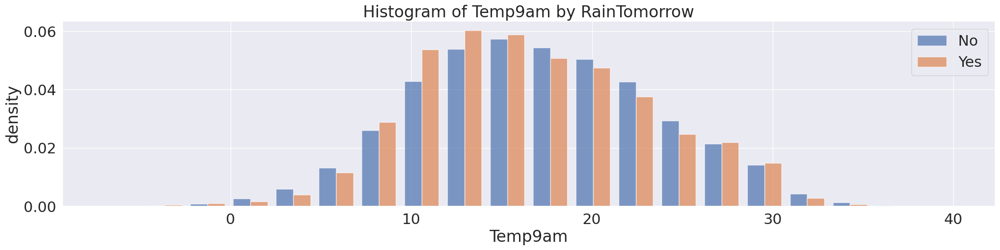

Kolmogorov-Smirnov Test: KstestResult(statistic=0.042222470029979475, pvalue=9.524736333794731e-39, statistic_location=17.0, statistic_sign=-1)
Kruskal-Wallis Test: KruskalResult(statistic=129.2899608731784, pvalue=5.8600713205949845e-30)
Median (No): 16.9, Median (Yes): 16.2



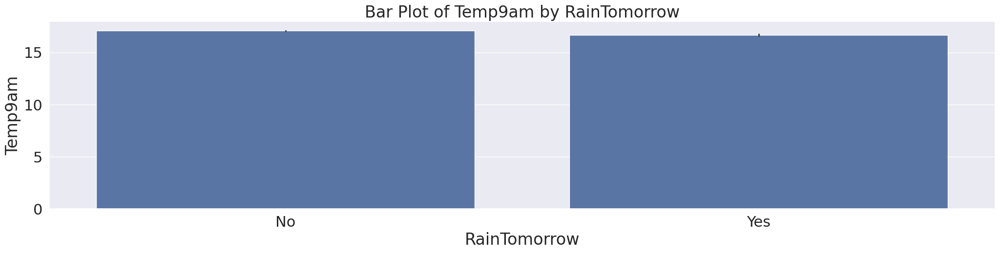

Rank-Sum Test: RanksumsResult(statistic=11.370457682416772, pvalue=5.8679090684867526e-30)
Mean (No): 17.076526729013437, Mean (Yes): 16.67953408921307



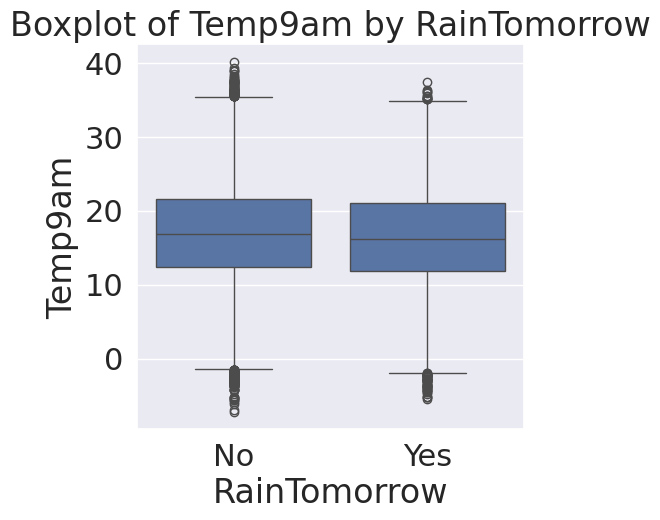

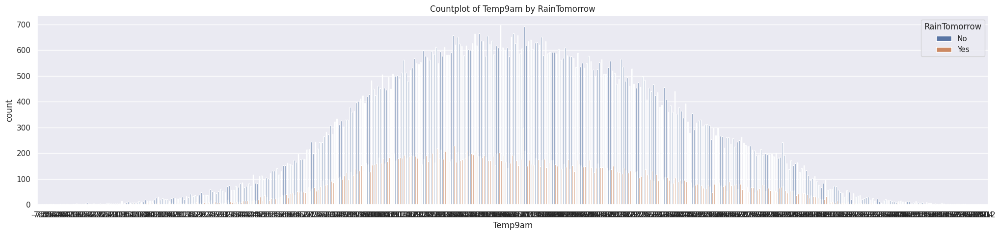

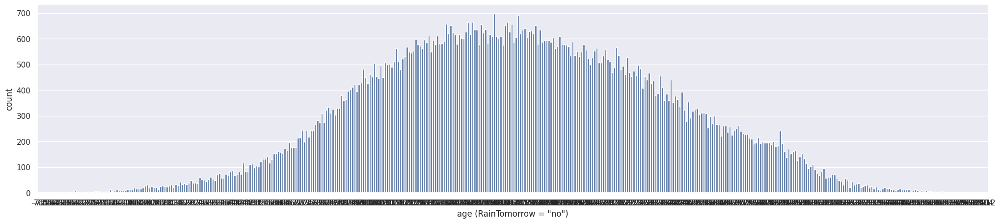

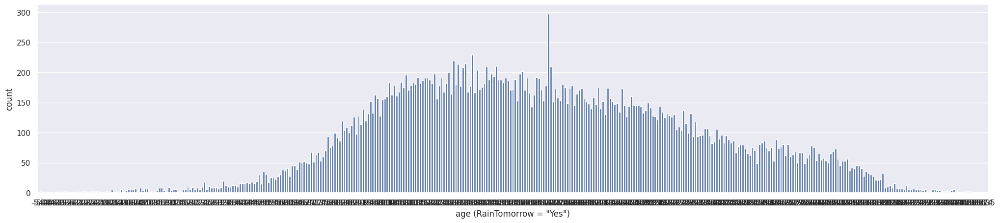

In [ ]:
univariate_analysis(continous_features[14], data=data)

In [ ]:
# For the historgram:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically
# significant differences in middle age in different groups is no longer available.

# For Kolmogorov-Smirmov test:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

# For kruskal test:
# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different

#For medians and Bar Plot:
#It is curious that here, according to the schedule, it seems like the average value of Temp9am is higher in the frist group, and not in the second.
#Also, the scatter of Temp9am in the first group is higher.

#Fro ranksums and means:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

#For Box-plot:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the second group has a flatter right tail (which, by the way, can explain why the average value in this group is higher).


In [ ]:
normal_dist_test(data,continous_features=continous_features,index=15)


Shapiro-Wilk Test Statistic: 0.9960108372665865
Shapiro-Wilk Test p-value: 3.0468355185849023e-46
The distribution is likely not normal (reject H0).


Analyzing Feature: Temp3pm



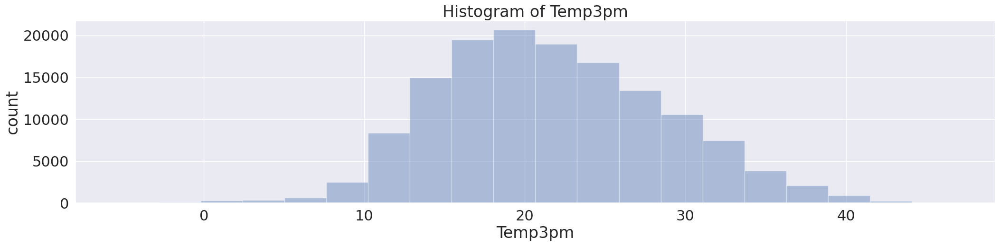

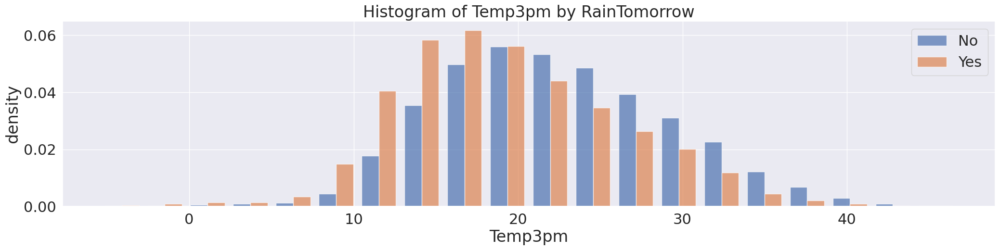

Kolmogorov-Smirnov Test: KstestResult(statistic=0.18817316499788067, pvalue=0.0, statistic_location=19.6, statistic_sign=-1)
Kruskal-Wallis Test: KruskalResult(statistic=5145.150223810217, pvalue=0.0)
Median (No): 21.7, Median (Yes): 18.6



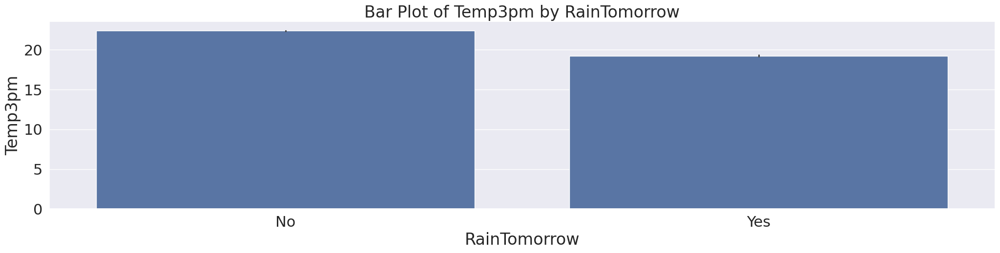

Rank-Sum Test: RanksumsResult(statistic=71.72881010490553, pvalue=0.0)
Mean (No): 22.389964704946987, Mean (Yes): 19.25498558885602



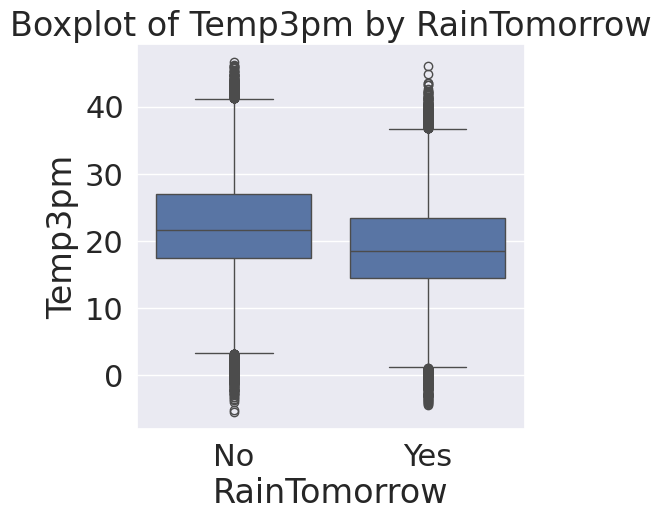

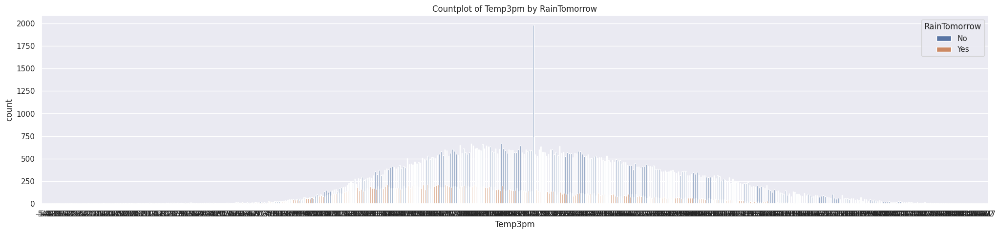

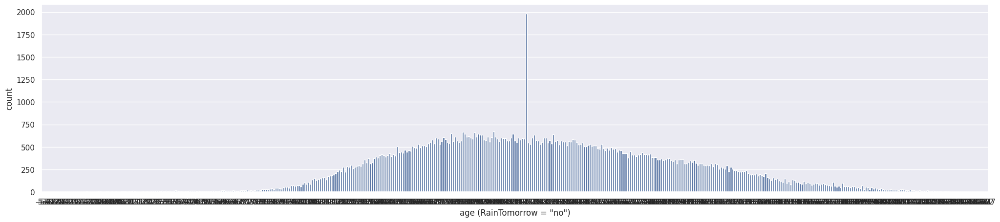

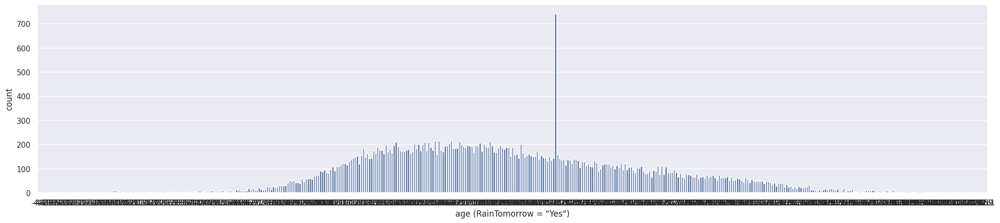

In [ ]:
univariate_analysis(continous_features[15], data=data)

In [ ]:
# For the historgram:
#There is no visual evidence of the normal distribution, so the option of using t- and z-tests to test statistically
# significant differences in middle age in different groups is no longer available.

# For Kolmogorov-Smirmov test:
# p-value is small so reject null hypotesis that these samples were taken from one distribution

# For kruskal test:
# The p-value is extremely small, so this is strong evidence to reject null hypotesis. These distributions of 'yes' and 'no' are significantly different

#For medians and Bar Plot:
#It is curious that here, according to the schedule, it seems like the average value of Temp3am is higher in the frist group, and not in the second.
#Also, the scatter of Temp3am in the first group is higher.

#Fro ranksums and means:
#Strangely enough, in spite of the small p-value, the real difference between the means is not very big.

#For Box-plot:
#Box-plot also does not show any significant displacement of one distribution relative to another.

#Nevertheless, it is evident that the second group has a flatter right tail (which, by the way, can explain why the average value in this group is higher).


In [ ]:
categorical_features = data.select_dtypes(include=['object', 'category', 'bool']).columns

In [ ]:
categorical_features

Index(['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm',
       'RainToday', 'RainTomorrow'],
      dtype='object')

In [ ]:
categorical_features= list(categorical_features)
categorical_features = categorical_features[:-1]
categorical_features

['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']

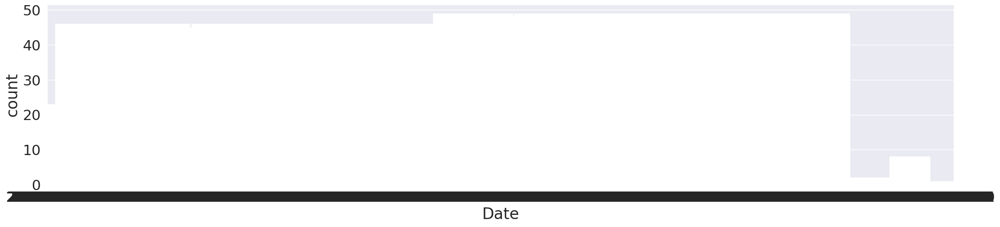

In [ ]:
plt.figure(figsize=(25, 5))
sns.countplot(x=categorical_features[0], data=data)
plt.show()


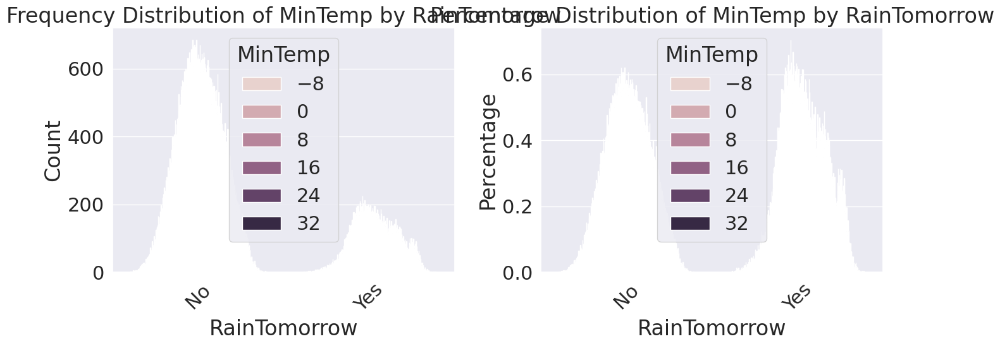

In [ ]:

grouped_counts = data.groupby('RainTomorrow')[continous_features[0]].value_counts().reset_index(name='Count')

grouped_counts['Percentage'] = (
    grouped_counts['Count'] / grouped_counts.groupby('RainTomorrow')['Count'].transform('sum')
) * 100

plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
sns.barplot(
    x='RainTomorrow',
    y='Count',
    hue=continous_features[0],
    data=grouped_counts
)
plt.title(f'Frequency Distribution of {continous_features[0]} by RainTomorrow')
plt.ylabel('Count')
plt.xlabel('RainTomorrow')
plt.legend(title=continous_features[0])
plt.xticks(rotation=45)

plt.subplot(1, 2, 2)
sns.barplot(
    x='RainTomorrow',
    y='Percentage',
    hue=continous_features[0],
    data=grouped_counts
)
plt.title(f'Percentage Distribution of {continous_features[0]} by RainTomorrow')
plt.ylabel('Percentage')
plt.xlabel('RainTomorrow')
plt.legend(title=continous_features[0])
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


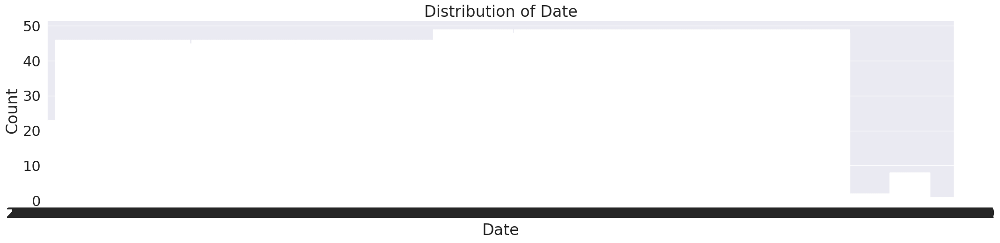

In [ ]:

# Set the figure size
plt.figure(figsize=(25, 5))

# Create a countplot with colors
sns.countplot(x=categorical_features[0], data=data, palette='Set2')  # Use a colormap like 'viridis', 'Set2', etc.

# Optionally, add a title and labels for clarity
plt.title('Distribution of ' + categorical_features[0])
plt.xlabel(categorical_features[0])
plt.ylabel('Count')

plt.show()

In [ ]:
categorical_features[1]

'Location'

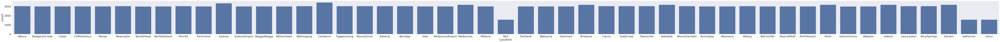

In [ ]:
plt.figure(figsize=(145, 5))
sns.countplot(x=categorical_features[1], data=data)
plt.show()

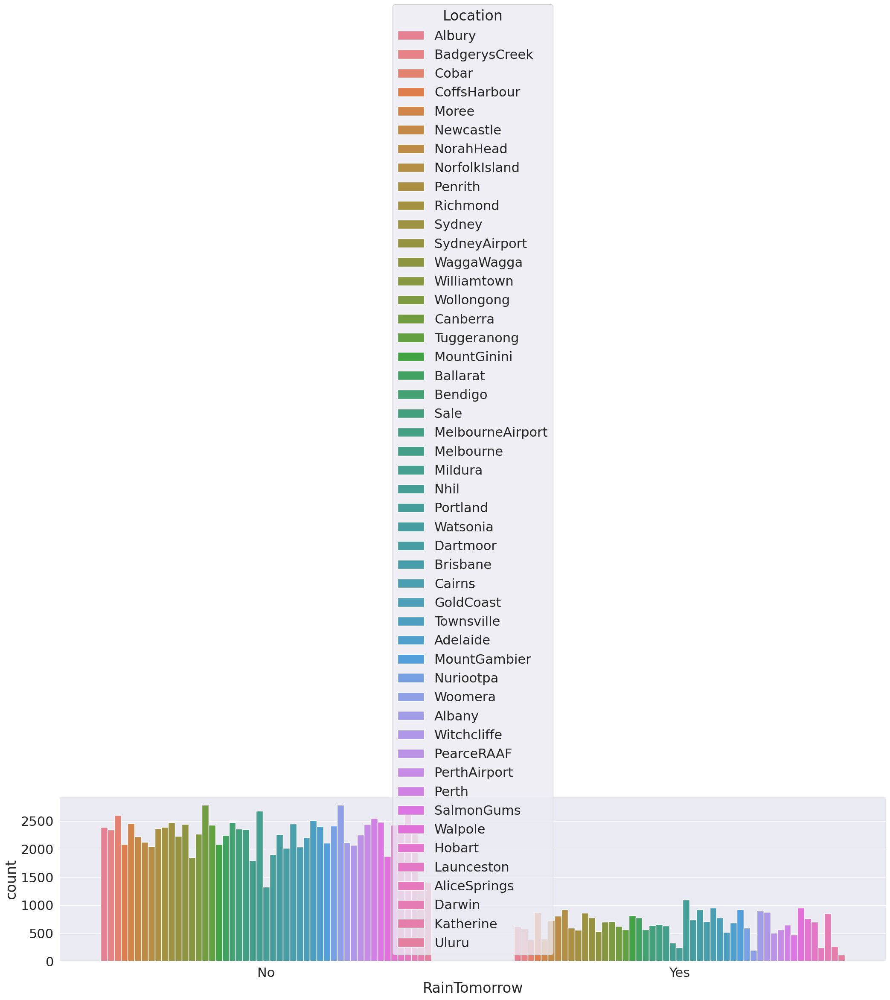

In [ ]:
plt.figure(figsize=(25, 5))
sns.countplot(x='RainTomorrow', hue=categorical_features[1], data=data)
plt.show()

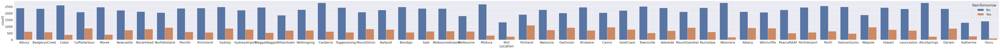

In [ ]:
plt.figure(figsize=(125, 5))
sns.countplot(x=categorical_features[1], hue='RainTomorrow', data=data)
plt.show()

In [ ]:
categorical_features[2]

'WindGustDir'

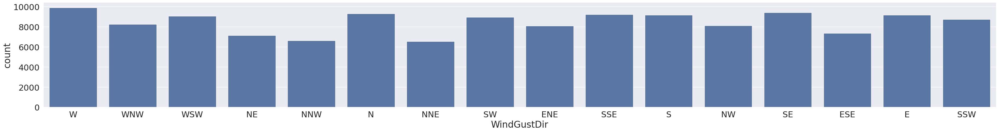

In [ ]:
plt.figure(figsize=(45, 5))
sns.countplot(x=categorical_features[2], data=data)
plt.show()


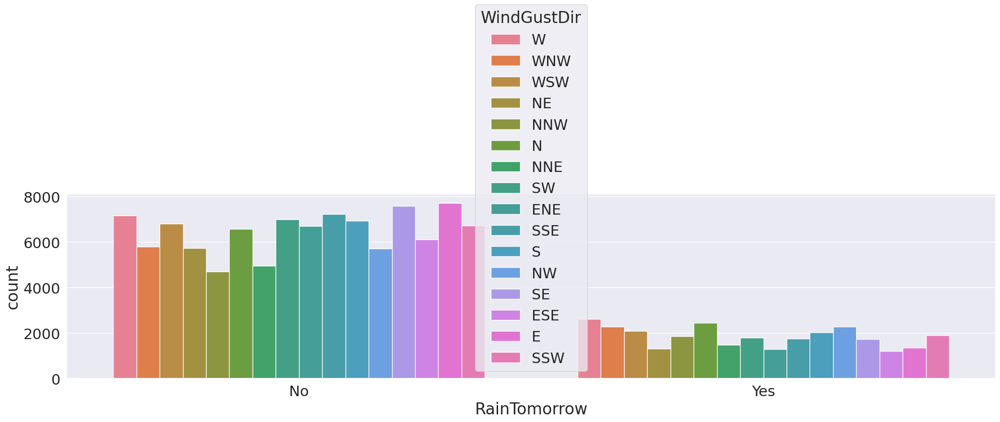

In [ ]:
plt.figure(figsize=(25, 5))
sns.countplot(x='RainTomorrow', hue=categorical_features[2], data=data)
plt.show()


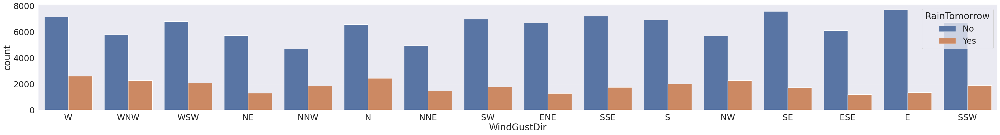

In [ ]:
plt.figure(figsize=(45, 5))
sns.countplot(x=categorical_features[2], hue='RainTomorrow', data=data)
plt.show()


In [ ]:
categorical_features[3]

'WindDir9am'

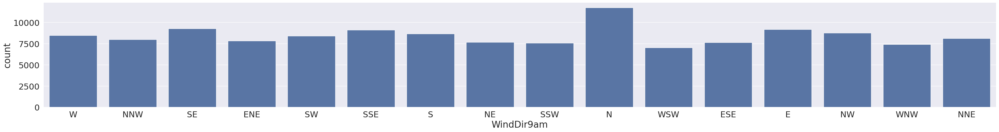

In [ ]:
plt.figure(figsize=(45, 5))
sns.countplot(x=categorical_features[3], data=data)
plt.show()


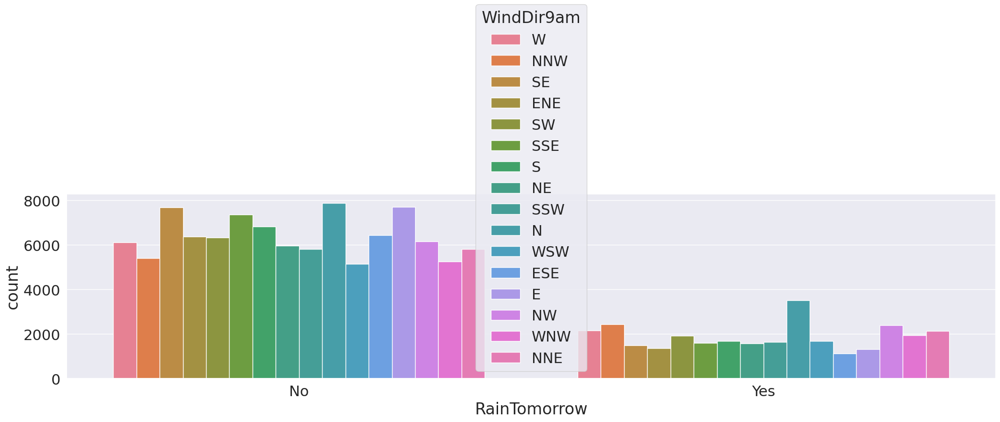

In [ ]:
plt.figure(figsize=(25, 5))
sns.countplot(x='RainTomorrow', hue=categorical_features[3], data=data)
plt.show()


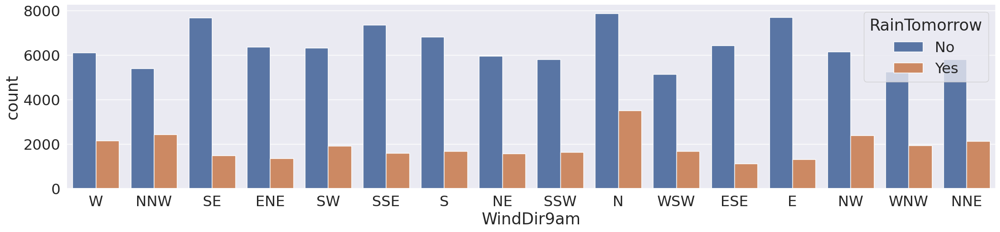

In [ ]:
plt.figure(figsize=(25, 5))
sns.countplot(x=categorical_features[3], hue='RainTomorrow', data=data)
plt.show()


In [ ]:
categorical_features[4]

'WindDir3pm'

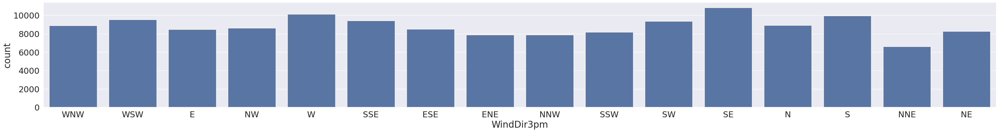

In [ ]:
plt.figure(figsize=(45, 5))
sns.countplot(x=categorical_features[4], data=data)
plt.show()


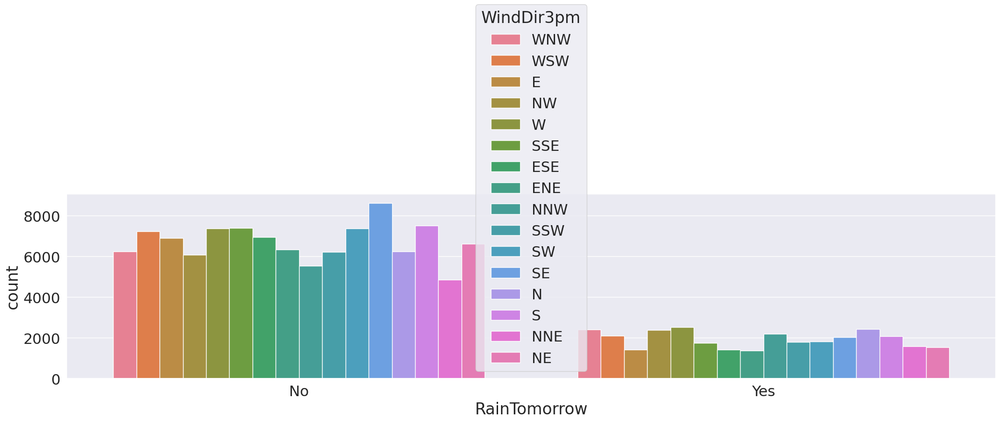

In [ ]:
plt.figure(figsize=(25, 5))
sns.countplot(x='RainTomorrow', hue=categorical_features[4], data=data)
plt.show()


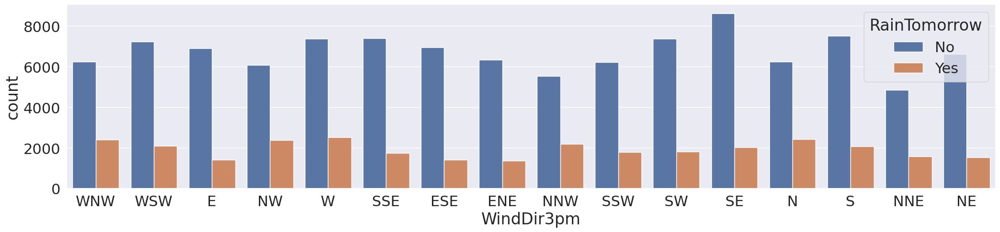

In [ ]:
plt.figure(figsize=(25, 5))
sns.countplot(x=categorical_features[4], hue='RainTomorrow', data=data)
plt.show()


In [ ]:
categorical_features[5]

'RainToday'

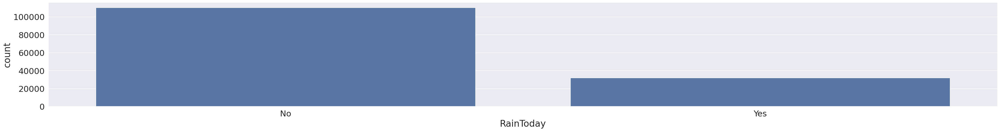

In [ ]:
plt.figure(figsize=(45, 5))
sns.countplot(x=categorical_features[5], data=data)
plt.show()


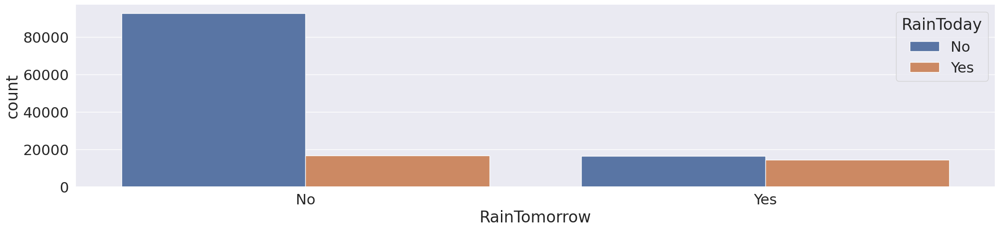

In [ ]:
plt.figure(figsize=(25, 5))
sns.countplot(x='RainTomorrow', hue=categorical_features[5], data=data)
plt.show()


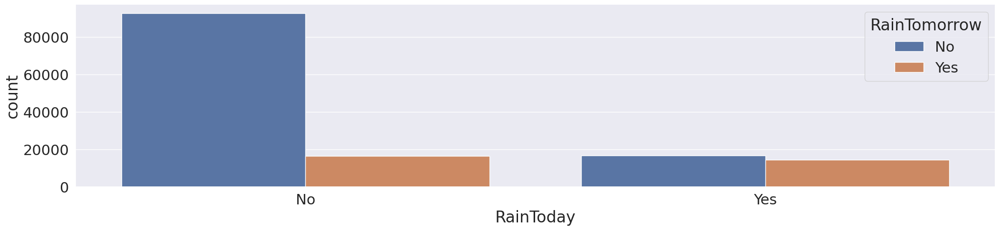

In [ ]:
plt.figure(figsize=(25, 5))
sns.countplot(x=categorical_features[5], hue='RainTomorrow', data=data)
plt.show()


In [ ]:
#Multivariate analysis

In [ ]:
#Peasron correlation coefficient

In [ ]:
pearson_corr_coef_matrix = data[continous_features].corr()

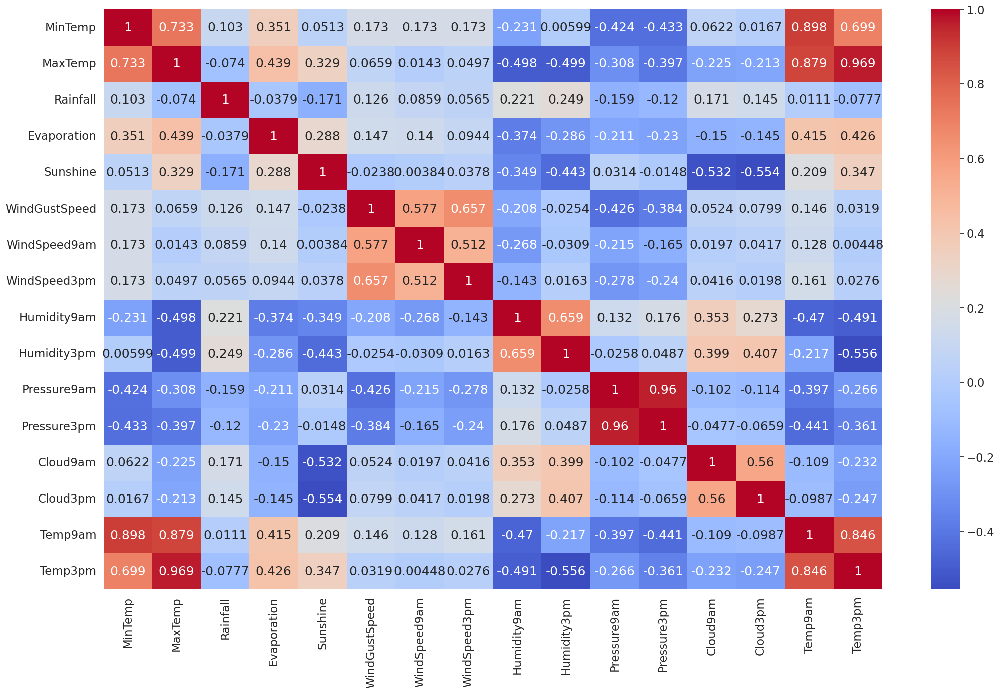

In [ ]:
plt.figure(figsize=(25, 15))
sns.heatmap(pearson_corr_coef_matrix, annot=True, cmap = 'coolwarm', fmt='.3g')
plt.show()

In [ ]:
# Spearman correlation coefficient

In [ ]:
spearman_corr_coef_matrix = data[continous_features].corr(method='spearman')

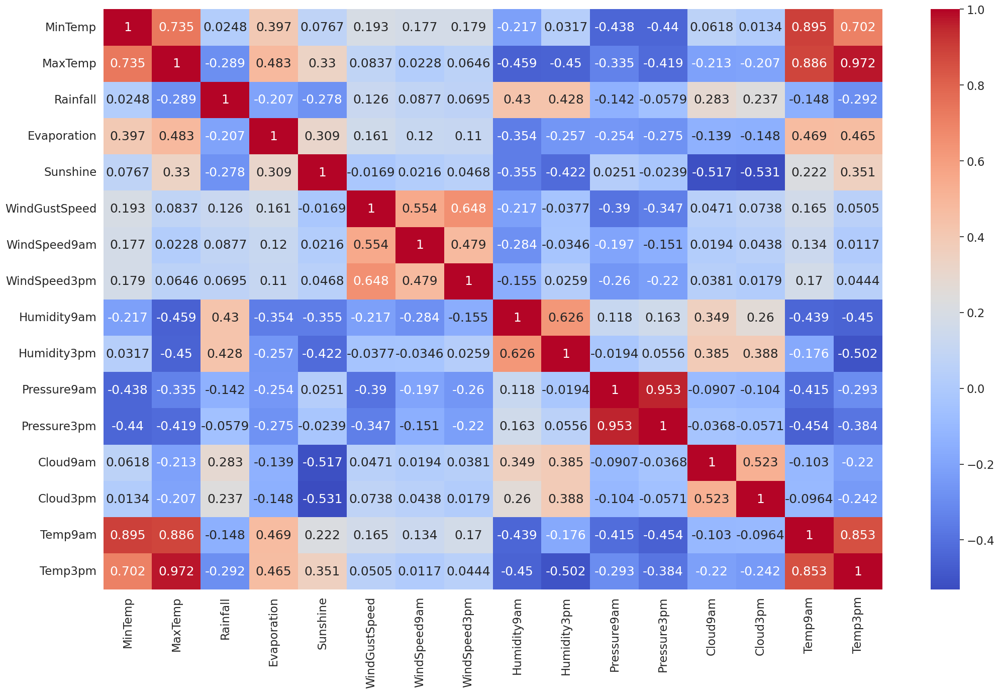

In [ ]:
plt.figure(figsize=(25, 15))
sns.heatmap(spearman_corr_coef_matrix, annot=True, cmap = 'coolwarm', fmt='.3g')
plt.show()

In [ ]:
# Kendall correlation coefficient

In [ ]:
kendall_corr_coef_matrix = data[continous_features].corr(method='kendall')

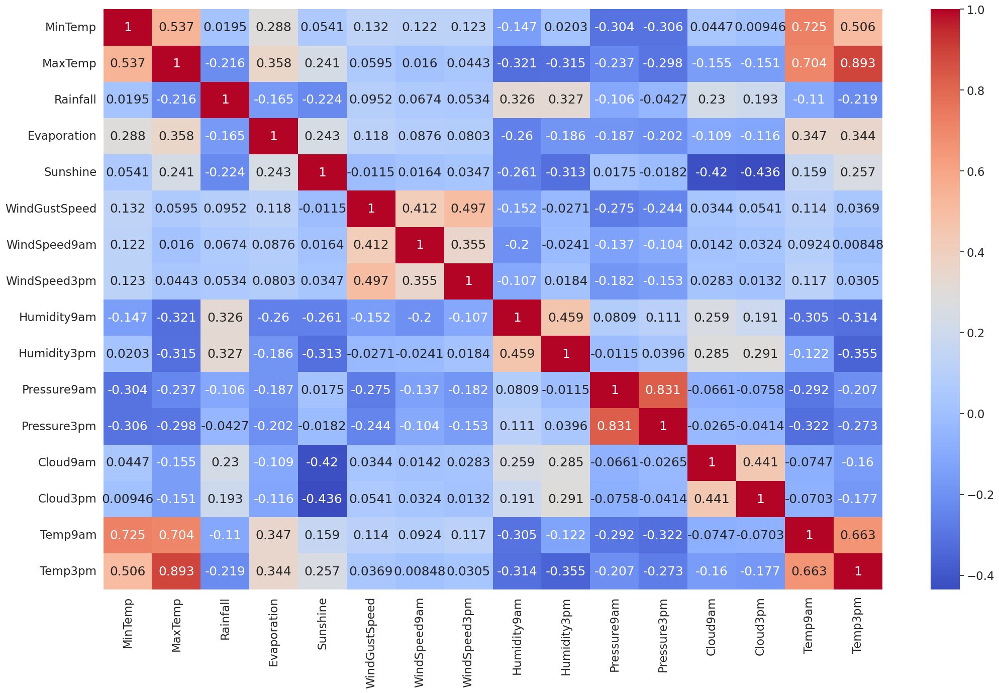

In [ ]:
plt.figure(figsize=(25, 15))
sns.heatmap(kendall_corr_coef_matrix, annot=True, cmap = 'coolwarm', fmt='.3g')
plt.show()

In [ ]:
# FaceGrid

In [ ]:
sns.set(font_scale=3)

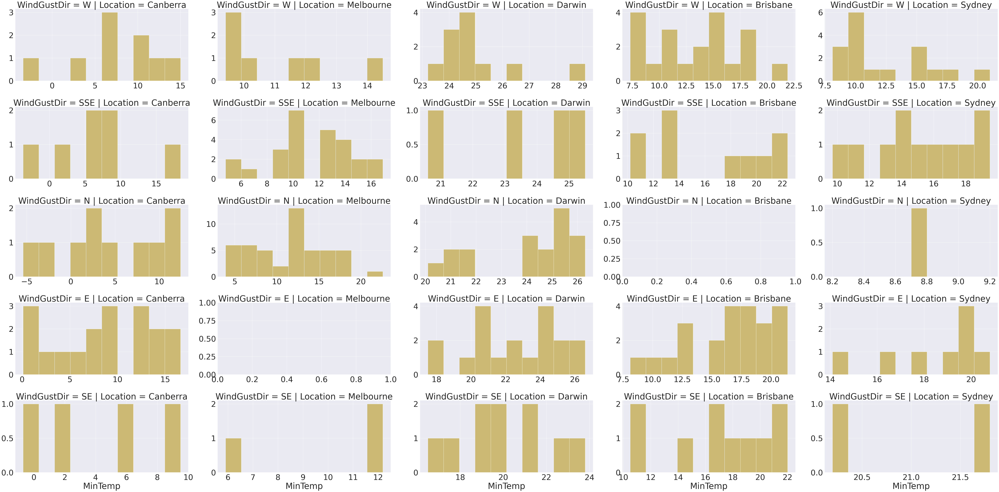

In [ ]:
# Fill NaN in all numerical columns with their respective mean
data = data.apply(lambda col: col.fillna(col.mean()) if col.dtype in ['float64', 'int64'] else col)


top_categories_1 = data[categorical_features[1]].value_counts().nlargest(5).index
top_categories_2 = data[categorical_features[2]].value_counts().nlargest(5).index

filtered_data = data[
    data[categorical_features[1]].isin(top_categories_1) &
    data[categorical_features[2]].isin(top_categories_2)
]

data_sampled = filtered_data.sample(frac=0.05, random_state=42)
# Plot
g = sns.FacetGrid(
    data_sampled,
    col=categorical_features[1],
    row=categorical_features[2],
    sharex=False,
    sharey=False,
    height=8,
    aspect=2
)
g = g.map(plt.hist, continous_features[0], color="y")
plt.show()


In [ ]:
g = sns.FacetGrid(
    data_sampled,
    col=categorical_features[1],
    row=categorical_features[2],
    sharex=False,
    sharey=False,
    height=14,
    aspect=1,
    hue='RainTomorrow'
)
g = (g.map(plt.hist, continous_features[0]).add_legend())
plt.show()

In [ ]:
sns.set(font_scale=4)

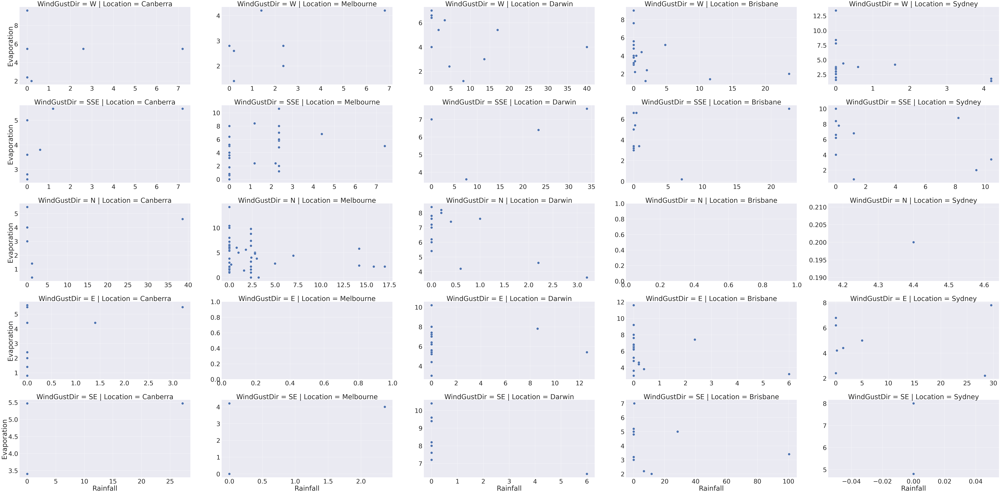

In [ ]:
g = sns.FacetGrid(
    data_sampled,
    col=categorical_features[1],
    row=categorical_features[2],
    sharex=False,
    sharey=False,
    height=10,
    aspect=2
)
g.map(plt.scatter, continous_features[2], continous_features[3], edgecolor="w", s=300)
plt.show()

In [ ]:
g = sns.FacetGrid(
    data_sampled,
    col=categorical_features[1],
    row=categorical_features[2],
    sharex=False,
    sharey=False,
    height=14,
    aspect=2,
    hue='RainTomorrow'
)
g.map(plt.scatter, continous_features[2], continous_features[3], edgecolor="w", s=300).add_legend()
plt.show()

In [ ]:
sns.set(font_scale=2)

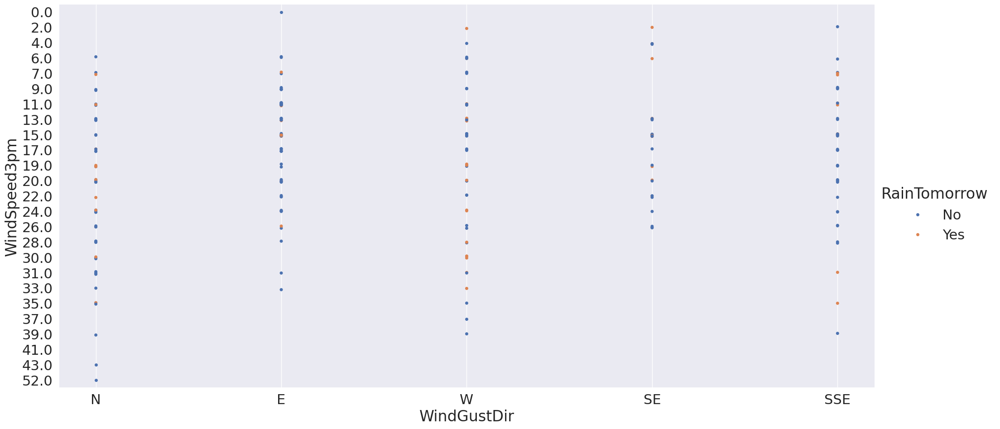

In [ ]:
g = sns.catplot(x=categorical_features[2], y=continous_features[7], hue="RainTomorrow", data=data_sampled, height=10, aspect=2, orient='h')
plt.show()

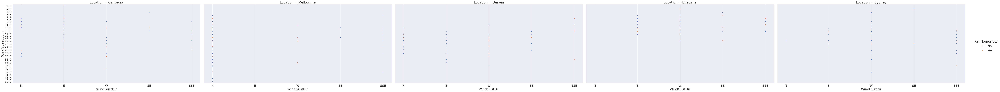

In [ ]:
g = sns.catplot(x=categorical_features[2], y=continous_features[7], hue="RainTomorrow", col=categorical_features[1], data=data_sampled, height=10, aspect=2, orient='h')
plt.show()

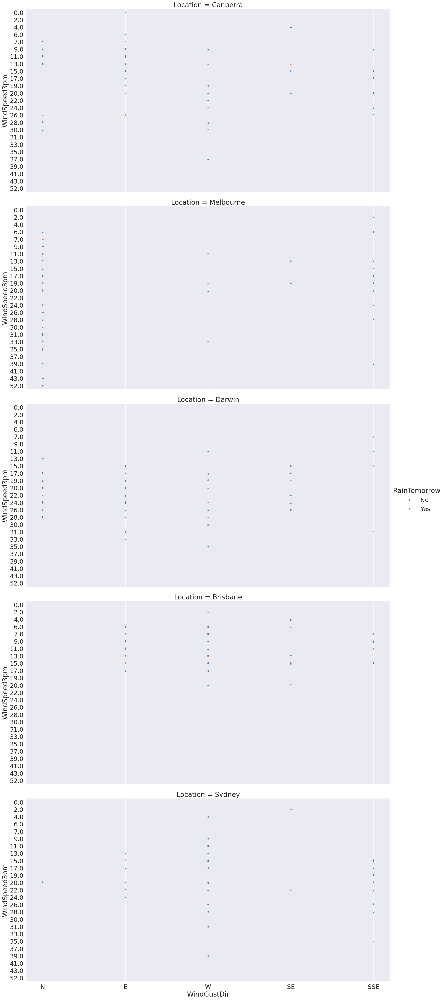

In [ ]:
g = sns.catplot(x=categorical_features[2], y=continous_features[7], hue="RainTomorrow", col=categorical_features[1], data=data_sampled, height=10, aspect=2, orient='h', col_wrap=1)
plt.show()

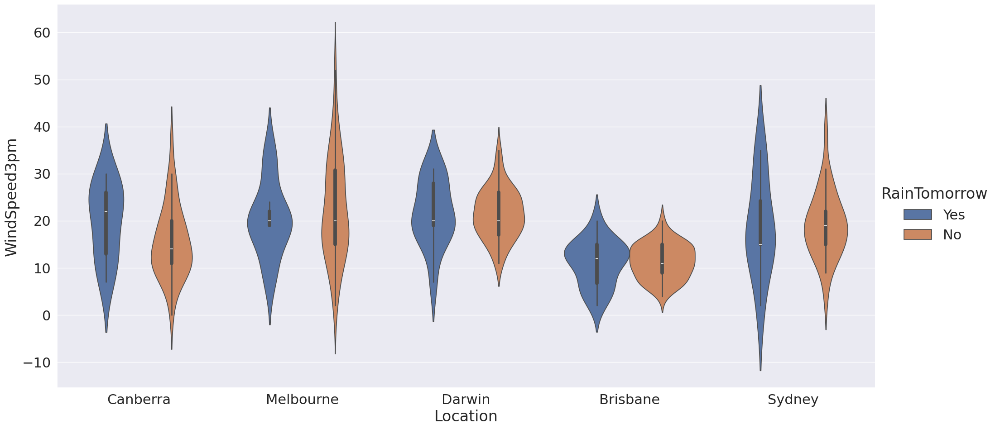

In [ ]:
g = sns.catplot(x=categorical_features[1], y=continous_features[7], hue="RainTomorrow", data=data_sampled, height=10, aspect=2, kind="violin")
plt.show()

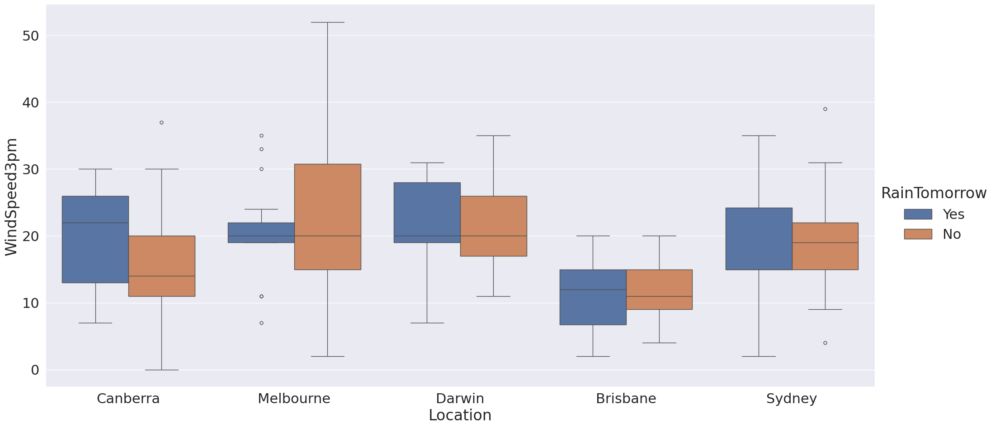

In [ ]:
g = sns.catplot(x=categorical_features[1], y=continous_features[7], hue="RainTomorrow", data=data_sampled, height=10, aspect=2, kind="box")
plt.show()

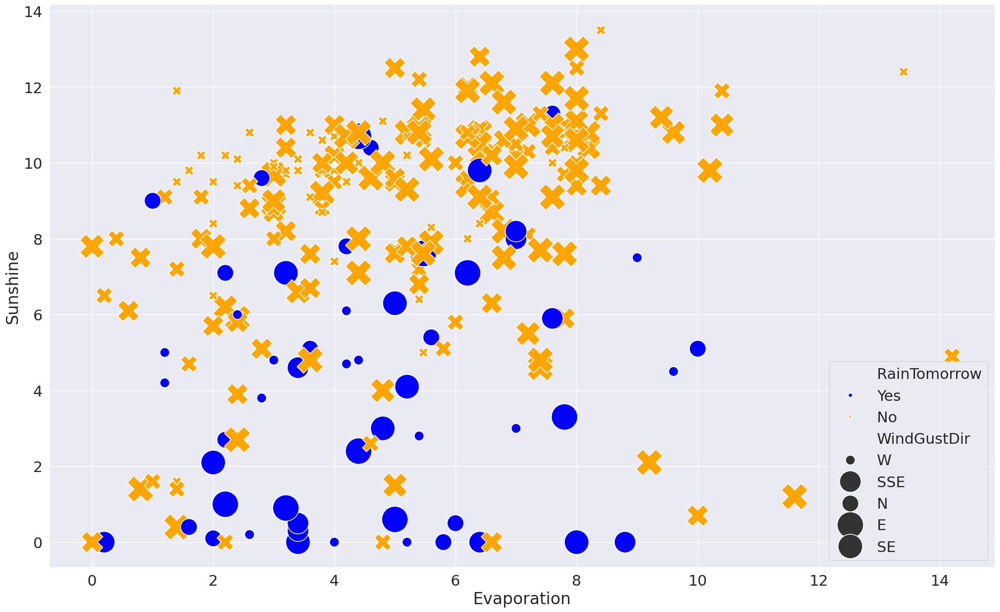

In [ ]:
rain_palette = {"Yes": "blue", "No": "orange"}
categories = data[categorical_features[2]].unique()
color_palette = sns.cubehelix_palette(n_colors=len(categories), dark=.3, light=.8)
palette_dict = {category: color for category, color in zip(categories, color_palette)}

plt.figure(figsize=(25, 15))

sns.scatterplot(
    x=continous_features[3],
    y=continous_features[4],
    hue="RainTomorrow",
    style="RainTomorrow",
    size=categorical_features[2],
    sizes={'W': 200, 'WNW': 300, 'NE': 400, 'NNW': 500, 'N': 600, 'NNE': 700,
           'SW': 800, 'ENE': 900, 'SSE': 1000, 'S': 1100, 'NW': 1200, 'SE': 1300,
           'ESE': 1400, 'E': 1500, 'SSW': 1600},
    palette=rain_palette,
    data=data_sampled
)

plt.show()


In [ ]:
# DATA PREPROCESSING

In [ ]:
data = pd.read_csv('weatherAUS.csv')

#No need to separate, dataset is reading correctly

In [ ]:
import os
import pandas as pd
import numpy as np

from sklearn.impute import SimpleImputer
from sklearn.impute import MissingIndicator

from sklearn.preprocessing import MaxAbsScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler

from sklearn.preprocessing import FunctionTransformer
from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import QuantileTransformer

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import LabelBinarizer
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import OrdinalEncoder


from imblearn.under_sampling import RandomUnderSampler
from imblearn.under_sampling import ClusterCentroids
from imblearn.under_sampling import NearMiss

from imblearn.over_sampling import RandomOverSampler
from imblearn.over_sampling import SMOTE
from imblearn.over_sampling import ADASYN

import matplotlib.pyplot as plt
import seaborn as sns


from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report


from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score, RocCurveDisplay
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import MinMaxScaler

from sklearn.model_selection import StratifiedKFold

from imblearn.under_sampling import RandomUnderSampler

from sklearn.metrics import f1_score, roc_curve, auc, precision_recall_curve

from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score




In [ ]:
columns_with_gaps = data.columns[:-1]

In [ ]:
columns_with_gaps

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday'],
      dtype='object')

In [ ]:
minimum = 0
maximum = 0.3

In [ ]:
columns_with_gaps_dict = dict(
    zip(
        columns_with_gaps,
        np.random.uniform(
            minimum,
            maximum,
            len(columns_with_gaps)
        )
    )
)

In [ ]:
columns_with_gaps_dict

{'Date': 0.08947009274456216,
 'Location': 0.25512876889008307,
 'MinTemp': 0.21621116082923472,
 'MaxTemp': 0.21409827978138085,
 'Rainfall': 0.06559963437868774,
 'Evaporation': 0.12130785962801494,
 'Sunshine': 0.2545492389205526,
 'WindGustDir': 0.02159928151845466,
 'WindGustSpeed': 0.09579906747897747,
 'WindDir9am': 0.002925589810346707,
 'WindDir3pm': 0.2837439968691914,
 'WindSpeed9am': 0.08896013152190996,
 'WindSpeed3pm': 0.05912772396590901,
 'Humidity9am': 0.1764292681158274,
 'Humidity3pm': 0.1921374045489445,
 'Pressure9am': 0.24609312953651125,
 'Pressure3pm': 0.28905735637124313,
 'Cloud9am': 0.03696183610830845,
 'Cloud3pm': 0.28854151772232356,
 'Temp9am': 0.22183881810737163,
 'Temp3pm': 0.28579964804228086,
 'RainToday': 0.07023926594529653}

In [ ]:
data_with_gaps_v1 = data.iloc[0:7000,:].copy()

In [ ]:
data_with_gaps_v1.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7000 entries, 0 to 6999
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           7000 non-null   object 
 1   Location       7000 non-null   object 
 2   MinTemp        6953 non-null   float64
 3   MaxTemp        6960 non-null   float64
 4   Rainfall       6886 non-null   float64
 5   Evaporation    935 non-null    float64
 6   Sunshine       550 non-null    float64
 7   WindGustDir    6879 non-null   object 
 8   WindGustSpeed  6879 non-null   float64
 9   WindDir9am     6034 non-null   object 
 10  WindDir3pm     6867 non-null   object 
 11  WindSpeed9am   6938 non-null   float64
 12  WindSpeed3pm   6940 non-null   float64
 13  Humidity9am    6934 non-null   float64
 14  Humidity3pm    6936 non-null   float64
 15  Pressure9am    6820 non-null   float64
 16  Pressure3pm    6816 non-null   float64
 17  Cloud9am       2226 non-null   float64
 18  Cloud3pm

In [ ]:

numerical_features = data.select_dtypes(include=['int64', 'float64']).columns.tolist()

categorical_features = data.select_dtypes(include=['object', 'category']).columns.tolist()

categorical_features.remove('RainTomorrow')
print("Numerical Features:", numerical_features)
print("Categorical Features:", categorical_features)


Numerical Features: ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']
Categorical Features: ['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']


In [ ]:
median_imputer = SimpleImputer(
    missing_values=np.nan,
    strategy='median',
)

In [ ]:
#The median is less affected by skewed distributions and extreme values,
# making it a safer choice for non-normally distributed data and number of missing values is small

In [ ]:
constant_imputer = SimpleImputer(
    missing_values=np.nan,
    strategy='constant',
    fill_value='unknown',
)

In [ ]:
# Classic for constant

16

In [ ]:
numericals_with_median_imputed = pd.DataFrame(
    median_imputer.fit_transform(data_with_gaps_v1[numerical_features]),
    columns=numerical_features
)

In [ ]:
numericals_with_median_imputed.describe().T

,count,mean,std,min,25%,50%,75%,max
MinTemp,145460.0,12.192053,6.365780,-8.5,7.7,12.0,16.8,33.9
MaxTemp,145460.0,23.215962,7.088358,-4.8,18.0,22.6,28.2,48.1
Rainfall,145460.0,2.307990,8.389771,0.0,0.0,0.0,0.6,371.0
Evaporation,145460.0,5.179779,3.178819,0.0,4.0,4.8,5.2,145.0
Sunshine,145460.0,7.989889,2.757790,0.0,8.2,8.4,8.7,14.5
WindGustSpeed,145460.0,39.962189,13.120931,6.0,31.0,39.0,46.0,135.0
WindSpeed9am,145460.0,14.030751,8.861796,0.0,7.0,13.0,19.0,130.0
WindSpeed3pm,145460.0,18.669758,8.716716,0.0,13.0,19.0,24.0,87.0
Humidity9am,145460.0,68.901251,18.855360,0.0,57.0,70.0,83.0,100.0
Humidity3pm,145460.0,51.553396,20.471345,0.0,37.0,52.0,65.0,100.0


In [ ]:
numericals_with_median_imputed.head().T

,0,1,2,3,4
MinTemp,13.4,7.4,12.9,9.2,17.5
MaxTemp,22.9,25.1,25.7,28.0,32.3
Rainfall,0.6,0.0,0.0,0.0,1.0
Evaporation,4.8,4.8,4.8,4.8,4.8
Sunshine,8.4,8.4,8.4,8.4,8.4
WindGustSpeed,44.0,44.0,46.0,24.0,41.0
WindSpeed9am,20.0,4.0,19.0,11.0,7.0
WindSpeed3pm,24.0,22.0,26.0,9.0,20.0
Humidity9am,71.0,44.0,38.0,45.0,82.0
Humidity3pm,22.0,25.0,30.0,16.0,33.0


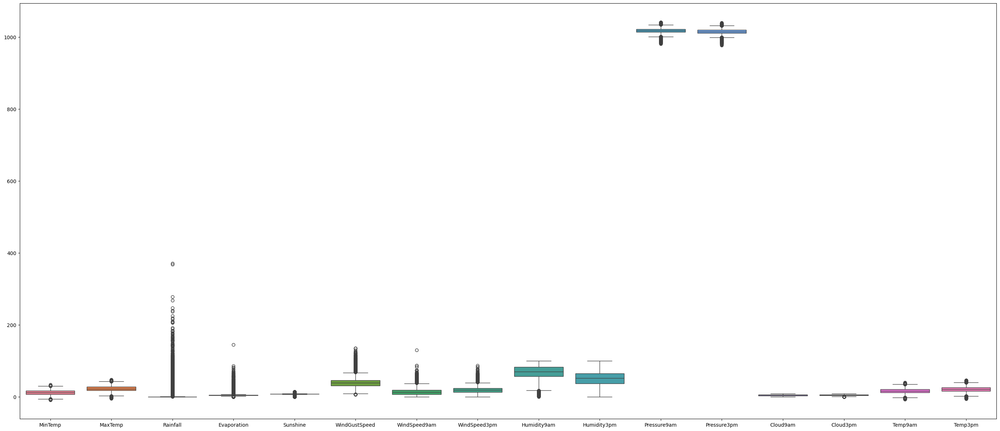

In [ ]:
plt.figure(figsize=(35, 15))
sns.boxplot(data=numericals_with_median_imputed)
plt.show()

In [ ]:
categorials_with_constant_imputed = pd.DataFrame(
    constant_imputer.fit_transform(data_with_gaps_v1[categorical_features]),
    columns=categorical_features
)

In [ ]:
categorials_with_constant_imputed[categorical_features[0]].value_counts()

,count
Date,
2010-12-07,3
2010-09-08,3
2010-09-10,3
2010-09-11,3
2010-09-12,3
...,...
2008-12-27,1
2008-12-28,1
2008-12-29,1


In [ ]:
categorials_with_constant_imputed.head()

,Date,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday
0,2008-12-01,Albury,W,W,WNW,No
1,2008-12-02,Albury,WNW,NNW,WSW,No
2,2008-12-03,Albury,WSW,W,WSW,No
3,2008-12-04,Albury,NE,SE,E,No
4,2008-12-05,Albury,W,ENE,NW,No


In [ ]:
robust_scaler = RobustScaler()

In [ ]:
# It is the  best option because it is robust to outliers and works well for non-normally distributed data.
# It doesn't make strong assumptions about the distribution and can handle both negative and positive values effectively.

In [ ]:
numericals_with_median_imputed_robust_scaled = pd.DataFrame(
    robust_scaler.fit_transform(numericals_with_median_imputed),
    columns=numerical_features
)

In [ ]:
# I used this because it is good when you have features that already have a meaningful range or when you're working with data that has both positive and negative values

In [ ]:
numericals_with_median_imputed_robust_scaled.describe().T

,count,mean,std,min,25%,50%,75%,max
MinTemp,7000.0,0.026940,0.620302,-1.367347,-0.469388,0.0,0.530612,1.908163
MaxTemp,7000.0,0.062089,0.661467,-1.490741,-0.462963,0.0,0.537037,2.175926
Rainfall,7000.0,9.566571,32.680656,0.000000,0.000000,0.0,1.000000,580.000000
Evaporation,7000.0,0.160100,1.701855,-4.800000,0.000000,0.0,0.000000,60.000000
Sunshine,7000.0,-0.096300,1.077665,-9.900000,0.000000,0.0,0.000000,3.800000
WindGustSpeed,7000.0,0.152143,0.752072,-1.411765,-0.411765,0.0,0.588235,4.470588
WindSpeed9am,7000.0,0.199810,0.757187,-0.777778,-0.333333,0.0,0.666667,4.555556
WindSpeed3pm,7000.0,0.110429,0.723687,-1.300000,-0.400000,0.0,0.600000,4.300000
Humidity9am,7000.0,-0.067101,0.680897,-2.555556,-0.555556,0.0,0.444444,0.925926
Humidity3pm,7000.0,0.072854,0.781372,-1.782178,-0.475248,0.0,0.524752,2.138614


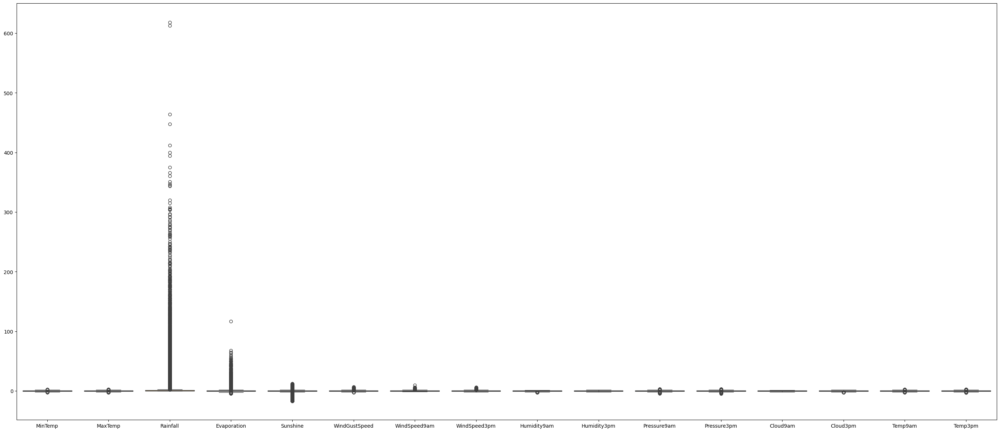

In [ ]:
plt.figure(figsize=(35, 15))
sns.boxplot(data=numericals_with_median_imputed_robust_scaled)
plt.show()

In [ ]:
function_transformer = FunctionTransformer()

In [ ]:
numericals_with_median_imputed_robust_scaled

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,0.153846,0.029412,1.000000,0.0,0.0,0.333333,0.583333,0.454545,0.038462,-1.071429,-1.192771,-0.975904,1.000000,0.0,0.021739,0.073684
1,-0.505495,0.245098,0.000000,0.0,0.0,0.333333,-0.750000,0.272727,-1.000000,-0.964286,-0.843373,-0.891566,0.000000,0.0,0.054348,0.336842
2,0.098901,0.303922,0.000000,0.0,0.0,0.466667,0.500000,0.636364,-1.230769,-0.785714,-1.204819,-0.783133,0.000000,-1.5,0.467391,0.221053
3,-0.307692,0.529412,0.000000,0.0,0.0,-1.000000,-0.166667,-0.909091,-0.961538,-1.285714,0.000000,-0.289157,0.000000,0.0,0.152174,0.568421
4,0.604396,0.950980,1.666667,0.0,0.0,0.133333,-0.500000,0.090909,0.461538,-0.678571,-0.819277,-1.108434,0.666667,1.5,0.119565,0.905263
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145455,-1.010989,0.078431,0.000000,0.0,0.0,-0.533333,0.000000,-0.727273,-0.730769,-1.000000,0.843373,0.614458,0.000000,0.0,-0.717391,0.136842
145456,-0.923077,0.264706,0.000000,0.0,0.0,-1.133333,0.000000,-0.909091,-0.538462,-1.107143,0.710843,0.469880,0.000000,0.0,-0.630435,0.357895
145457,-0.725275,0.421569,0.000000,0.0,0.0,-0.133333,-0.333333,-0.909091,-0.653846,-1.000000,0.409639,0.192771,0.000000,0.0,-0.456522,0.526316
145458,-0.461538,0.431373,0.000000,0.0,0.0,-0.733333,0.000000,-1.090909,-0.730769,-1.000000,0.216867,0.156627,-0.666667,-1.5,-0.173913,0.515789


In [ ]:
numericals_with_mean_imputed_max_abs_scaled_transformed = pd.DataFrame(
    function_transformer.fit_transform(numericals_with_median_imputed_robust_scaled),
    columns=numerical_features
)

In [ ]:
# Normalization

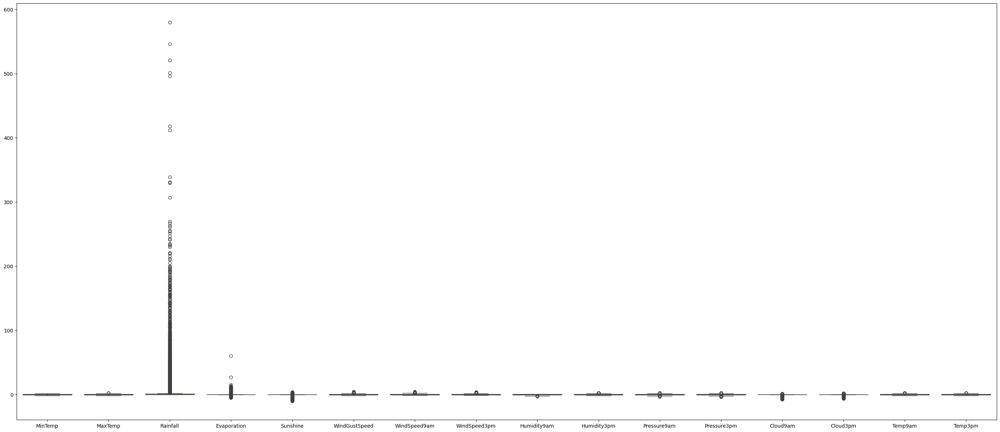

In [ ]:
plt.figure(figsize=(35, 15))
sns.boxplot(data=numericals_with_mean_imputed_max_abs_scaled_transformed)
plt.show()

In [ ]:
one_hot_encoder = OneHotEncoder()

In [ ]:
categorials_with_constant_imputed.head().T

,0,1,2,3,4
Date,2008-12-01,2008-12-02,2008-12-03,2008-12-04,2008-12-05
Location,Albury,Albury,Albury,Albury,Albury
WindGustDir,W,WNW,WSW,NE,W
WindDir9am,W,NNW,W,SE,ENE
WindDir3pm,WNW,WSW,WSW,E,NW
RainToday,No,No,No,No,No


In [ ]:
categorials_with_constant_imputed_one_hot_encoded = one_hot_encoder.fit_transform(categorials_with_constant_imputed)

In [ ]:
categorials_with_constant_imputed_one_hot_encoded.shape

(145460, 3539)

In [ ]:
categorials_with_constant_imputed_one_hot_encoded.todense()

matrix([[0., 0., 0., ..., 1., 0., 0.],
        [0., 0., 0., ..., 1., 0., 0.],
        [0., 0., 0., ..., 1., 0., 0.],
        ...,
        [0., 0., 0., ..., 1., 0., 0.],
        [0., 0., 0., ..., 1., 0., 0.],
        [0., 0., 0., ..., 1., 0., 0.]])

In [ ]:
categorials_with_constant_imputed_one_hot_encoded = pd.DataFrame(
    categorials_with_constant_imputed_one_hot_encoded.todense(),
    columns=one_hot_encoder.get_feature_names_out()
)

In [ ]:
categorials_with_constant_imputed_one_hot_encoded.head().T

,0,1,2,3,4
Date_2007-11-01,0.0,0.0,0.0,0.0,0.0
Date_2007-11-02,0.0,0.0,0.0,0.0,0.0
Date_2007-11-03,0.0,0.0,0.0,0.0,0.0
Date_2007-11-04,0.0,0.0,0.0,0.0,0.0
Date_2007-11-05,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...
WindDir3pm_WSW,0.0,1.0,1.0,0.0,0.0
WindDir3pm_unknown,0.0,0.0,0.0,0.0,0.0
RainToday_No,1.0,1.0,1.0,1.0,1.0
RainToday_Yes,0.0,0.0,0.0,0.0,0.0


In [ ]:
one_hot_encoder.categories_

[array(['2008-12-01', '2008-12-02', '2008-12-03', ..., '2017-06-23',
        '2017-06-24', '2017-06-25'], dtype=object),
 array(['Albury', 'BadgerysCreek', 'Cobar'], dtype=object),
 array(['E', 'ENE', 'ESE', 'N', 'NE', 'NNE', 'NNW', 'NW', 'S', 'SE', 'SSE',
        'SSW', 'SW', 'W', 'WNW', 'WSW', 'unknown'], dtype=object),
 array(['E', 'ENE', 'ESE', 'N', 'NE', 'NNE', 'NNW', 'NW', 'S', 'SE', 'SSE',
        'SSW', 'SW', 'W', 'WNW', 'WSW', 'unknown'], dtype=object),
 array(['E', 'ENE', 'ESE', 'N', 'NE', 'NNE', 'NNW', 'NW', 'S', 'SE', 'SSE',
        'SSW', 'SW', 'W', 'WNW', 'WSW', 'unknown'], dtype=object),
 array(['No', 'Yes', 'unknown'], dtype=object)]

In [ ]:
# I just made a unknown a new column

In [ ]:
target = data.iloc[0:7000,:].dropna(subset=['RainTomorrow'])

label_encoder = LabelEncoder()
preprocessed_target = label_encoder.fit_transform(target['RainTomorrow'])
preprocessed_target


array([0, 0, 0, ..., 0, 0, 1])

In [ ]:

numericals_with_mean_imputed_max_abs_scaled_transformed = pd.DataFrame(numericals_with_mean_imputed_max_abs_scaled_transformed)
categorials_with_constant_imputed_one_hot_encoded = pd.DataFrame(categorials_with_constant_imputed_one_hot_encoded)
preprocessed_target = pd.DataFrame(preprocessed_target, columns=['RainTomorrow'])



print(len(categorials_with_constant_imputed_one_hot_encoded))
print(len(preprocessed_target))
preprocessed_data = pd.concat([numericals_with_mean_imputed_max_abs_scaled_transformed,
                                categorials_with_constant_imputed_one_hot_encoded,preprocessed_target], axis=1)


7000
6886


In [ ]:
preprocessed_data.head()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,WindDir3pm_unknown,RainToday_No,RainToday_Yes,RainToday_unknown
0,0.306122,0.000000,3.0,0.0,0.0,0.764706,1.444444,1.1,-0.148148,-0.950495,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1,-0.306122,0.203704,0.0,0.0,0.0,0.764706,-0.333333,0.9,-1.148148,-0.831683,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
2,0.255102,0.259259,0.0,0.0,0.0,0.882353,1.333333,1.3,-1.370370,-0.633663,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
3,-0.122449,0.472222,0.0,0.0,0.0,-0.411765,0.444444,-0.4,-1.111111,-1.188119,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0.724490,0.870370,5.0,0.0,0.0,0.588235,0.000000,0.7,0.259259,-0.514851,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [ ]:
def train_and_evaluate_model(train,model,preprocessed_target, test_size=0.2, random_state=42):

    train = train[: len(preprocessed_target)]

    preprocessed_target = pd.DataFrame(preprocessed_target, columns=['RainTomorrow'])
    train_X, train_y = train.drop('RainTomorrow', axis = 1),preprocessed_target

    X_train, X_test, y_train, y_test = train_test_split(train_X, train_y, test_size=test_size, random_state=42)

    scaler = MinMaxScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    return [y_pred, y_test,X_test_scaled,X_train]

In [ ]:
train, test = preprocessed_data, preprocessed_data

In [ ]:
log_reg = LogisticRegression(random_state=42)

y_pred, y_test,X_test_scaled,X_train = train_and_evaluate_model(train,log_reg,preprocessed_target)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [ ]:

roc_auc = roc_auc_score(y_test, y_pred)
print(f"AUC-ROC Score: {roc_auc:.2f}")
print(f"Accuracy: {accuracy * 100:.2f}%")
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))
print("Classification Report:")
print(classification_report(y_test, y_pred))

AUC-ROC Score: 0.50
Accuracy: 69.30%
Confusion Matrix:
[[1122    2]
 [ 254    0]]
Classification Report:
              precision    recall  f1-score   support

           0       0.82      1.00      0.90      1124
           1       0.00      0.00      0.00       254

    accuracy                           0.81      1378
   macro avg       0.41      0.50      0.45      1378
weighted avg       0.67      0.81      0.73      1378



In [ ]:
# Hyperparameter tuning

In [ ]:
# Metrics chosen as well as reasoning behind each metric

In [ ]:
# My primary metric is AUC-ROC because
# helps assess how well the model distinguishes between classes across various thresholds. It’s a more robust metric than accuracy in the case of class imbalance.
# My complementary metric is f1-score

In [ ]:
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],  # Regularization strength
    'penalty': ['l2'],  # Regularization type (l1 and elasticnet are not available for all solvers)
    'solver': ['liblinear', 'saga'],  # Solvers to use
}

gs = GridSearchCV(estimator=log_reg, param_grid=param_grid,
                           scoring='accuracy', cv=5, n_jobs=-1, verbose=1)

In [ ]:
gs.fit(X_train_scaled, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


GridSearchCV(cv=5, estimator=LogisticRegression(random_state=42), n_jobs=-1,
             param_grid={'C': [0.01, 0.1, 1, 10, 100], 'penalty': ['l2'],
                         'solver': ['liblinear', 'saga']},
             scoring='accuracy', verbose=1)

In [ ]:

best_model = gs.best_estimator_

y_pred = best_model.predict(X_test_scaled)
roc_auc = roc_auc_score(y_test, y_pred)
print(f"AUC-ROC Score: {roc_auc:.2f}")
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy * 100:.2f}%")
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))
print("Classification Report:")
print(classification_report(y_test, y_pred))

AUC-ROC Score: 0.50
Accuracy: 81.57%
Confusion Matrix:
[[1124    0]
 [ 254    0]]
Classification Report:
              precision    recall  f1-score   support

           0       0.82      1.00      0.90      1124
           1       0.00      0.00      0.00       254

    accuracy                           0.82      1378
   macro avg       0.41      0.50      0.45      1378
weighted avg       0.67      0.82      0.73      1378



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
# So ROC- AUC and f1-score didnt changed at all

In [ ]:
#Feature importance and Coefficients

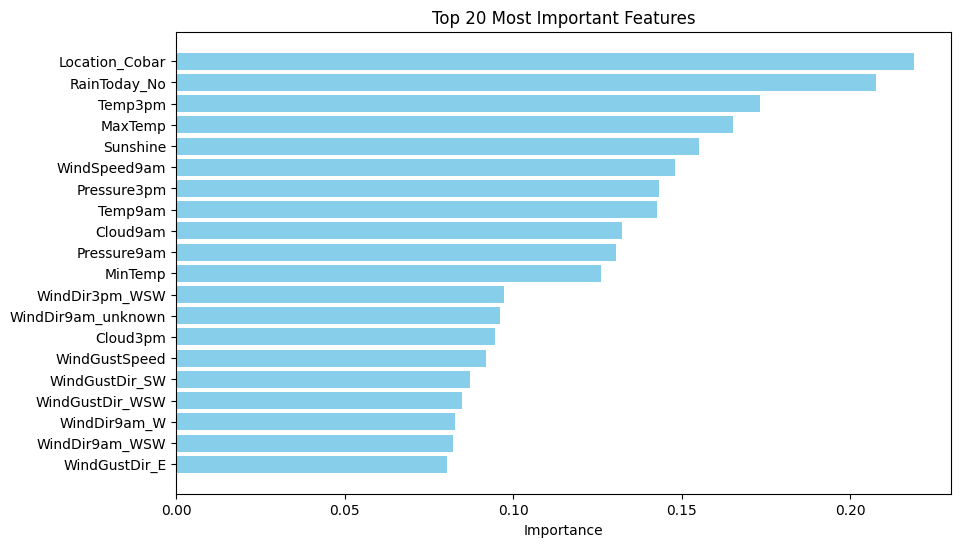

In [ ]:
coefficients = best_model.coef_[0]
features = X_train.columns


coef_df = pd.DataFrame({'Feature': features, 'Coefficient': coefficients})
coef_df['Importance'] = abs(coef_df['Coefficient'])

top_n = 20

# Sort by importance and take top N features
coef_df.sort_values(by='Importance', ascending=False, inplace=True)
top_coef_df = coef_df.head(top_n)

# Plot the top N important features
plt.figure(figsize=(10, 6))
plt.barh(top_coef_df['Feature'], top_coef_df['Importance'], color='skyblue')
plt.title(f'Top {top_n} Most Important Features')
plt.xlabel('Importance')
plt.gca().invert_yaxis()
plt.show()


In [ ]:
# The most important feature is Location_cobar

In [ ]:
# Threshold analysis

Optimal Threshold (based on F1-score): 0.0
F1-score at optimal threshold: 0.3112745098039216


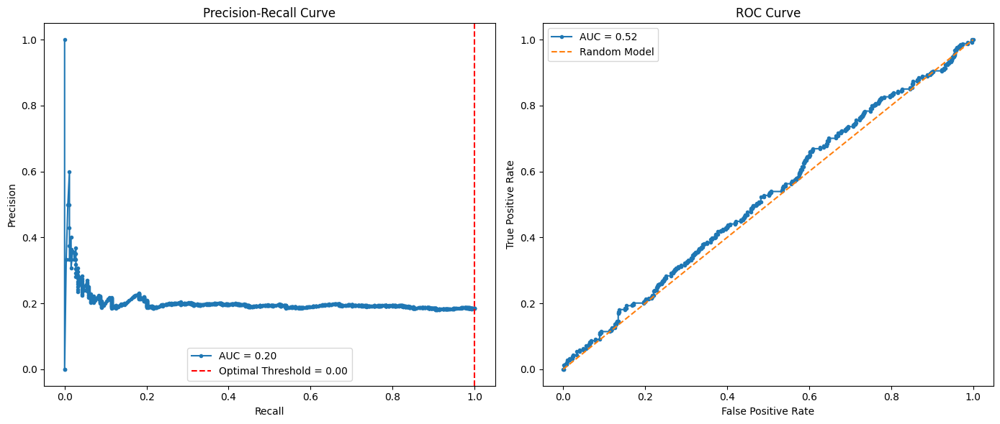

In [ ]:

y_prob = best_model.predict_proba(X_test_scaled)[:, 1]

thresholds = np.arange(0.0, 1.1, 0.1)

f1_scores = []

for threshold in thresholds:
    y_pred_threshold = (y_prob >= threshold).astype(int)
    f1_scores.append(f1_score(y_test, y_pred_threshold))

optimal_threshold = thresholds[np.argmax(f1_scores)]
optimal_f1 = np.max(f1_scores)

print(f"Optimal Threshold (based on F1-score): {optimal_threshold}")
print(f"F1-score at optimal threshold: {optimal_f1}")

fpr, tpr, thresholds_roc = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

precision, recall, thresholds_pr = precision_recall_curve(y_test, y_prob)

plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
plt.plot(recall, precision, marker='.', label=f'AUC = {auc(recall, precision):.2f}')
plt.title('Precision-Recall Curve')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.axvline(x=recall[np.argmax(f1_scores)], color='r', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.2f}')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(fpr, tpr, marker='.', label=f'AUC = {roc_auc:.2f}')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random Model')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()

plt.tight_layout()
plt.show()


In [ ]:
# K-Nearest Neighbors (KNN)

knn = KNeighborsClassifier(n_neighbors=5)

y_pred, y_test,X_test_scaled,X_train = train_and_evaluate_model(train,knn,preprocessed_target)


/usr/local/lib/python3.10/dist-packages/sklearn/neighbors/_classification.py:238: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


In [ ]:

roc_auc = roc_auc_score(y_test, y_pred)
print(f"AUC-ROC Score: {roc_auc:.2f}")
print(f"Accuracy: {accuracy * 100:.2f}%")
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))
print("Classification Report:")
print(classification_report(y_test, y_pred))


AUC-ROC Score: 0.49
Accuracy: 81.57%
Confusion Matrix:
[[1054   70]
 [ 241   13]]
Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.94      0.87      1124
           1       0.16      0.05      0.08       254

    accuracy                           0.77      1378
   macro avg       0.49      0.49      0.47      1378
weighted avg       0.69      0.77      0.73      1378



In [ ]:
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'penalty': ['l2'],
    'solver': ['liblinear', 'saga'],
}

gs = GridSearchCV(estimator=log_reg, param_grid=param_grid,
                           scoring='accuracy', cv=5, n_jobs=-1, verbose=1)
gs.fit(X_train_scaled, y_train)


Fitting 5 folds for each of 10 candidates, totalling 50 fits


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


GridSearchCV(cv=5, estimator=LogisticRegression(random_state=42), n_jobs=-1,
             param_grid={'C': [0.01, 0.1, 1, 10, 100], 'penalty': ['l2'],
                         'solver': ['liblinear', 'saga']},
             scoring='accuracy', verbose=1)

In [ ]:

best_model = gs.best_estimator_

y_pred = best_model.predict(X_test_scaled)
roc_auc = roc_auc_score(y_test, y_pred)
print(f"AUC-ROC Score: {roc_auc:.2f}")
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy * 100:.2f}%")
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))
print("Classification Report:")
print(classification_report(y_test, y_pred))


AUC-ROC Score: 0.50
Accuracy: 81.57%
Confusion Matrix:
[[1124    0]
 [ 254    0]]
Classification Report:
              precision    recall  f1-score   support

           0       0.82      1.00      0.90      1124
           1       0.00      0.00      0.00       254

    accuracy                           0.82      1378
   macro avg       0.41      0.50      0.45      1378
weighted avg       0.67      0.82      0.73      1378



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Optimal Threshold (based on F1-score): 0.0
F1-score at optimal threshold: 0.3112745098039216


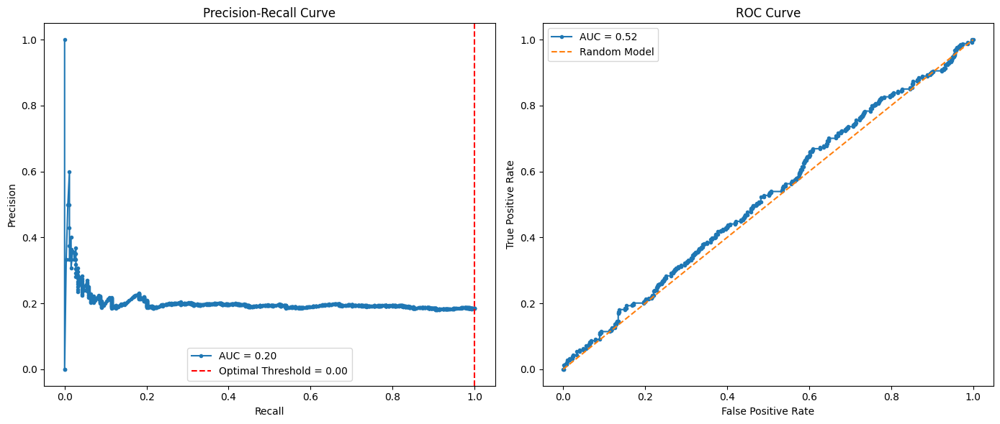

In [ ]:

y_prob = best_model.predict_proba(X_test_scaled)[:, 1]

thresholds = np.arange(0.0, 1.1, 0.1)

f1_scores = []

for threshold in thresholds:
    y_pred_threshold = (y_prob >= threshold).astype(int)
    f1_scores.append(f1_score(y_test, y_pred_threshold))

optimal_threshold = thresholds[np.argmax(f1_scores)]
optimal_f1 = np.max(f1_scores)

print(f"Optimal Threshold (based on F1-score): {optimal_threshold}")
print(f"F1-score at optimal threshold: {optimal_f1}")

fpr, tpr, thresholds_roc = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

precision, recall, thresholds_pr = precision_recall_curve(y_test, y_prob)

plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
plt.plot(recall, precision, marker='.', label=f'AUC = {auc(recall, precision):.2f}')
plt.title('Precision-Recall Curve')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.axvline(x=recall[np.argmax(f1_scores)], color='r', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.2f}')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(fpr, tpr, marker='.', label=f'AUC = {roc_auc:.2f}')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random Model')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()

plt.tight_layout()
plt.show()


In [ ]:
# AUC-ROC sligtly bigger and f1-score in accuracy worse, but in macro avg better

/usr/local/lib/python3.10/dist-packages/sklearn/neighbors/_classification.py:238: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.10/dist-packages/sklearn/neighbors/_classification.py:238: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.10/dist-packages/sklearn/neighbors/_classification.py:238: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/usr/local/lib/python3.10/dist-packages/sklearn/neighbors/_classification.py:238: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for 

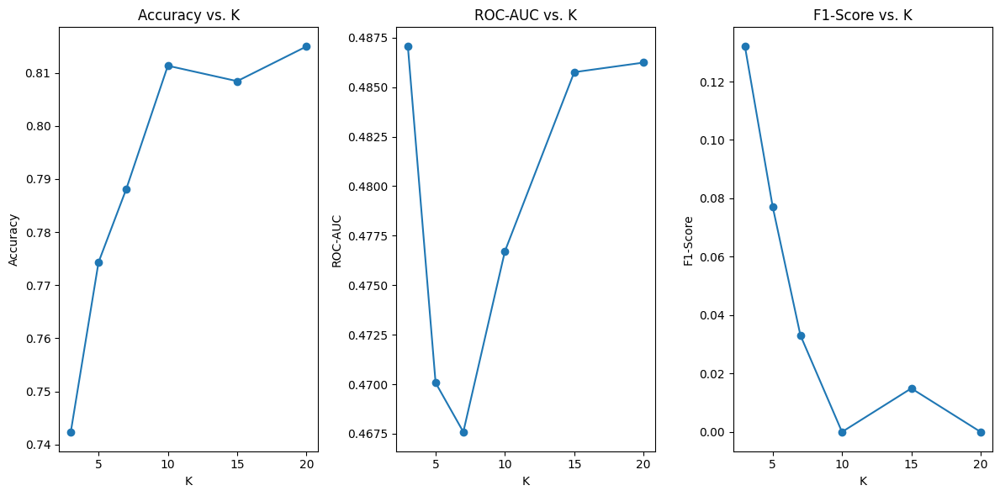

In [ ]:
k_values = [3, 5, 7, 10, 15, 20]

accuracy_scores = []
roc_auc_scores = []
f1_scores = []

for k in k_values:
    knn = KNeighborsClassifier(n_neighbors=k)
    knn.fit(X_train_scaled, y_train)
    y_pred = knn.predict(X_test_scaled)
    y_prob = knn.predict_proba(X_test_scaled)[:, 1]

    accuracy_scores.append(accuracy_score(y_test, y_pred))
    roc_auc_scores.append(roc_auc_score(y_test, y_prob))
    f1_scores.append(f1_score(y_test, y_pred))

plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.plot(k_values, accuracy_scores, marker='o')
plt.title('Accuracy vs. K')
plt.xlabel('K')
plt.ylabel('Accuracy')

plt.subplot(1, 3, 2)
plt.plot(k_values, roc_auc_scores, marker='o')
plt.title('ROC-AUC vs. K')
plt.xlabel('K')
plt.ylabel('ROC-AUC')

plt.subplot(1, 3, 3)
plt.plot(k_values, f1_scores, marker='o')
plt.title('F1-Score vs. K')
plt.xlabel('K')
plt.ylabel('F1-Score')

plt.tight_layout()
plt.show()


In [ ]:
# As we can see Accuracy the more K-neighbors the better it is. ROC-AUC almost same situation but on first few k-neighbors little worse.
# F1-Score the more K-neighbors the worse it is.

In [ ]:
# Naive Bayes

In [ ]:

gnb = GaussianNB()

y_pred, y_test,X_test_scaled,X_train = train_and_evaluate_model(train,gnb,preprocessed_target)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [ ]:
roc_auc = roc_auc_score(y_test, y_pred)
print(f"AUC-ROC Score: {roc_auc:.2f}")
print(f"Accuracy: {accuracy * 100:.2f}%")
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))
print("Classification Report:")
print(classification_report(y_test, y_pred))


AUC-ROC Score: 0.50
Accuracy: 81.57%
Confusion Matrix:
[[729 395]
 [163  91]]
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.65      0.72      1124
           1       0.19      0.36      0.25       254

    accuracy                           0.60      1378
   macro avg       0.50      0.50      0.48      1378
weighted avg       0.70      0.60      0.64      1378



In [ ]:
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],  # Regularization strength
    'penalty': ['l2'],  # Regularization type (l1 and elasticnet are not available for all solvers)
    'solver': ['liblinear', 'saga'],  # Solvers to use
}

gs = GridSearchCV(estimator=log_reg, param_grid=param_grid,
                           scoring='accuracy', cv=5, n_jobs=-1, verbose=1)
gs.fit(X_train_scaled, y_train)


Fitting 5 folds for each of 10 candidates, totalling 50 fits


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


GridSearchCV(cv=5, estimator=LogisticRegression(random_state=42), n_jobs=-1,
             param_grid={'C': [0.01, 0.1, 1, 10, 100], 'penalty': ['l2'],
                         'solver': ['liblinear', 'saga']},
             scoring='accuracy', verbose=1)

In [ ]:
best_model = gs.best_estimator_

y_pred = best_model.predict(X_test_scaled)
roc_auc = roc_auc_score(y_test, y_pred)
print(f"AUC-ROC Score: {roc_auc:.2f}")
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy * 100:.2f}%")
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))
print("Classification Report:")
print(classification_report(y_test, y_pred))


AUC-ROC Score: 0.50
Accuracy: 81.57%
Confusion Matrix:
[[1124    0]
 [ 254    0]]
Classification Report:
              precision    recall  f1-score   support

           0       0.82      1.00      0.90      1124
           1       0.00      0.00      0.00       254

    accuracy                           0.82      1378
   macro avg       0.41      0.50      0.45      1378
weighted avg       0.67      0.82      0.73      1378



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
# AUC-ROC without changes.But f1-score much better accuracy and worse weighted avg

Optimal Threshold (based on F1-score): 0.0
F1-score at optimal threshold: 0.3112745098039216


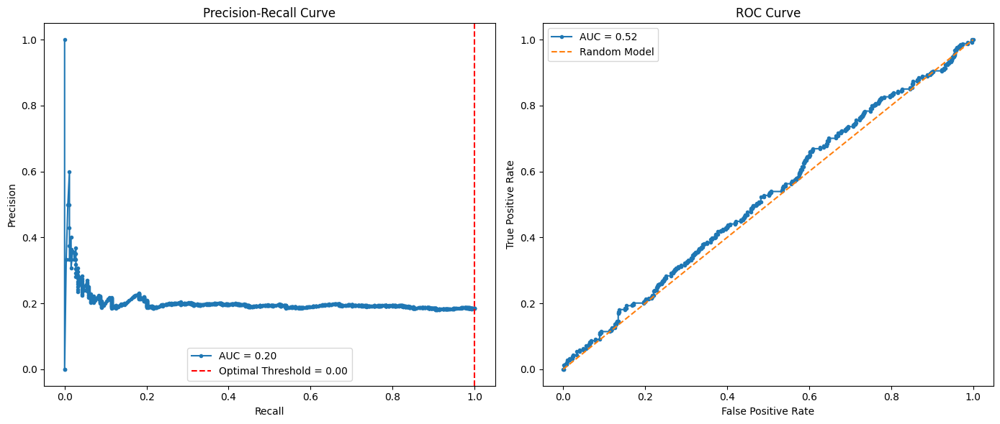

In [ ]:

y_prob = best_model.predict_proba(X_test_scaled)[:, 1]

thresholds = np.arange(0.0, 1.1, 0.1)

f1_scores = []

for threshold in thresholds:
    y_pred_threshold = (y_prob >= threshold).astype(int)
    f1_scores.append(f1_score(y_test, y_pred_threshold))

optimal_threshold = thresholds[np.argmax(f1_scores)]
optimal_f1 = np.max(f1_scores)

print(f"Optimal Threshold (based on F1-score): {optimal_threshold}")
print(f"F1-score at optimal threshold: {optimal_f1}")

fpr, tpr, thresholds_roc = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

precision, recall, thresholds_pr = precision_recall_curve(y_test, y_prob)

plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
plt.plot(recall, precision, marker='.', label=f'AUC = {auc(recall, precision):.2f}')
plt.title('Precision-Recall Curve')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.axvline(x=recall[np.argmax(f1_scores)], color='r', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.2f}')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(fpr, tpr, marker='.', label=f'AUC = {roc_auc:.2f}')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random Model')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()

plt.tight_layout()
plt.show()


In [ ]:
# SVM

In [ ]:
svm = SVC(kernel='linear', random_state=42)

y_pred, y_test,X_test_scaled,X_train = train_and_evaluate_model(train,svm,preprocessed_target)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [ ]:
roc_auc = roc_auc_score(y_test, y_pred)
print(f"AUC-ROC Score: {roc_auc:.2f}")
print(f"Accuracy: {accuracy * 100:.2f}%")
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))
print("Classification Report:")
print(classification_report(y_test, y_pred))


AUC-ROC Score: 0.51
Accuracy: 81.57%
Confusion Matrix:
[[1002  122]
 [ 220   34]]
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.89      0.85      1124
           1       0.22      0.13      0.17       254

    accuracy                           0.75      1378
   macro avg       0.52      0.51      0.51      1378
weighted avg       0.71      0.75      0.73      1378



In [ ]:
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'penalty': ['l2'],
    'solver': ['liblinear', 'saga'],
}

gs = GridSearchCV(estimator=log_reg, param_grid=param_grid,
                           scoring='accuracy', cv=5, n_jobs=-1, verbose=1)
gs.fit(X_train_scaled, y_train)


Fitting 5 folds for each of 10 candidates, totalling 50 fits


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


GridSearchCV(cv=5, estimator=LogisticRegression(random_state=42), n_jobs=-1,
             param_grid={'C': [0.01, 0.1, 1, 10, 100], 'penalty': ['l2'],
                         'solver': ['liblinear', 'saga']},
             scoring='accuracy', verbose=1)

In [ ]:
best_model = gs.best_estimator_

y_pred = best_model.predict(X_test_scaled)
roc_auc = roc_auc_score(y_test, y_pred)
print(f"AUC-ROC Score: {roc_auc:.2f}")
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy * 100:.2f}%")
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))
print("Classification Report:")
print(classification_report(y_test, y_pred))


AUC-ROC Score: 0.50
Accuracy: 81.57%
Confusion Matrix:
[[1124    0]
 [ 254    0]]
Classification Report:
              precision    recall  f1-score   support

           0       0.82      1.00      0.90      1124
           1       0.00      0.00      0.00       254

    accuracy                           0.82      1378
   macro avg       0.41      0.50      0.45      1378
weighted avg       0.67      0.82      0.73      1378



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
# AUC-ROC is slightly worse. F1-score accuracy better.

Optimal Threshold (based on F1-score): 0.0
F1-score at optimal threshold: 0.3112745098039216


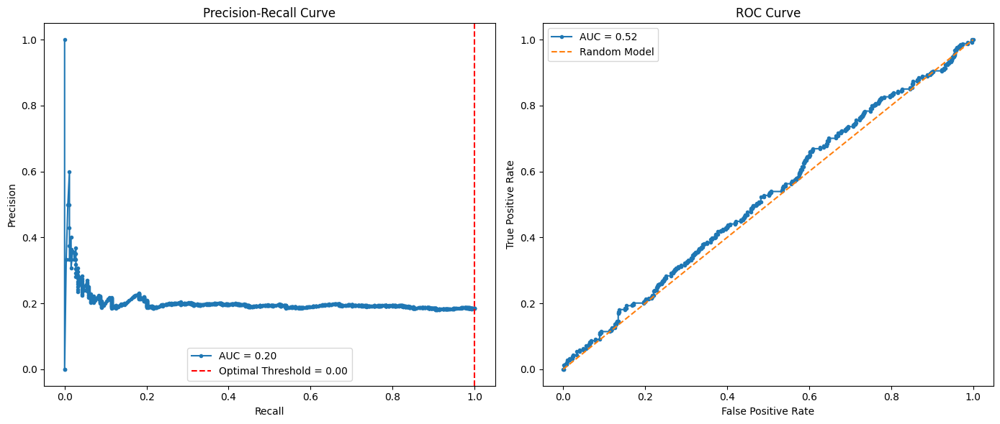

In [ ]:

y_prob = best_model.predict_proba(X_test_scaled)[:, 1]

thresholds = np.arange(0.0, 1.1, 0.1)

f1_scores = []

for threshold in thresholds:
    y_pred_threshold = (y_prob >= threshold).astype(int)
    f1_scores.append(f1_score(y_test, y_pred_threshold))

optimal_threshold = thresholds[np.argmax(f1_scores)]
optimal_f1 = np.max(f1_scores)

print(f"Optimal Threshold (based on F1-score): {optimal_threshold}")
print(f"F1-score at optimal threshold: {optimal_f1}")

fpr, tpr, thresholds_roc = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

precision, recall, thresholds_pr = precision_recall_curve(y_test, y_prob)

plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
plt.plot(recall, precision, marker='.', label=f'AUC = {auc(recall, precision):.2f}')
plt.title('Precision-Recall Curve')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.axvline(x=recall[np.argmax(f1_scores)], color='r', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.2f}')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(fpr, tpr, marker='.', label=f'AUC = {roc_auc:.2f}')
plt.plot([0, 1], [0, 1], linestyle='--', label='Random Model')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()

plt.tight_layout()
plt.show()


In [ ]:
# Handling unbalanced Data

In [ ]:
# For this i choose SVM

In [ ]:

train = train[: len(preprocessed_target)]

preprocessed_target = pd.DataFrame(preprocessed_target, columns=['RainTomorrow'])
train_X, train_y = train.drop('RainTomorrow', axis = 1),preprocessed_target

X_train, X_test, y_train, y_test = train_test_split(train_X, train_y, test_size=0.2, random_state=42)

scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

under_sampler = RandomUnderSampler(random_state=42)
X_train_under, y_train_under = under_sampler.fit_resample(X_train_scaled, y_train)

smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train_scaled, y_train)

svm_under = SVC(kernel='linear', random_state=42)
svm_under.fit(X_train_under, y_train_under)
y_pred_under = svm_under.predict(X_test_scaled)
accuracy_under = accuracy_score(y_test, y_pred_under)
print("Accuracy with Under-sampling:", accuracy_under)
print(classification_report(y_test, y_pred_under))

svm_smote = SVC(kernel='linear', random_state=42)
svm_smote.fit(X_train_smote, y_train_smote)
y_pred_smote = svm_smote.predict(X_test_scaled)
accuracy_smote = accuracy_score(y_test, y_pred_smote)
print("Accuracy with SMOTE Over-sampling:", accuracy_smote)
print(classification_report(y_test, y_pred_smote))


/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Accuracy with Under-sampling: 0.488388969521045
              precision    recall  f1-score   support

           0       0.80      0.49      0.61      1124
           1       0.17      0.47      0.25       254

    accuracy                           0.49      1378
   macro avg       0.49      0.48      0.43      1378
weighted avg       0.69      0.49      0.54      1378



/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Accuracy with SMOTE Over-sampling: 0.6915820029027576
              precision    recall  f1-score   support

           0       0.82      0.80      0.81      1124
           1       0.20      0.23      0.21       254

    accuracy                           0.69      1378
   macro avg       0.51      0.51      0.51      1378
weighted avg       0.71      0.69      0.70      1378



In [ ]:
#Under-sampling reduces the size of the majority class to balance the dataset,
# but as a result, the model loses valuable data from the majority class.
#This may cause the model to be biased toward the minority class, which explains the poor precision for Class 1.
#The overall performance is limited by the loss of data, especially for the majority class (Class 0), leading to the lower recall and accuracy.


#SMOTE over-sampling improves the recall and precision for Class 0, but the performance for Class 1 (the minority class) remains weak.
#Despite these issues, SMOTE results in a better overall accuracy, as it prevents the model from being overly biased toward the majority class.

#Conclusion:

#While under-sampling does reduce the impact of the majority class,
#it sacrifices valuable data from the majority class and leads to poor performance for the minority class.

#SMOTE over-sampling increases the accuracy by balancing the class distribution,
#which results in higher recall for Class 0 and a modest increase in recall for Class 1.
#However, the precision and recall for Class 1 remain low, indicating that SMOTE doesn't fully solve the imbalance problem,
#and the model is still not very good at identifying the minority class correctly.


In [ ]:
train = train[:len(preprocessed_target)]

preprocessed_target = pd.DataFrame(preprocessed_target, columns=['RainTomorrow'])
train_X, train_y = train.drop('RainTomorrow', axis=1), preprocessed_target['RainTomorrow']

X_train, X_test, y_train, y_test = train_test_split(train_X, train_y, test_size=0.2, random_state=42)

scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

svm_weighted = SVC(kernel='linear', class_weight='balanced', random_state=42)

accuracies = []

for train_idx, test_idx in stratified_kfold.split(X_train_scaled, y_train):
    X_train_fold, X_test_fold = X_train_scaled[train_idx], X_train_scaled[test_idx]
    y_train_fold, y_test_fold = y_train.iloc[train_idx], y_train.iloc[test_idx]

    svm_weighted.fit(X_train_fold, y_train_fold)

    y_pred_fold = svm_weighted.predict(X_test_fold)

    accuracy = accuracy_score(y_test_fold, y_pred_fold)
    accuracies.append(accuracy)

    print(f"Classification Report for Fold:\n{classification_report(y_test_fold, y_pred_fold)}")

print(f"Average Accuracy with Weighted SVM: {np.mean(accuracies):.2f}")


Classification Report for Fold:
              precision    recall  f1-score   support

           0       0.80      0.85      0.83       885
           1       0.20      0.16      0.18       217

    accuracy                           0.71      1102
   macro avg       0.50      0.50      0.50      1102
weighted avg       0.69      0.71      0.70      1102

Classification Report for Fold:
              precision    recall  f1-score   support

           0       0.80      0.82      0.81       885
           1       0.18      0.16      0.17       217

    accuracy                           0.69      1102
   macro avg       0.49      0.49      0.49      1102
weighted avg       0.68      0.69      0.69      1102

Classification Report for Fold:
              precision    recall  f1-score   support

           0       0.80      0.82      0.81       886
           1       0.16      0.15      0.16       216

    accuracy                           0.69      1102
   macro avg       0.48      0.4

In [ ]:
#Accuracy: From five folds of cross-validation, the average accuracy obtained is over 70 percent which shows that the model
# is successful in reasonably classifying the data, although there is still some scope for improvement.

#Class Imbalance: Cumulatively, the results show that the model performs reasonably good in predicting the majority class (class 0)
# with P and R scores around 0.80 in each fold.

#On the other hand, this model has problems with classifying minority class (class 1) with quite lower P and R scores around 0.18-0.20.

#This is quite expected, given the extreme imbalance in classes that is dominant within the data.

#Precision-Recall Trade-off: The precision and recall for minority class do not dramatically alter however it is common for class imbalance datasets that the minority class’s precision and recall are low.

#The macro average precisions, recall and f1-scores have balanced around 0.49-0.50 .

#this indicates, although the model’s ability still very favour to the majority class, the performance are fair on both classes.

#Weighted SVM Impact: The model is trained to focus more on the minority class with the class_weight = ‘balanced’. As a result, the unbalance problem can be lessen.

#Although, this only improves the prediction for the minority class only quite a limited extent,

#as the model still fails to effectively classify the minority class.

In [ ]:
# Comprehensive Model Evaluation:

Classification Report for Logistic Regression:
              precision    recall  f1-score   support

           0       0.82      1.00      0.90      1124
           1       0.00      0.00      0.00       254

    accuracy                           0.81      1378
   macro avg       0.41      0.50      0.45      1378
weighted avg       0.67      0.81      0.73      1378

AUC-ROC for Logistic Regression: 0.53
Classification Report for SVM:
              precision    recall  f1-score   support

           0       0.82      0.80      0.81      1124
           1       0.20      0.23      0.21       254

    accuracy                           0.69      1378
   macro avg       0.51      0.51      0.51      1378
weighted avg       0.71      0.69      0.70      1378

AUC-ROC for SVM: 0.52
Classification Report for KNN:
              precision    recall  f1-score   support

           0       0.81      0.94      0.87      1124
           1       0.16      0.05      0.08       254

    accuracy 

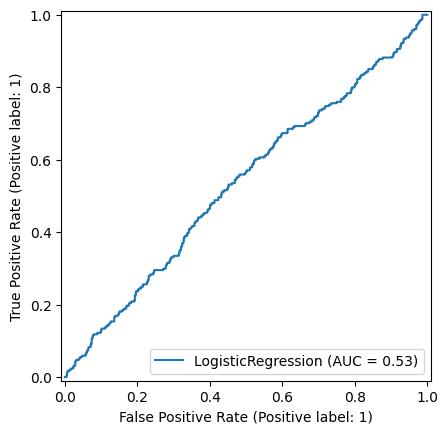

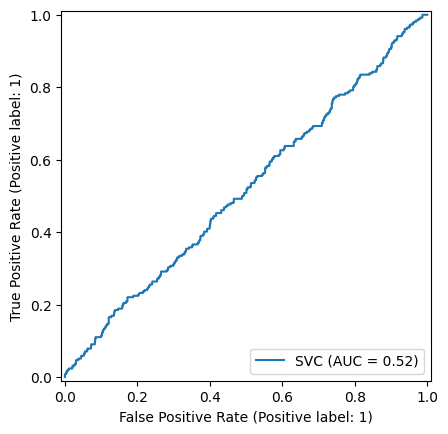

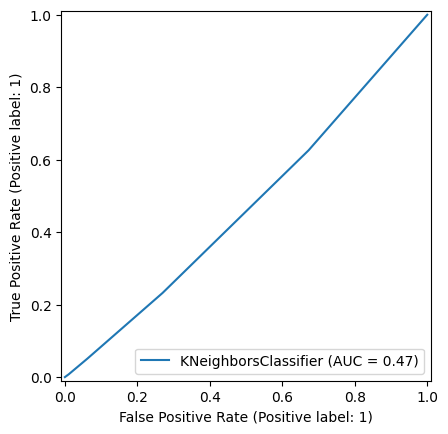

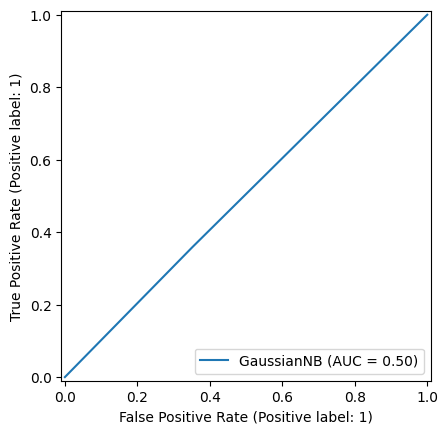

In [ ]:
train = train[:len(preprocessed_target)]

preprocessed_target = pd.DataFrame(preprocessed_target, columns=['RainTomorrow'])
train_X, train_y = train.drop('RainTomorrow', axis=1), preprocessed_target['RainTomorrow']

X_train, X_test, y_train, y_test = train_test_split(train_X, train_y, test_size=0.2, random_state=42)

scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)

models = {
    "Logistic Regression": LogisticRegression(),
    "SVM": SVC(kernel='linear', class_weight='balanced', random_state=42),
    "KNN": KNeighborsClassifier(),
    "Naive Bayes": GaussianNB()
}

for name, model in models.items():
    if name == "SVM (Weighted)":
        model.fit(X_train_resampled, y_train_resampled)
    else:
        model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    print(f"Classification Report for {name}:")
    print(classification_report(y_test, y_pred))

    y_prob = model.predict_proba(X_test_scaled)[:, 1] if hasattr(model, "predict_proba") else model.decision_function(X_test_scaled)
    auc_score = roc_auc_score(y_test, y_prob)
    print(f"AUC-ROC for {name}: {auc_score:.2f}")

    RocCurveDisplay.from_estimator(model, X_test_scaled, y_test)

plt.show()


Classification Report for SVM (Base):
              precision    recall  f1-score   support

           0       0.82      0.89      0.85      1124
           1       0.22      0.13      0.17       254

    accuracy                           0.75      1378
   macro avg       0.52      0.51      0.51      1378
weighted avg       0.71      0.75      0.73      1378

AUC-ROC for SVM (Base): 0.54
Classification Report for SVM (Weighted):
              precision    recall  f1-score   support

           0       0.82      0.80      0.81      1124
           1       0.20      0.23      0.21       254

    accuracy                           0.69      1378
   macro avg       0.51      0.51      0.51      1378
weighted avg       0.71      0.69      0.70      1378

AUC-ROC for SVM (Weighted): 0.52
Classification Report for KNN (Base):
              precision    recall  f1-score   support

           0       0.81      0.94      0.87      1124
           1       0.16      0.05      0.08       254

  

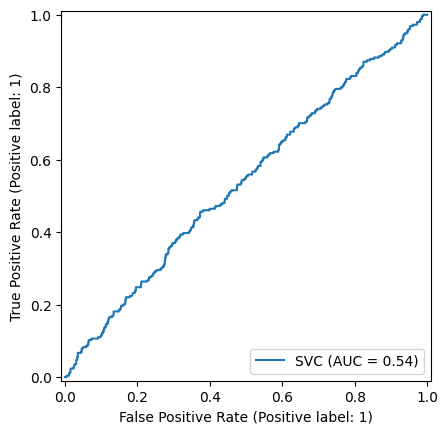

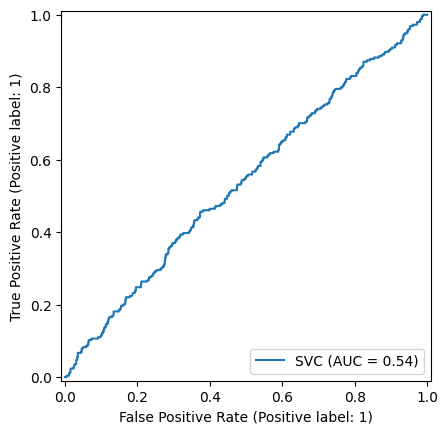

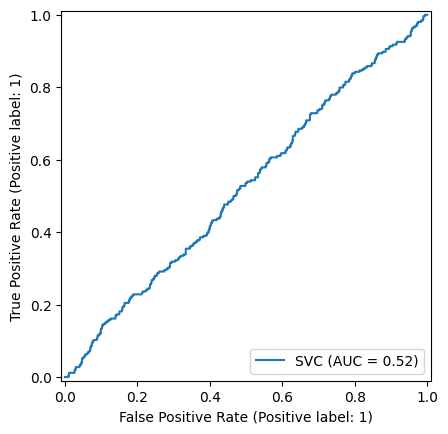

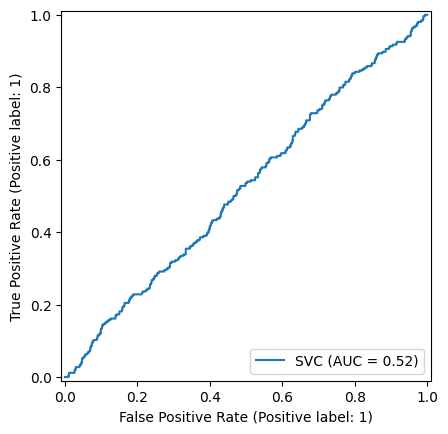

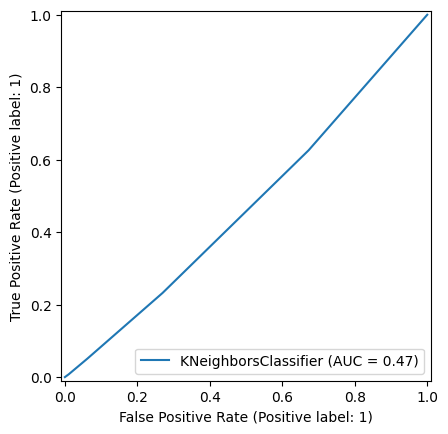

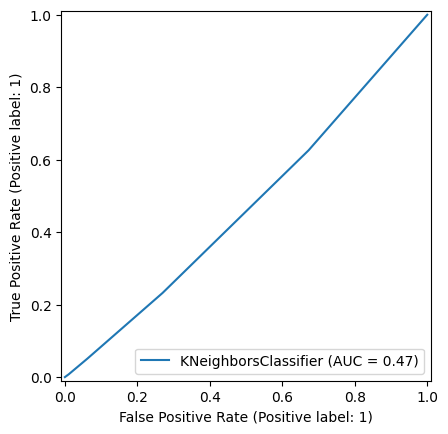

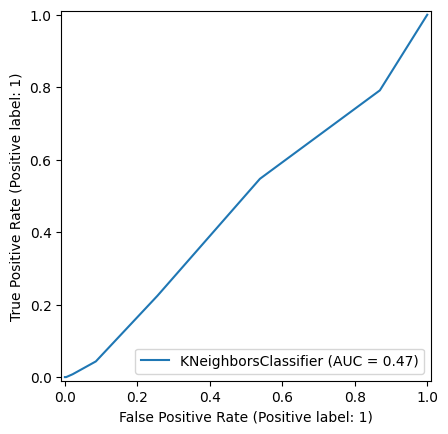

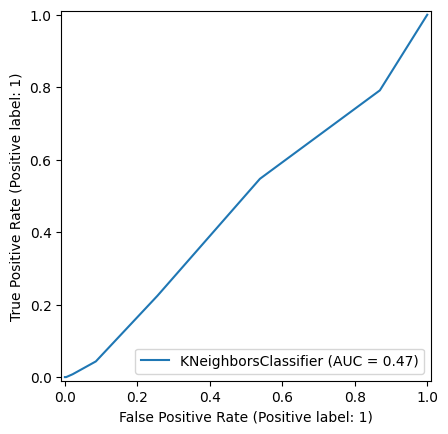

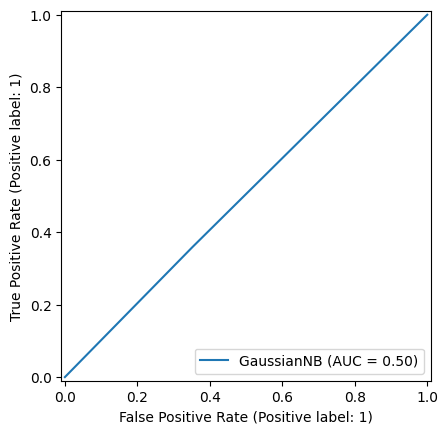

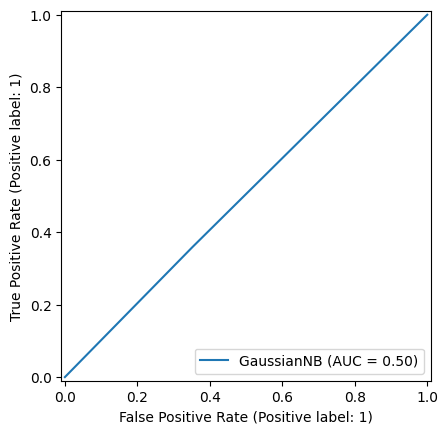

In [ ]:

smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_scaled, y_train)

svm_weighted = SVC(kernel='linear', class_weight='balanced', random_state=42)

param_grid = {'n_neighbors': [3, 5, 7, 9]}
grid_search_knn = GridSearchCV(KNeighborsClassifier(), param_grid, cv=5)
grid_search_knn.fit(X_train_scaled, y_train)

models = {
    "SVM (Base)": SVC(kernel='linear', random_state=42),
    "SVM (Weighted)": svm_weighted,
    "KNN (Base)": KNeighborsClassifier(),
    "KNN (Tuned)": grid_search_knn.best_estimator_,
    "Naive Bayes": GaussianNB()
}


for name, model in models.items():
    if name == "SVM (Weighted)":
        model.fit(X_train_resampled, y_train_resampled)
    else:
        model.fit(X_train_scaled, y_train)

    y_pred = model.predict(X_test_scaled)

    print(f"Classification Report for {name}:")
    print(classification_report(y_test, y_pred))

    y_prob = model.predict_proba(X_test_scaled)[:, 1] if hasattr(model, "predict_proba") else model.decision_function(X_test_scaled)
    auc_score = roc_auc_score(y_test, y_prob)
    print(f"AUC-ROC for {name}: {auc_score:.2f}")

    display = RocCurveDisplay.from_estimator(model, X_test_scaled, y_test)
    display.plot()

plt.show()


In [ ]:
# I know that part for Hyperparameters tuning for each Model
#could be 1 function but just in my case fitting takes 15 minutes so i just leave it like that,
#to not exted too more time.
